In [16]:
import pandas as pd 
df = pd.read_csv('/media/tohn/HDD/Dataset_USAI10K/metadata/USAI_Doctor-all_2013-2023_dummy_update.csv', dtype=str)
df = df.drop(columns=['Unnamed: 0','Unnamed: 0.2','Unnamed: 0.1','Unnamed: 0.1.1'])
path = list(df['img_path'])      
print(df.shape)
df.head(3)

(228177, 34)


,originalImage,LiverMass,LiverECHO,BileDuct,Followup,hcode,pid,exam_date,img_name,img_path,...,LiverECHO_Moderate fatty liver,LiverECHO_Cirrhosis,LiverECHO_Mild fatty liver,LiverECHO_Normal,LiverECHO_PDF 2,Num_img,CASE_code,Folder,LiverECHO_PDF,LiverECHO_FattyLiver
0,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_0.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No
1,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_1.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No
2,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_2.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No


In [17]:
df.shape

(228177, 34)

# Crop_UI_Predict with Doll and US Iteration7

In [18]:
from azure.cognitiveservices.vision.customvision.prediction import CustomVisionPredictionClient
import os
import pandas as pd
from sklearn.metrics import confusion_matrix
from matplotlib import pyplot as plt
import numpy
from msrest.authentication import ApiKeyCredentials
import cv2

In [19]:
project_id_class = '078885e0-7037-4038-8d2e-7916abeff39b'
prediction_key = 'b5427b2f991840d7aca82b9843a5f43a'

ENDPOINT = 'https://southeastasia.api.cognitive.microsoft.com/'
credentials = ApiKeyCredentials(in_headers={"Prediction-key": prediction_key})
predictor = CustomVisionPredictionClient(endpoint=ENDPOINT, credentials=credentials)

detection_key = 'b5427b2f991840d7aca82b9843a5f43a'
project_id_detection = '6bbb8a36-3679-4c50-a193-3c1f692eeb50'
# detector = CustomVisionPredictionClient(detection_key, endpoint=ENDPOINT)
credentials = ApiKeyCredentials(in_headers={"Prediction-key": detection_key})
detector = CustomVisionPredictionClient(ENDPOINT, credentials)

In [20]:
pred = list()
act = list()
doll_preds = list()
problems = list()
corrects = list()

In [31]:
path = list(df['img_path'])

path_news = []
filen_ = []
filen_Bad_Image = []

for i in range(len(path)):
    path_ = path[i].split('/media')
    path_news.append('/media/tohn'+path_[1])
    
df['img_path29'] = path_news

In [32]:
path = list(df['img_path29'])

In [33]:
# keep new path

path_news = []
filen_ = []
filen_Bad_Image = []

for i in range(len(path)):
    path_ = path[i].split('/USAI_')[0]
    
    # 
    Opath = os.path.join(path_) #path ใช้ได้
    Spath = os.path.join('/media/tohn/HDD/Dataset_USAI10K_Cropped/')
    
    if not os.path.exists(Spath):
        os.mkdir(Spath)

    allfiles = os.listdir(Opath)
    
    # Loop for detect box --- *
    
    filen = path[i].split('/')[-1]
    
    top_prob = list()
    top_pred = list()
        
    print(f'cropped img done --> {filen}/{i}')    
#     path_new = '/media/tohn/HDD/Dataset_USAI10K_Cropped/' + filen
#     path_news.append(path_new)
     # Detect fan
    try:    
        if not os.path.exists(os.path.join(Spath,filen)):
            path_news.append('None')
        else: 
            path_new = '/media/tohn/HDD/Dataset_USAI10K_Cropped/' + filen
            path_news.append(path_new) 
    except:
        path_news.append('None') 

cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_0.jpg/0
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_1.jpg/1
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_2.jpg/2
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_3.jpg/3
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_4.jpg/4
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_5.jpg/5
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_6.jpg/6
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_7.jpg/7
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_8.jpg/8
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_9.jpg/9
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_10.jpg/10
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_0.jpg/11
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_1.jpg/12
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_2.jpg/13
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_3.jpg/14
cropped img done --

cropped img done --> USAI_d2014-02-21_u012_p00144-h10999_9.jpg/1311
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_0.jpg/1312
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_1.jpg/1313
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_2.jpg/1314
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_3.jpg/1315
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_4.jpg/1316
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_5.jpg/1317
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_6.jpg/1318
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_7.jpg/1319
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_8.jpg/1320
cropped img done --> USAI_d2014-02-21_u012_p00145-h10999_9.jpg/1321
cropped img done --> USAI_d2014-02-21_u012_p00149-h10999_0.jpg/1322
cropped img done --> USAI_d2014-02-21_u012_p00149-h10999_1.jpg/1323
cropped img done --> USAI_d2014-02-21_u012_p00149-h10999_2.jpg/1324
cropped img done --> USAI_d2014-02-21_u012_p0014

cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_0.jpg/2577
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_1.jpg/2578
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_2.jpg/2579
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_3.jpg/2580
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_4.jpg/2581
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_5.jpg/2582
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_6.jpg/2583
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_7.jpg/2584
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_8.jpg/2585
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_9.jpg/2586
cropped img done --> USAI_d2015-01-23_u012_p00270-h11002_10.jpg/2587
cropped img done --> USAI_d2015-01-23_u012_p00273-h11002_0.jpg/2588
cropped img done --> USAI_d2015-01-23_u012_p00273-h11002_1.jpg/2589
cropped img done --> USAI_d2015-01-23_u012_p00273-h11002_2.jpg/2590
cropped img done --> USAI_d2015-01-23_u012_p002

cropped img done --> USAI_d2014-03-21_u012_p00511-h11010_2.jpg/4218
cropped img done --> USAI_d2014-03-21_u012_p00511-h11010_3.jpg/4219
cropped img done --> USAI_d2014-03-21_u012_p00511-h11010_4.jpg/4220
cropped img done --> USAI_d2014-03-21_u012_p00511-h11010_5.jpg/4221
cropped img done --> USAI_d2014-03-21_u012_p00511-h11010_6.jpg/4222
cropped img done --> USAI_d2014-03-21_u012_p00511-h11010_7.jpg/4223
cropped img done --> USAI_d2014-03-21_u012_p00511-h11010_8.jpg/4224
cropped img done --> USAI_d2014-03-21_u012_p00512-h11010_0.jpg/4225
cropped img done --> USAI_d2014-03-21_u012_p00512-h11010_1.jpg/4226
cropped img done --> USAI_d2014-03-21_u012_p00512-h11010_2.jpg/4227
cropped img done --> USAI_d2014-03-21_u012_p00512-h11010_3.jpg/4228
cropped img done --> USAI_d2014-03-21_u012_p00512-h11010_4.jpg/4229
cropped img done --> USAI_d2014-03-21_u012_p00512-h11010_5.jpg/4230
cropped img done --> USAI_d2014-03-21_u012_p00512-h11010_6.jpg/4231
cropped img done --> USAI_d2014-03-21_u012_p0051

cropped img done --> USAI_d2014-07-18_u012_p02809-h11023_4.jpg/5268
cropped img done --> USAI_d2014-07-18_u012_p02809-h11023_5.jpg/5269
cropped img done --> USAI_d2014-07-18_u012_p02809-h11023_6.jpg/5270
cropped img done --> USAI_d2014-07-18_u012_p02809-h11023_7.jpg/5271
cropped img done --> USAI_d2014-07-18_u012_p02809-h11023_8.jpg/5272
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_0.jpg/5273
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_1.jpg/5274
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_2.jpg/5275
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_3.jpg/5276
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_4.jpg/5277
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_5.jpg/5278
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_6.jpg/5279
cropped img done --> USAI_d2014-07-18_u012_p02811-h11023_7.jpg/5280
cropped img done --> USAI_d2014-07-18_u012_p02814-h11023_0.jpg/5281
cropped img done --> USAI_d2014-07-18_u012_p0281

cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_3.jpg/6581
cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_4.jpg/6582
cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_5.jpg/6583
cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_6.jpg/6584
cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_7.jpg/6585
cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_8.jpg/6586
cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_9.jpg/6587
cropped img done --> USAI_d2014-08-29_u012_p00374-h11025_10.jpg/6588
cropped img done --> USAI_d2014-08-29_u012_p00375-h11025_0.jpg/6589
cropped img done --> USAI_d2014-08-29_u012_p00375-h11025_1.jpg/6590
cropped img done --> USAI_d2014-08-29_u012_p00375-h11025_2.jpg/6591
cropped img done --> USAI_d2014-08-29_u012_p00375-h11025_3.jpg/6592
cropped img done --> USAI_d2014-08-29_u012_p00375-h11025_4.jpg/6593
cropped img done --> USAI_d2014-08-29_u012_p00375-h11025_5.jpg/6594
cropped img done --> USAI_d2014-08-29_u012_p003

cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_0.jpg/7628
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_1.jpg/7629
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_2.jpg/7630
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_3.jpg/7631
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_4.jpg/7632
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_5.jpg/7633
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_6.jpg/7634
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_7.jpg/7635
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_8.jpg/7636
cropped img done --> USAI_d2014-07-04_u012_p00178-h11052_9.jpg/7637
cropped img done --> USAI_d2014-07-04_u012_p00182-h11052_0.jpg/7638
cropped img done --> USAI_d2014-07-04_u012_p00182-h11052_1.jpg/7639
cropped img done --> USAI_d2014-07-04_u012_p00182-h11052_2.jpg/7640
cropped img done --> USAI_d2014-07-04_u012_p00182-h11052_3.jpg/7641
cropped img done --> USAI_d2014-07-04_u012_p0018

cropped img done --> USAI_d2014-04-25_u012_p00173-h11076_7.jpg/9462
cropped img done --> USAI_d2014-04-25_u012_p00173-h11076_8.jpg/9463
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_0.jpg/9464
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_1.jpg/9465
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_2.jpg/9466
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_3.jpg/9467
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_4.jpg/9468
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_5.jpg/9469
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_6.jpg/9470
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_7.jpg/9471
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_8.jpg/9472
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_9.jpg/9473
cropped img done --> USAI_d2014-04-25_u012_p00205-h11076_10.jpg/9474
cropped img done --> USAI_d2014-04-25_u012_p00207-h11076_0.jpg/9475
cropped img done --> USAI_d2014-04-25_u012_p002

cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_0.jpg/10932
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_1.jpg/10933
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_2.jpg/10934
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_3.jpg/10935
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_4.jpg/10936
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_5.jpg/10937
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_6.jpg/10938
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_7.jpg/10939
cropped img done --> USAI_d2014-04-04_u012_p00048-h11078_8.jpg/10940
cropped img done --> USAI_d2014-04-04_u012_p00050-h11078_0.jpg/10941
cropped img done --> USAI_d2014-04-04_u012_p00050-h11078_1.jpg/10942
cropped img done --> USAI_d2014-04-04_u012_p00050-h11078_2.jpg/10943
cropped img done --> USAI_d2014-04-04_u012_p00050-h11078_3.jpg/10944
cropped img done --> USAI_d2014-04-04_u012_p00050-h11078_4.jpg/10945
cropped img done --> USAI_d2014-04

cropped img done --> USAI_d2014-03-14_u012_p00151-h11110_9.jpg/12553
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_0.jpg/12554
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_1.jpg/12555
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_2.jpg/12556
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_3.jpg/12557
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_4.jpg/12558
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_5.jpg/12559
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_6.jpg/12560
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_7.jpg/12561
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_8.jpg/12562
cropped img done --> USAI_d2014-03-14_u012_p00156-h11110_9.jpg/12563
cropped img done --> USAI_d2014-03-14_u012_p00157-h11110_0.jpg/12564
cropped img done --> USAI_d2014-03-14_u012_p00157-h11110_1.jpg/12565
cropped img done --> USAI_d2014-03-14_u012_p00157-h11110_2.jpg/12566
cropped img done --> USAI_d2014-03

cropped img done --> USAI_d2014-04-18_u012_p00163-h11446_6.jpg/14541
cropped img done --> USAI_d2014-04-18_u012_p00163-h11446_7.jpg/14542
cropped img done --> USAI_d2014-04-18_u012_p00163-h11446_8.jpg/14543
cropped img done --> USAI_d2014-04-18_u012_p00163-h11446_9.jpg/14544
cropped img done --> USAI_d2014-04-18_u012_p00163-h11446_10.jpg/14545
cropped img done --> USAI_d2014-04-18_u012_p00163-h11446_11.jpg/14546
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_0.jpg/14547
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_1.jpg/14548
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_2.jpg/14549
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_3.jpg/14550
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_4.jpg/14551
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_5.jpg/14552
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_6.jpg/14553
cropped img done --> USAI_d2014-04-18_u012_p00164-h11446_7.jpg/14554
cropped img done --> USAI_d2014-

cropped img done --> USAI_d2015-01-16_u012_p00446-h12276_6.jpg/15867
cropped img done --> USAI_d2015-01-16_u012_p00446-h12276_7.jpg/15868
cropped img done --> USAI_d2015-01-16_u012_p00446-h12276_8.jpg/15869
cropped img done --> USAI_d2015-01-16_u012_p00446-h12276_9.jpg/15870
cropped img done --> USAI_d2015-01-16_u012_p00446-h12276_10.jpg/15871
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_0.jpg/15872
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_1.jpg/15873
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_2.jpg/15874
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_3.jpg/15875
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_4.jpg/15876
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_5.jpg/15877
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_6.jpg/15878
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_7.jpg/15879
cropped img done --> USAI_d2015-01-16_u012_p00450-h12276_8.jpg/15880
cropped img done --> USAI_d2015-0

cropped img done --> USAI_d2015-05-01_u012_p00159-h04264_6.jpg/18240
cropped img done --> USAI_d2015-05-01_u012_p00159-h04264_7.jpg/18241
cropped img done --> USAI_d2015-05-01_u012_p00159-h04264_8.jpg/18242
cropped img done --> USAI_d2015-05-01_u012_p00159-h04264_9.jpg/18243
cropped img done --> USAI_d2015-05-01_u012_p00159-h04264_10.jpg/18244
cropped img done --> USAI_d2015-05-01_u012_p00159-h04264_11.jpg/18245
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_0.jpg/18246
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_1.jpg/18247
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_2.jpg/18248
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_3.jpg/18249
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_4.jpg/18250
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_5.jpg/18251
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_6.jpg/18252
cropped img done --> USAI_d2015-05-01_u012_p00167-h04264_7.jpg/18253
cropped img done --> USAI_d2015-

cropped img done --> USAI_d2015-11-13_u012_p00676-h10670_2.jpg/19268
cropped img done --> USAI_d2015-11-13_u012_p00676-h10670_3.jpg/19269
cropped img done --> USAI_d2015-11-13_u012_p00676-h10670_4.jpg/19270
cropped img done --> USAI_d2015-11-13_u012_p00676-h10670_5.jpg/19271
cropped img done --> USAI_d2015-11-13_u012_p00676-h10670_6.jpg/19272
cropped img done --> USAI_d2015-11-13_u012_p00676-h10670_7.jpg/19273
cropped img done --> USAI_d2015-11-13_u012_p00676-h10670_8.jpg/19274
cropped img done --> USAI_d2015-11-13_u012_p00678-h10670_0.jpg/19275
cropped img done --> USAI_d2015-11-13_u012_p00678-h10670_1.jpg/19276
cropped img done --> USAI_d2015-11-13_u012_p00678-h10670_2.jpg/19277
cropped img done --> USAI_d2015-11-13_u012_p00678-h10670_3.jpg/19278
cropped img done --> USAI_d2015-11-13_u012_p00678-h10670_4.jpg/19279
cropped img done --> USAI_d2015-11-13_u012_p00678-h10670_5.jpg/19280
cropped img done --> USAI_d2015-11-13_u012_p00678-h10670_6.jpg/19281
cropped img done --> USAI_d2015-11

cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_0.jpg/21064
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_1.jpg/21065
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_2.jpg/21066
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_3.jpg/21067
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_4.jpg/21068
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_5.jpg/21069
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_6.jpg/21070
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_7.jpg/21071
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_8.jpg/21072
cropped img done --> USAI_d2015-08-14_u012_p00145-h10974_9.jpg/21073
cropped img done --> USAI_d2015-08-14_u012_p00147-h10974_0.jpg/21074
cropped img done --> USAI_d2015-08-14_u012_p00147-h10974_1.jpg/21075
cropped img done --> USAI_d2015-08-14_u012_p00147-h10974_2.jpg/21076
cropped img done --> USAI_d2015-08-14_u012_p00147-h10974_3.jpg/21077
cropped img done --> USAI_d2015-08

cropped img done --> USAI_d2015-06-12_u012_p00057-h10993_5.jpg/22715
cropped img done --> USAI_d2015-06-12_u012_p00057-h10993_6.jpg/22716
cropped img done --> USAI_d2015-06-12_u012_p00057-h10993_7.jpg/22717
cropped img done --> USAI_d2015-06-12_u012_p00057-h10993_8.jpg/22718
cropped img done --> USAI_d2015-06-12_u012_p00057-h10993_9.jpg/22719
cropped img done --> USAI_d2015-06-12_u012_p00057-h10993_10.jpg/22720
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_0.jpg/22721
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_1.jpg/22722
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_2.jpg/22723
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_3.jpg/22724
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_4.jpg/22725
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_5.jpg/22726
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_6.jpg/22727
cropped img done --> USAI_d2015-06-12_u012_p00058-h10993_7.jpg/22728
cropped img done --> USAI_d2015-0

cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_0.jpg/24880
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_1.jpg/24881
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_2.jpg/24882
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_3.jpg/24883
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_4.jpg/24884
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_5.jpg/24885
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_6.jpg/24886
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_7.jpg/24887
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_8.jpg/24888
cropped img done --> USAI_d2015-10-09_u012_p00157-h11042_9.jpg/24889
cropped img done --> USAI_d2015-10-09_u012_p00158-h11042_0.jpg/24890
cropped img done --> USAI_d2015-10-09_u012_p00158-h11042_1.jpg/24891
cropped img done --> USAI_d2015-10-09_u012_p00158-h11042_2.jpg/24892
cropped img done --> USAI_d2015-10-09_u012_p00158-h11042_3.jpg/24893
cropped img done --> USAI_d2015-10

cropped img done --> USAI_d2015-03-13_u012_p00342-h11055_3.jpg/27283
cropped img done --> USAI_d2015-03-13_u012_p00342-h11055_4.jpg/27284
cropped img done --> USAI_d2015-03-13_u012_p00342-h11055_5.jpg/27285
cropped img done --> USAI_d2015-03-13_u012_p00342-h11055_6.jpg/27286
cropped img done --> USAI_d2015-03-13_u012_p00342-h11055_7.jpg/27287
cropped img done --> USAI_d2015-03-13_u012_p00342-h11055_8.jpg/27288
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_0.jpg/27289
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_1.jpg/27290
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_2.jpg/27291
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_3.jpg/27292
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_4.jpg/27293
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_5.jpg/27294
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_6.jpg/27295
cropped img done --> USAI_d2015-03-13_u012_p00350-h11055_7.jpg/27296
cropped img done --> USAI_d2015-03

cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_0.jpg/28389
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_1.jpg/28390
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_2.jpg/28391
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_3.jpg/28392
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_4.jpg/28393
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_5.jpg/28394
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_6.jpg/28395
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_7.jpg/28396
cropped img done --> USAI_d2015-07-10_u012_p00223-h12414_8.jpg/28397
cropped img done --> USAI_d2015-07-10_u012_p00226-h12414_0.jpg/28398
cropped img done --> USAI_d2015-07-10_u012_p00226-h12414_1.jpg/28399
cropped img done --> USAI_d2015-07-10_u012_p00226-h12414_2.jpg/28400
cropped img done --> USAI_d2015-07-10_u012_p00226-h12414_3.jpg/28401
cropped img done --> USAI_d2015-07-10_u012_p00226-h12414_4.jpg/28402
cropped img done --> USAI_d2015-07

cropped img done --> USAI_d2016-02-12_u012_p00967-h10705_7.jpg/29258
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_0.jpg/29259
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_1.jpg/29260
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_2.jpg/29261
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_3.jpg/29262
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_4.jpg/29263
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_5.jpg/29264
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_6.jpg/29265
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_7.jpg/29266
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_8.jpg/29267
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_9.jpg/29268
cropped img done --> USAI_d2016-02-12_u012_p00971-h10705_0.jpg/29269
cropped img done --> USAI_d2016-02-12_u012_p00971-h10705_1.jpg/29270
cropped img done --> USAI_d2016-02-12_u012_p00971-h10705_2.jpg/29271
cropped img done --> USAI_d2016-02

cropped img done --> USAI_d2016-02-12_u012_p01388-h10705_4.jpg/30491
cropped img done --> USAI_d2016-02-12_u012_p01388-h10705_5.jpg/30492
cropped img done --> USAI_d2016-02-12_u012_p01388-h10705_6.jpg/30493
cropped img done --> USAI_d2016-02-12_u012_p01388-h10705_7.jpg/30494
cropped img done --> USAI_d2016-02-12_u012_p01388-h10705_8.jpg/30495
cropped img done --> USAI_d2016-02-12_u012_p01388-h10705_9.jpg/30496
cropped img done --> USAI_d2016-02-12_u012_p01388-h10705_10.jpg/30497
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_0.jpg/30498
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_1.jpg/30499
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_2.jpg/30500
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_3.jpg/30501
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_4.jpg/30502
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_5.jpg/30503
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_6.jpg/30504
cropped img done --> USAI_d2016-0

cropped img done --> USAI_d2017-12-26_u012_p00126-h04410_14.jpg/32914
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_0.jpg/32915
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_1.jpg/32916
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_2.jpg/32917
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_3.jpg/32918
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_4.jpg/32919
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_5.jpg/32920
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_6.jpg/32921
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_7.jpg/32922
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_8.jpg/32923
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_9.jpg/32924
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_10.jpg/32925
cropped img done --> USAI_d2017-12-26_u012_p00130-h04410_11.jpg/32926
cropped img done --> USAI_d2017-12-26_u012_p00132-h04410_0.jpg/32927
cropped img done --> USAI_d2017

cropped img done --> USAI_d2017-08-18_u012_p00514-h10973_11.jpg/35420
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_0.jpg/35421
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_1.jpg/35422
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_2.jpg/35423
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_3.jpg/35424
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_4.jpg/35425
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_5.jpg/35426
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_6.jpg/35427
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_7.jpg/35428
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_8.jpg/35429
cropped img done --> USAI_d2017-08-18_u012_p00516-h10973_9.jpg/35430
cropped img done --> USAI_d2017-08-18_u012_p00517-h10973_0.jpg/35431
cropped img done --> USAI_d2017-08-18_u012_p00517-h10973_1.jpg/35432
cropped img done --> USAI_d2017-08-18_u012_p00517-h10973_2.jpg/35433
cropped img done --> USAI_d2017-0

cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_0.jpg/36474
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_1.jpg/36475
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_2.jpg/36476
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_3.jpg/36477
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_4.jpg/36478
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_5.jpg/36479
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_6.jpg/36480
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_7.jpg/36481
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_8.jpg/36482
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_9.jpg/36483
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_10.jpg/36484
cropped img done --> USAI_d2017-08-18_u012_p00753-h10973_11.jpg/36485
cropped img done --> USAI_d2017-08-18_u012_p00754-h10973_0.jpg/36486
cropped img done --> USAI_d2017-08-18_u012_p00754-h10973_1.jpg/36487
cropped img done --> USAI_d2017-

cropped img done --> USAI_d2017-08-18_u012_p00884-h10973_11.jpg/37447
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_0.jpg/37448
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_1.jpg/37449
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_2.jpg/37450
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_3.jpg/37451
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_4.jpg/37452
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_5.jpg/37453
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_6.jpg/37454
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_7.jpg/37455
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_8.jpg/37456
cropped img done --> USAI_d2017-08-18_u012_p00885-h10973_9.jpg/37457
cropped img done --> USAI_d2017-08-18_u012_p00886-h10973_0.jpg/37458
cropped img done --> USAI_d2017-08-18_u012_p00886-h10973_1.jpg/37459
cropped img done --> USAI_d2017-08-18_u012_p00886-h10973_2.jpg/37460
cropped img done --> USAI_d2017-0

cropped img done --> USAI_d2017-07-21_u012_p00276-h11040_7.jpg/39415
cropped img done --> USAI_d2017-07-21_u012_p00276-h11040_8.jpg/39416
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_0.jpg/39417
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_1.jpg/39418
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_2.jpg/39419
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_3.jpg/39420
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_4.jpg/39421
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_5.jpg/39422
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_6.jpg/39423
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_7.jpg/39424
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_8.jpg/39425
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_9.jpg/39426
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_10.jpg/39427
cropped img done --> USAI_d2017-07-21_u012_p00278-h11040_11.jpg/39428
cropped img done --> USAI_d2017-

cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_5.jpg/41195
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_6.jpg/41196
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_7.jpg/41197
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_8.jpg/41198
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_9.jpg/41199
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_10.jpg/41200
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_11.jpg/41201
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_12.jpg/41202
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_13.jpg/41203
cropped img done --> USAI_d2018-01-12_u012_p07190-h11069_14.jpg/41204
cropped img done --> USAI_d2018-01-12_u012_p07196-h11069_0.jpg/41205
cropped img done --> USAI_d2018-01-12_u012_p07196-h11069_1.jpg/41206
cropped img done --> USAI_d2018-01-12_u012_p07196-h11069_2.jpg/41207
cropped img done --> USAI_d2018-01-12_u012_p07196-h11069_3.jpg/41208
cropped img done --> USAI_d20

cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_2.jpg/42459
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_3.jpg/42460
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_4.jpg/42461
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_5.jpg/42462
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_6.jpg/42463
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_7.jpg/42464
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_8.jpg/42465
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_9.jpg/42466
cropped img done --> USAI_d2017-12-22_u012_p00746-h11454_10.jpg/42467
cropped img done --> USAI_d2017-12-22_u012_p00747-h11454_0.jpg/42468
cropped img done --> USAI_d2017-12-22_u012_p00747-h11454_1.jpg/42469
cropped img done --> USAI_d2017-12-22_u012_p00747-h11454_2.jpg/42470
cropped img done --> USAI_d2017-12-22_u012_p00747-h11454_3.jpg/42471
cropped img done --> USAI_d2017-12-22_u012_p00747-h11454_4.jpg/42472
cropped img done --> USAI_d2017-1

cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_0.jpg/43582
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_1.jpg/43583
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_2.jpg/43584
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_3.jpg/43585
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_4.jpg/43586
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_5.jpg/43587
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_6.jpg/43588
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_7.jpg/43589
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_8.jpg/43590
cropped img done --> USAI_d2017-12-22_u012_p01169-h11454_9.jpg/43591
cropped img done --> USAI_d2017-12-22_u012_p01174-h11454_0.jpg/43592
cropped img done --> USAI_d2017-12-22_u012_p01174-h11454_1.jpg/43593
cropped img done --> USAI_d2017-12-22_u012_p01174-h11454_2.jpg/43594
cropped img done --> USAI_d2017-12-22_u012_p01174-h11454_3.jpg/43595
cropped img done --> USAI_d2017-12

cropped img done --> USAI_d2017-02-10_u012_p00826-h28811_9.jpg/45638
cropped img done --> USAI_d2017-02-10_u012_p00826-h28811_10.jpg/45639
cropped img done --> USAI_d2017-02-10_u012_p00826-h28811_11.jpg/45640
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_0.jpg/45641
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_1.jpg/45642
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_2.jpg/45643
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_3.jpg/45644
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_4.jpg/45645
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_5.jpg/45646
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_6.jpg/45647
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_7.jpg/45648
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_8.jpg/45649
cropped img done --> USAI_d2017-02-10_u012_p00827-h28811_9.jpg/45650
cropped img done --> USAI_d2017-02-10_u012_p00831-h28811_0.jpg/45651
cropped img done --> USAI_d2017-

cropped img done --> USAI_d2018-07-06_u012_p06661-h13777_7.jpg/46873
cropped img done --> USAI_d2018-07-06_u012_p06661-h13777_8.jpg/46874
cropped img done --> USAI_d2018-07-06_u012_p06661-h13777_9.jpg/46875
cropped img done --> USAI_d2018-07-06_u012_p06661-h13777_10.jpg/46876
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_0.jpg/46877
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_1.jpg/46878
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_2.jpg/46879
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_3.jpg/46880
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_4.jpg/46881
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_5.jpg/46882
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_6.jpg/46883
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_7.jpg/46884
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_8.jpg/46885
cropped img done --> USAI_d2018-07-06_u012_p06666-h13777_9.jpg/46886
cropped img done --> USAI_d2018-0

cropped img done --> USAI_d2019-02-05_u012_p07966-h13777_10.jpg/48260
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_0.jpg/48261
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_1.jpg/48262
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_2.jpg/48263
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_3.jpg/48264
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_4.jpg/48265
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_5.jpg/48266
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_6.jpg/48267
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_7.jpg/48268
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_8.jpg/48269
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_9.jpg/48270
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_10.jpg/48271
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_11.jpg/48272
cropped img done --> USAI_d2019-02-05_u012_p07969-h13777_12.jpg/48273
cropped img done --> USAI_d201

cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_4.jpg/49131
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_5.jpg/49132
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_6.jpg/49133
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_7.jpg/49134
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_8.jpg/49135
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_9.jpg/49136
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_10.jpg/49137
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_11.jpg/49138
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_12.jpg/49139
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_13.jpg/49140
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_14.jpg/49141
cropped img done --> USAI_d2019-04-10_u012_p01038-h11144_15.jpg/49142
cropped img done --> USAI_d2019-04-10_u012_p01042-h11144_0.jpg/49143
cropped img done --> USAI_d2019-04-10_u012_p01042-h11144_1.jpg/49144
cropped img done --> USAI_d2

cropped img done --> USAI_d2019-04-10_u012_p01294-h11144_10.jpg/50099
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_0.jpg/50100
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_1.jpg/50101
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_2.jpg/50102
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_3.jpg/50103
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_4.jpg/50104
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_5.jpg/50105
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_6.jpg/50106
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_7.jpg/50107
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_8.jpg/50108
cropped img done --> USAI_d2019-04-10_u012_p01306-h11144_9.jpg/50109
cropped img done --> USAI_d2019-04-10_u012_p01307-h11144_0.jpg/50110
cropped img done --> USAI_d2019-04-10_u012_p01307-h11144_1.jpg/50111
cropped img done --> USAI_d2019-04-10_u012_p01307-h11144_2.jpg/50112
cropped img done --> USAI_d2019-0

cropped img done --> USAI_d2015-03-13_u349_p00064-h11055_1.jpg/51706
cropped img done --> USAI_d2015-03-13_u349_p00064-h11055_2.jpg/51707
cropped img done --> USAI_d2015-03-13_u349_p00064-h11055_3.jpg/51708
cropped img done --> USAI_d2015-03-13_u349_p00064-h11055_4.jpg/51709
cropped img done --> USAI_d2015-03-13_u349_p00073-h11055_0.jpg/51710
cropped img done --> USAI_d2015-03-13_u349_p00073-h11055_1.jpg/51711
cropped img done --> USAI_d2015-03-13_u349_p00073-h11055_2.jpg/51712
cropped img done --> USAI_d2015-03-13_u349_p00073-h11055_3.jpg/51713
cropped img done --> USAI_d2015-03-13_u349_p00073-h11055_4.jpg/51714
cropped img done --> USAI_d2015-03-13_u349_p00073-h11055_5.jpg/51715
cropped img done --> USAI_d2015-03-13_u349_p00073-h11055_6.jpg/51716
cropped img done --> USAI_d2015-03-13_u349_p00074-h11055_0.jpg/51717
cropped img done --> USAI_d2015-03-13_u349_p00074-h11055_1.jpg/51718
cropped img done --> USAI_d2015-03-13_u349_p00074-h11055_2.jpg/51719
cropped img done --> USAI_d2015-03

cropped img done --> USAI_d2018-01-12_u349_p06979-h11069_12.jpg/54282
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_0.jpg/54283
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_1.jpg/54284
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_2.jpg/54285
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_3.jpg/54286
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_4.jpg/54287
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_5.jpg/54288
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_6.jpg/54289
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_7.jpg/54290
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_8.jpg/54291
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_9.jpg/54292
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_10.jpg/54293
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_11.jpg/54294
cropped img done --> USAI_d2018-01-12_u349_p06987-h11069_12.jpg/54295
cropped img done --> USAI_d201

cropped img done --> USAI_d2019-07-24_u349_p01621-h11075_8.jpg/56899
cropped img done --> USAI_d2019-07-24_u349_p01621-h11075_9.jpg/56900
cropped img done --> USAI_d2019-07-24_u349_p01621-h11075_10.jpg/56901
cropped img done --> USAI_d2019-07-24_u349_p01621-h11075_11.jpg/56902
cropped img done --> USAI_d2019-07-24_u349_p01621-h11075_12.jpg/56903
cropped img done --> USAI_d2019-07-24_u349_p01621-h11075_13.jpg/56904
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_0.jpg/56905
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_1.jpg/56906
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_2.jpg/56907
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_3.jpg/56908
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_4.jpg/56909
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_5.jpg/56910
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_6.jpg/56911
cropped img done --> USAI_d2019-07-24_u349_p01654-h11075_7.jpg/56912
cropped img done --> USAI_d201

cropped img done --> USAI_d2019-04-10_u349_p01087-h11144_3.jpg/58253
cropped img done --> USAI_d2019-04-10_u349_p01087-h11144_4.jpg/58254
cropped img done --> USAI_d2019-04-10_u349_p01087-h11144_5.jpg/58255
cropped img done --> USAI_d2019-04-10_u349_p01087-h11144_6.jpg/58256
cropped img done --> USAI_d2019-04-10_u349_p01087-h11144_7.jpg/58257
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_0.jpg/58258
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_1.jpg/58259
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_2.jpg/58260
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_3.jpg/58261
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_4.jpg/58262
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_5.jpg/58263
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_6.jpg/58264
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_7.jpg/58265
cropped img done --> USAI_d2019-04-10_u349_p01090-h11144_8.jpg/58266
cropped img done --> USAI_d2019-04

cropped img done --> USAI_d2015-01-16_u010_p00644-h12276_2.jpg/59761
cropped img done --> USAI_d2015-01-16_u010_p00644-h12276_3.jpg/59762
cropped img done --> USAI_d2015-01-16_u010_p00644-h12276_4.jpg/59763
cropped img done --> USAI_d2015-01-16_u010_p00644-h12276_5.jpg/59764
cropped img done --> USAI_d2015-01-16_u010_p00644-h12276_6.jpg/59765
cropped img done --> USAI_d2015-01-16_u010_p00645-h12276_0.jpg/59766
cropped img done --> USAI_d2015-01-16_u010_p00645-h12276_1.jpg/59767
cropped img done --> USAI_d2015-01-16_u010_p00645-h12276_2.jpg/59768
cropped img done --> USAI_d2015-01-16_u010_p00645-h12276_3.jpg/59769
cropped img done --> USAI_d2015-01-16_u010_p00645-h12276_4.jpg/59770
cropped img done --> USAI_d2015-01-16_u010_p00645-h12276_5.jpg/59771
cropped img done --> USAI_d2015-06-12_u010_p00056-h10993_0.jpg/59772
cropped img done --> USAI_d2015-06-12_u010_p00056-h10993_1.jpg/59773
cropped img done --> USAI_d2015-06-12_u010_p00056-h10993_2.jpg/59774
cropped img done --> USAI_d2015-06

cropped img done --> USAI_d2015-07-24_u010_p00456-h11041_4.jpg/61358
cropped img done --> USAI_d2015-07-24_u010_p00459-h11041_0.jpg/61359
cropped img done --> USAI_d2015-07-24_u010_p00459-h11041_1.jpg/61360
cropped img done --> USAI_d2015-07-24_u010_p00459-h11041_2.jpg/61361
cropped img done --> USAI_d2015-07-24_u010_p00462-h11041_0.jpg/61362
cropped img done --> USAI_d2015-07-24_u010_p00462-h11041_1.jpg/61363
cropped img done --> USAI_d2015-07-24_u010_p00462-h11041_2.jpg/61364
cropped img done --> USAI_d2015-07-24_u010_p00462-h11041_3.jpg/61365
cropped img done --> USAI_d2015-07-24_u010_p00463-h11041_0.jpg/61366
cropped img done --> USAI_d2015-07-24_u010_p00463-h11041_1.jpg/61367
cropped img done --> USAI_d2015-07-24_u010_p00463-h11041_2.jpg/61368
cropped img done --> USAI_d2015-07-24_u010_p00463-h11041_3.jpg/61369
cropped img done --> USAI_d2015-07-24_u010_p00463-h11041_4.jpg/61370
cropped img done --> USAI_d2015-07-24_u010_p00466-h11041_0.jpg/61371
cropped img done --> USAI_d2015-07

cropped img done --> USAI_d2016-08-05_u010_p00260-h10704_7.jpg/62854
cropped img done --> USAI_d2016-08-05_u010_p00260-h10704_8.jpg/62855
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_0.jpg/62856
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_1.jpg/62857
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_2.jpg/62858
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_3.jpg/62859
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_4.jpg/62860
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_5.jpg/62861
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_6.jpg/62862
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_7.jpg/62863
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_8.jpg/62864
cropped img done --> USAI_d2016-08-05_u010_p00262-h10704_9.jpg/62865
cropped img done --> USAI_d2016-08-05_u010_p00264-h10704_0.jpg/62866
cropped img done --> USAI_d2016-08-05_u010_p00264-h10704_1.jpg/62867
cropped img done --> USAI_d2016-08

cropped img done --> USAI_d2016-09-17_u010_p00445-h11022_4.jpg/65379
cropped img done --> USAI_d2016-09-17_u010_p00445-h11022_5.jpg/65380
cropped img done --> USAI_d2016-09-17_u010_p00445-h11022_6.jpg/65381
cropped img done --> USAI_d2016-09-17_u010_p00445-h11022_7.jpg/65382
cropped img done --> USAI_d2016-09-17_u010_p00446-h11022_0.jpg/65383
cropped img done --> USAI_d2016-09-17_u010_p00446-h11022_1.jpg/65384
cropped img done --> USAI_d2016-09-17_u010_p00446-h11022_2.jpg/65385
cropped img done --> USAI_d2016-09-17_u010_p00446-h11022_3.jpg/65386
cropped img done --> USAI_d2016-09-17_u010_p00446-h11022_4.jpg/65387
cropped img done --> USAI_d2016-09-17_u010_p00446-h11022_5.jpg/65388
cropped img done --> USAI_d2016-09-17_u010_p00447-h11022_0.jpg/65389
cropped img done --> USAI_d2016-09-17_u010_p00447-h11022_1.jpg/65390
cropped img done --> USAI_d2016-09-17_u010_p00447-h11022_2.jpg/65391
cropped img done --> USAI_d2016-09-17_u010_p00447-h11022_3.jpg/65392
cropped img done --> USAI_d2016-09

cropped img done --> USAI_d2016-06-17_u010_p00456-h11172_7.jpg/67749
cropped img done --> USAI_d2016-06-17_u010_p00456-h11172_8.jpg/67750
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_0.jpg/67751
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_1.jpg/67752
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_2.jpg/67753
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_3.jpg/67754
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_4.jpg/67755
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_5.jpg/67756
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_6.jpg/67757
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_7.jpg/67758
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_8.jpg/67759
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_9.jpg/67760
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_10.jpg/67761
cropped img done --> USAI_d2016-06-17_u010_p00462-h11172_11.jpg/67762
cropped img done --> USAI_d2016-

cropped img done --> USAI_d2016-06-17_u010_p00710-h11172_5.jpg/68660
cropped img done --> USAI_d2016-06-17_u010_p00710-h11172_6.jpg/68661
cropped img done --> USAI_d2016-06-17_u010_p00710-h11172_7.jpg/68662
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_0.jpg/68663
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_1.jpg/68664
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_2.jpg/68665
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_3.jpg/68666
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_4.jpg/68667
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_5.jpg/68668
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_6.jpg/68669
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_7.jpg/68670
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_8.jpg/68671
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_9.jpg/68672
cropped img done --> USAI_d2016-06-17_u010_p00711-h11172_10.jpg/68673
cropped img done --> USAI_d2016-0

cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_1.jpg/69865
cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_2.jpg/69866
cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_3.jpg/69867
cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_4.jpg/69868
cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_5.jpg/69869
cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_6.jpg/69870
cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_7.jpg/69871
cropped img done --> USAI_d2017-06-16_u010_p00343-h04260_8.jpg/69872
cropped img done --> USAI_d2017-11-07_u010_p00392-h04260_0.jpg/69873
cropped img done --> USAI_d2017-11-07_u010_p00392-h04260_1.jpg/69874
cropped img done --> USAI_d2017-11-07_u010_p00392-h04260_2.jpg/69875
cropped img done --> USAI_d2017-11-07_u010_p00392-h04260_3.jpg/69876
cropped img done --> USAI_d2017-11-07_u010_p00392-h04260_4.jpg/69877
cropped img done --> USAI_d2017-11-07_u010_p00392-h04260_5.jpg/69878
cropped img done --> USAI_d2017-11

cropped img done --> USAI_d2017-06-17_u010_p00036-h04530_0.jpg/71217
cropped img done --> USAI_d2017-06-17_u010_p00036-h04530_1.jpg/71218
cropped img done --> USAI_d2017-06-17_u010_p00036-h04530_2.jpg/71219
cropped img done --> USAI_d2017-06-17_u010_p00036-h04530_3.jpg/71220
cropped img done --> USAI_d2017-06-17_u010_p00036-h04530_4.jpg/71221
cropped img done --> USAI_d2017-06-17_u010_p00036-h04530_5.jpg/71222
cropped img done --> USAI_d2017-06-17_u010_p00037-h04530_0.jpg/71223
cropped img done --> USAI_d2017-06-17_u010_p00037-h04530_1.jpg/71224
cropped img done --> USAI_d2017-06-17_u010_p00037-h04530_2.jpg/71225
cropped img done --> USAI_d2017-06-17_u010_p00037-h04530_3.jpg/71226
cropped img done --> USAI_d2017-06-17_u010_p00037-h04530_4.jpg/71227
cropped img done --> USAI_d2017-06-17_u010_p00037-h04530_5.jpg/71228
cropped img done --> USAI_d2017-06-17_u010_p00037-h04530_6.jpg/71229
cropped img done --> USAI_d2017-06-17_u010_p00039-h04530_0.jpg/71230
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2017-06-17_u010_p00052-h04535_2.jpg/72476
cropped img done --> USAI_d2017-06-17_u010_p00052-h04535_3.jpg/72477
cropped img done --> USAI_d2017-06-17_u010_p00052-h04535_4.jpg/72478
cropped img done --> USAI_d2017-06-17_u010_p00052-h04535_5.jpg/72479
cropped img done --> USAI_d2017-06-17_u010_p00052-h04535_6.jpg/72480
cropped img done --> USAI_d2017-06-17_u010_p00052-h04535_7.jpg/72481
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_0.jpg/72482
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_1.jpg/72483
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_2.jpg/72484
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_3.jpg/72485
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_4.jpg/72486
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_5.jpg/72487
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_6.jpg/72488
cropped img done --> USAI_d2017-06-17_u010_p00053-h04535_7.jpg/72489
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2017-08-05_u010_p00104-h04559_9.jpg/74782
cropped img done --> USAI_d2017-08-05_u010_p00104-h04559_10.jpg/74783
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_0.jpg/74784
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_1.jpg/74785
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_2.jpg/74786
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_3.jpg/74787
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_4.jpg/74788
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_5.jpg/74789
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_6.jpg/74790
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_7.jpg/74791
cropped img done --> USAI_d2017-08-05_u010_p00107-h04559_8.jpg/74792
cropped img done --> USAI_d2017-08-05_u010_p00109-h04559_0.jpg/74793
cropped img done --> USAI_d2017-08-05_u010_p00109-h04559_1.jpg/74794
cropped img done --> USAI_d2017-08-05_u010_p00109-h04559_2.jpg/74795
cropped img done --> USAI_d2017-0

cropped img done --> USAI_d2017-08-05_u010_p00366-h04559_7.jpg/76016
cropped img done --> USAI_d2017-08-05_u010_p00366-h04559_8.jpg/76017
cropped img done --> USAI_d2017-08-05_u010_p00366-h04559_9.jpg/76018
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_0.jpg/76019
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_1.jpg/76020
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_2.jpg/76021
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_3.jpg/76022
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_4.jpg/76023
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_5.jpg/76024
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_6.jpg/76025
cropped img done --> USAI_d2017-08-05_u010_p00367-h04559_7.jpg/76026
cropped img done --> USAI_d2017-08-05_u010_p00368-h04559_0.jpg/76027
cropped img done --> USAI_d2017-08-05_u010_p00368-h04559_1.jpg/76028
cropped img done --> USAI_d2017-08-05_u010_p00368-h04559_2.jpg/76029
cropped img done --> USAI_d2017-08

cropped img done --> USAI_d2017-06-02_u010_p03919-h11015_2.jpg/76944
cropped img done --> USAI_d2017-06-02_u010_p03919-h11015_3.jpg/76945
cropped img done --> USAI_d2017-06-02_u010_p03919-h11015_4.jpg/76946
cropped img done --> USAI_d2017-06-02_u010_p03919-h11015_5.jpg/76947
cropped img done --> USAI_d2017-06-02_u010_p03919-h11015_6.jpg/76948
cropped img done --> USAI_d2017-06-02_u010_p03919-h11015_7.jpg/76949
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_0.jpg/76950
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_1.jpg/76951
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_2.jpg/76952
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_3.jpg/76953
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_4.jpg/76954
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_5.jpg/76955
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_6.jpg/76956
cropped img done --> USAI_d2017-06-02_u010_p03923-h11015_7.jpg/76957
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2017-07-22_u010_p01507-h11017_4.jpg/79101
cropped img done --> USAI_d2017-07-22_u010_p01507-h11017_5.jpg/79102
cropped img done --> USAI_d2017-07-22_u010_p01507-h11017_6.jpg/79103
cropped img done --> USAI_d2017-07-22_u010_p01507-h11017_7.jpg/79104
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_0.jpg/79105
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_1.jpg/79106
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_2.jpg/79107
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_3.jpg/79108
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_4.jpg/79109
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_5.jpg/79110
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_6.jpg/79111
cropped img done --> USAI_d2017-07-22_u010_p01508-h11017_7.jpg/79112
cropped img done --> USAI_d2017-07-22_u010_p01509-h11017_0.jpg/79113
cropped img done --> USAI_d2017-07-22_u010_p01509-h11017_1.jpg/79114
cropped img done --> USAI_d2017-07

cropped img done --> USAI_d2017-09-16_u010_p00056-h11019_1.jpg/80612
cropped img done --> USAI_d2017-09-16_u010_p00056-h11019_2.jpg/80613
cropped img done --> USAI_d2017-09-16_u010_p00056-h11019_3.jpg/80614
cropped img done --> USAI_d2017-09-16_u010_p00056-h11019_4.jpg/80615
cropped img done --> USAI_d2017-09-16_u010_p00056-h11019_5.jpg/80616
cropped img done --> USAI_d2017-09-16_u010_p00056-h11019_6.jpg/80617
cropped img done --> USAI_d2017-09-16_u010_p00057-h11019_0.jpg/80618
cropped img done --> USAI_d2017-09-16_u010_p00057-h11019_1.jpg/80619
cropped img done --> USAI_d2017-09-16_u010_p00057-h11019_2.jpg/80620
cropped img done --> USAI_d2017-09-16_u010_p00057-h11019_3.jpg/80621
cropped img done --> USAI_d2017-09-16_u010_p00057-h11019_4.jpg/80622
cropped img done --> USAI_d2017-09-16_u010_p00058-h11019_0.jpg/80623
cropped img done --> USAI_d2017-09-16_u010_p00058-h11019_1.jpg/80624
cropped img done --> USAI_d2017-09-16_u010_p00058-h11019_2.jpg/80625
cropped img done --> USAI_d2017-09

cropped img done --> USAI_d2017-09-17_u010_p00278-h11019_6.jpg/82049
cropped img done --> USAI_d2017-09-17_u010_p00278-h11019_7.jpg/82050
cropped img done --> USAI_d2017-09-17_u010_p00278-h11019_8.jpg/82051
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_0.jpg/82052
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_1.jpg/82053
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_2.jpg/82054
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_3.jpg/82055
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_4.jpg/82056
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_5.jpg/82057
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_6.jpg/82058
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_7.jpg/82059
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_8.jpg/82060
cropped img done --> USAI_d2017-09-17_u010_p00279-h11019_9.jpg/82061
cropped img done --> USAI_d2017-09-17_u010_p00280-h11019_0.jpg/82062
cropped img done --> USAI_d2017-09

cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_0.jpg/84570
cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_1.jpg/84571
cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_2.jpg/84572
cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_3.jpg/84573
cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_4.jpg/84574
cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_5.jpg/84575
cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_6.jpg/84576
cropped img done --> USAI_d2017-09-30_u010_p00607-h11019_7.jpg/84577
cropped img done --> USAI_d2017-09-30_u010_p00608-h11019_0.jpg/84578
cropped img done --> USAI_d2017-09-30_u010_p00608-h11019_1.jpg/84579
cropped img done --> USAI_d2017-09-30_u010_p00608-h11019_2.jpg/84580
cropped img done --> USAI_d2017-09-30_u010_p00608-h11019_3.jpg/84581
cropped img done --> USAI_d2017-09-30_u010_p00608-h11019_4.jpg/84582
cropped img done --> USAI_d2017-09-30_u010_p00608-h11019_5.jpg/84583
cropped img done --> USAI_d2017-09

cropped img done --> USAI_d2017-08-06_u010_p00005-h11021_7.jpg/86110
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_0.jpg/86111
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_1.jpg/86112
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_2.jpg/86113
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_3.jpg/86114
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_4.jpg/86115
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_5.jpg/86116
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_6.jpg/86117
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_7.jpg/86118
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_8.jpg/86119
cropped img done --> USAI_d2017-08-06_u010_p00012-h11021_9.jpg/86120
cropped img done --> USAI_d2017-08-06_u010_p00013-h11021_0.jpg/86121
cropped img done --> USAI_d2017-08-06_u010_p00013-h11021_1.jpg/86122
cropped img done --> USAI_d2017-08-06_u010_p00013-h11021_2.jpg/86123
cropped img done --> USAI_d2017-08

cropped img done --> USAI_d2017-07-30_u010_p00847-h11022_3.jpg/88573
cropped img done --> USAI_d2017-07-30_u010_p00847-h11022_4.jpg/88574
cropped img done --> USAI_d2017-07-30_u010_p00847-h11022_5.jpg/88575
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_0.jpg/88576
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_1.jpg/88577
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_2.jpg/88578
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_3.jpg/88579
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_4.jpg/88580
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_5.jpg/88581
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_6.jpg/88582
cropped img done --> USAI_d2017-07-30_u010_p00848-h11022_7.jpg/88583
cropped img done --> USAI_d2017-07-30_u010_p00849-h11022_0.jpg/88584
cropped img done --> USAI_d2017-07-30_u010_p00849-h11022_1.jpg/88585
cropped img done --> USAI_d2017-07-30_u010_p00849-h11022_2.jpg/88586
cropped img done --> USAI_d2017-07

cropped img done --> USAI_d2017-08-20_u010_p01237-h11022_2.jpg/91128
cropped img done --> USAI_d2017-08-20_u010_p01237-h11022_3.jpg/91129
cropped img done --> USAI_d2017-08-20_u010_p01237-h11022_4.jpg/91130
cropped img done --> USAI_d2017-08-20_u010_p01237-h11022_5.jpg/91131
cropped img done --> USAI_d2017-08-20_u010_p01237-h11022_6.jpg/91132
cropped img done --> USAI_d2017-08-20_u010_p01237-h11022_7.jpg/91133
cropped img done --> USAI_d2017-08-20_u010_p01237-h11022_8.jpg/91134
cropped img done --> USAI_d2017-08-20_u010_p01238-h11022_0.jpg/91135
cropped img done --> USAI_d2017-08-20_u010_p01238-h11022_1.jpg/91136
cropped img done --> USAI_d2017-08-20_u010_p01238-h11022_2.jpg/91137
cropped img done --> USAI_d2017-08-20_u010_p01238-h11022_3.jpg/91138
cropped img done --> USAI_d2017-08-20_u010_p01238-h11022_4.jpg/91139
cropped img done --> USAI_d2017-08-20_u010_p01238-h11022_5.jpg/91140
cropped img done --> USAI_d2017-08-20_u010_p01238-h11022_6.jpg/91141
cropped img done --> USAI_d2017-08

cropped img done --> USAI_d2017-08-19_u010_p01526-h11022_3.jpg/93260
cropped img done --> USAI_d2017-08-19_u010_p01526-h11022_4.jpg/93261
cropped img done --> USAI_d2017-08-19_u010_p01526-h11022_5.jpg/93262
cropped img done --> USAI_d2017-08-19_u010_p01526-h11022_6.jpg/93263
cropped img done --> USAI_d2017-08-19_u010_p01526-h11022_7.jpg/93264
cropped img done --> USAI_d2017-08-19_u010_p01526-h11022_8.jpg/93265
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_0.jpg/93266
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_1.jpg/93267
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_2.jpg/93268
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_3.jpg/93269
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_4.jpg/93270
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_5.jpg/93271
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_6.jpg/93272
cropped img done --> USAI_d2017-08-19_u010_p01527-h11022_7.jpg/93273
cropped img done --> USAI_d2017-08

cropped img done --> USAI_d2017-02-11_u010_p01066-h11447_3.jpg/94363
cropped img done --> USAI_d2017-02-11_u010_p01066-h11447_4.jpg/94364
cropped img done --> USAI_d2017-02-11_u010_p01066-h11447_5.jpg/94365
cropped img done --> USAI_d2017-02-11_u010_p01066-h11447_6.jpg/94366
cropped img done --> USAI_d2017-02-11_u010_p01069-h11447_0.jpg/94367
cropped img done --> USAI_d2017-02-11_u010_p01069-h11447_1.jpg/94368
cropped img done --> USAI_d2017-02-11_u010_p01069-h11447_2.jpg/94369
cropped img done --> USAI_d2017-02-11_u010_p01069-h11447_3.jpg/94370
cropped img done --> USAI_d2017-02-11_u010_p01069-h11447_4.jpg/94371
cropped img done --> USAI_d2017-02-11_u010_p01069-h11447_5.jpg/94372
cropped img done --> USAI_d2017-02-11_u010_p01069-h11447_6.jpg/94373
cropped img done --> USAI_d2017-02-11_u010_p01080-h11447_0.jpg/94374
cropped img done --> USAI_d2017-02-11_u010_p01080-h11447_1.jpg/94375
cropped img done --> USAI_d2017-02-11_u010_p01080-h11447_2.jpg/94376
cropped img done --> USAI_d2017-02

cropped img done --> USAI_d2017-06-04_u010_p01313-h25058_4.jpg/96590
cropped img done --> USAI_d2017-06-04_u010_p01313-h25058_5.jpg/96591
cropped img done --> USAI_d2017-06-04_u010_p01313-h25058_6.jpg/96592
cropped img done --> USAI_d2017-06-04_u010_p01313-h25058_7.jpg/96593
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_0.jpg/96594
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_1.jpg/96595
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_2.jpg/96596
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_3.jpg/96597
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_4.jpg/96598
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_5.jpg/96599
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_6.jpg/96600
cropped img done --> USAI_d2017-06-04_u010_p01315-h25058_7.jpg/96601
cropped img done --> USAI_d2017-06-03_u010_p01317-h25058_0.jpg/96602
cropped img done --> USAI_d2017-06-03_u010_p01317-h25058_1.jpg/96603
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2018-08-25_u010_p00623-h04544_5.jpg/99195
cropped img done --> USAI_d2018-08-25_u010_p00623-h04544_6.jpg/99196
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_0.jpg/99197
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_1.jpg/99198
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_2.jpg/99199
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_3.jpg/99200
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_4.jpg/99201
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_5.jpg/99202
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_6.jpg/99203
cropped img done --> USAI_d2018-08-25_u010_p00630-h04544_7.jpg/99204
cropped img done --> USAI_d2018-08-25_u010_p00633-h04544_0.jpg/99205
cropped img done --> USAI_d2018-08-25_u010_p00633-h04544_1.jpg/99206
cropped img done --> USAI_d2018-08-25_u010_p00633-h04544_2.jpg/99207
cropped img done --> USAI_d2018-08-25_u010_p00633-h04544_3.jpg/99208
cropped img done --> USAI_d2018-08

cropped img done --> USAI_d2018-09-24_u010_p00304-h04545_2.jpg/100423
cropped img done --> USAI_d2018-09-24_u010_p00304-h04545_3.jpg/100424
cropped img done --> USAI_d2018-09-24_u010_p00304-h04545_4.jpg/100425
cropped img done --> USAI_d2018-09-24_u010_p00304-h04545_5.jpg/100426
cropped img done --> USAI_d2018-09-24_u010_p00304-h04545_6.jpg/100427
cropped img done --> USAI_d2018-09-24_u010_p00304-h04545_7.jpg/100428
cropped img done --> USAI_d2018-09-24_u010_p00304-h04545_8.jpg/100429
cropped img done --> USAI_d2018-09-24_u010_p00313-h04545_0.jpg/100430
cropped img done --> USAI_d2018-09-24_u010_p00313-h04545_1.jpg/100431
cropped img done --> USAI_d2018-09-24_u010_p00313-h04545_2.jpg/100432
cropped img done --> USAI_d2018-09-24_u010_p00313-h04545_3.jpg/100433
cropped img done --> USAI_d2018-09-24_u010_p00313-h04545_4.jpg/100434
cropped img done --> USAI_d2018-09-24_u010_p00313-h04545_5.jpg/100435
cropped img done --> USAI_d2018-09-24_u010_p00313-h04545_6.jpg/100436
cropped img done -->

cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_2.jpg/101252
cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_3.jpg/101253
cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_4.jpg/101254
cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_5.jpg/101255
cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_6.jpg/101256
cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_7.jpg/101257
cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_8.jpg/101258
cropped img done --> USAI_d2018-09-24_u010_p00832-h04545_9.jpg/101259
cropped img done --> USAI_d2018-09-24_u010_p00833-h04545_0.jpg/101260
cropped img done --> USAI_d2018-09-24_u010_p00833-h04545_1.jpg/101261
cropped img done --> USAI_d2018-09-24_u010_p00833-h04545_2.jpg/101262
cropped img done --> USAI_d2018-09-24_u010_p00833-h04545_3.jpg/101263
cropped img done --> USAI_d2018-09-24_u010_p00833-h04545_4.jpg/101264
cropped img done --> USAI_d2018-09-24_u010_p00833-h04545_5.jpg/101265
cropped img done -->

cropped img done --> USAI_d2018-07-07_u010_p00172-h04550_4.jpg/102260
cropped img done --> USAI_d2018-07-07_u010_p00172-h04550_5.jpg/102261
cropped img done --> USAI_d2018-07-07_u010_p00172-h04550_6.jpg/102262
cropped img done --> USAI_d2018-07-07_u010_p00172-h04550_7.jpg/102263
cropped img done --> USAI_d2018-07-07_u010_p00172-h04550_8.jpg/102264
cropped img done --> USAI_d2018-07-07_u010_p00173-h04550_0.jpg/102265
cropped img done --> USAI_d2018-07-07_u010_p00173-h04550_1.jpg/102266
cropped img done --> USAI_d2018-07-07_u010_p00173-h04550_2.jpg/102267
cropped img done --> USAI_d2018-07-07_u010_p00173-h04550_3.jpg/102268
cropped img done --> USAI_d2018-07-07_u010_p00173-h04550_4.jpg/102269
cropped img done --> USAI_d2018-07-07_u010_p00173-h04550_5.jpg/102270
cropped img done --> USAI_d2018-07-07_u010_p00177-h04550_0.jpg/102271
cropped img done --> USAI_d2018-07-07_u010_p00177-h04550_1.jpg/102272
cropped img done --> USAI_d2018-07-07_u010_p00177-h04550_2.jpg/102273
cropped img done -->

cropped img done --> USAI_d2018-07-07_u010_p00637-h04550_1.jpg/103708
cropped img done --> USAI_d2018-07-07_u010_p00637-h04550_2.jpg/103709
cropped img done --> USAI_d2018-07-07_u010_p00637-h04550_3.jpg/103710
cropped img done --> USAI_d2018-07-07_u010_p00637-h04550_4.jpg/103711
cropped img done --> USAI_d2018-07-07_u010_p00637-h04550_5.jpg/103712
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_0.jpg/103713
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_1.jpg/103714
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_2.jpg/103715
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_3.jpg/103716
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_4.jpg/103717
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_5.jpg/103718
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_6.jpg/103719
cropped img done --> USAI_d2018-07-08_u010_p00638-h04550_7.jpg/103720
cropped img done --> USAI_d2018-07-08_u010_p00639-h04550_0.jpg/103721
cropped img done -->

cropped img done --> USAI_d2018-08-18_u010_p00752-h04551_0.jpg/106285
cropped img done --> USAI_d2018-08-18_u010_p00752-h04551_1.jpg/106286
cropped img done --> USAI_d2018-08-18_u010_p00752-h04551_2.jpg/106287
cropped img done --> USAI_d2018-08-18_u010_p00752-h04551_3.jpg/106288
cropped img done --> USAI_d2018-08-18_u010_p00752-h04551_4.jpg/106289
cropped img done --> USAI_d2018-08-18_u010_p00752-h04551_5.jpg/106290
cropped img done --> USAI_d2018-08-18_u010_p00752-h04551_6.jpg/106291
cropped img done --> USAI_d2018-08-18_u010_p00753-h04551_0.jpg/106292
cropped img done --> USAI_d2018-08-18_u010_p00753-h04551_1.jpg/106293
cropped img done --> USAI_d2018-08-18_u010_p00753-h04551_2.jpg/106294
cropped img done --> USAI_d2018-08-18_u010_p00753-h04551_3.jpg/106295
cropped img done --> USAI_d2018-08-18_u010_p00753-h04551_4.jpg/106296
cropped img done --> USAI_d2018-08-18_u010_p00753-h04551_5.jpg/106297
cropped img done --> USAI_d2018-08-18_u010_p00753-h04551_6.jpg/106298
cropped img done -->

cropped img done --> USAI_d2018-07-16_u010_p01752-h04581_3.jpg/108866
cropped img done --> USAI_d2018-07-16_u010_p01752-h04581_4.jpg/108867
cropped img done --> USAI_d2018-07-16_u010_p01752-h04581_5.jpg/108868
cropped img done --> USAI_d2018-07-16_u010_p01752-h04581_6.jpg/108869
cropped img done --> USAI_d2018-07-16_u010_p01799-h04581_0.jpg/108870
cropped img done --> USAI_d2018-07-16_u010_p01799-h04581_1.jpg/108871
cropped img done --> USAI_d2018-07-16_u010_p01799-h04581_2.jpg/108872
cropped img done --> USAI_d2018-07-16_u010_p01799-h04581_3.jpg/108873
cropped img done --> USAI_d2018-07-16_u010_p01799-h04581_4.jpg/108874
cropped img done --> USAI_d2018-07-16_u010_p01799-h04581_5.jpg/108875
cropped img done --> USAI_d2018-07-16_u010_p01804-h04581_0.jpg/108876
cropped img done --> USAI_d2018-07-16_u010_p01804-h04581_1.jpg/108877
cropped img done --> USAI_d2018-07-16_u010_p01804-h04581_2.jpg/108878
cropped img done --> USAI_d2018-07-16_u010_p01804-h04581_3.jpg/108879
cropped img done -->

cropped img done --> USAI_d2018-07-15_u010_p00552-h04584_3.jpg/111117
cropped img done --> USAI_d2018-07-15_u010_p00552-h04584_4.jpg/111118
cropped img done --> USAI_d2018-07-15_u010_p00552-h04584_5.jpg/111119
cropped img done --> USAI_d2018-07-15_u010_p00552-h04584_6.jpg/111120
cropped img done --> USAI_d2018-07-15_u010_p00552-h04584_7.jpg/111121
cropped img done --> USAI_d2018-07-15_u010_p00552-h04584_8.jpg/111122
cropped img done --> USAI_d2018-07-15_u010_p00553-h04584_0.jpg/111123
cropped img done --> USAI_d2018-07-15_u010_p00553-h04584_1.jpg/111124
cropped img done --> USAI_d2018-07-15_u010_p00553-h04584_2.jpg/111125
cropped img done --> USAI_d2018-07-15_u010_p00553-h04584_3.jpg/111126
cropped img done --> USAI_d2018-07-15_u010_p00553-h04584_4.jpg/111127
cropped img done --> USAI_d2018-07-15_u010_p00553-h04584_5.jpg/111128
cropped img done --> USAI_d2018-07-15_u010_p00553-h04584_6.jpg/111129
cropped img done --> USAI_d2018-07-15_u010_p00554-h04584_0.jpg/111130
cropped img done -->

cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_0.jpg/112121
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_1.jpg/112122
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_2.jpg/112123
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_3.jpg/112124
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_4.jpg/112125
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_5.jpg/112126
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_6.jpg/112127
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_7.jpg/112128
cropped img done --> USAI_d2018-07-23_u010_p00092-h04586_8.jpg/112129
cropped img done --> USAI_d2018-07-23_u010_p00093-h04586_0.jpg/112130
cropped img done --> USAI_d2018-07-23_u010_p00093-h04586_1.jpg/112131
cropped img done --> USAI_d2018-07-23_u010_p00093-h04586_2.jpg/112132
cropped img done --> USAI_d2018-07-23_u010_p00093-h04586_3.jpg/112133
cropped img done --> USAI_d2018-07-23_u010_p00093-h04586_4.jpg/112134
cropped img done -->

cropped img done --> USAI_d2018-09-23_u010_p00009-h04642_5.jpg/113193
cropped img done --> USAI_d2018-09-23_u010_p00009-h04642_6.jpg/113194
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_0.jpg/113195
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_1.jpg/113196
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_2.jpg/113197
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_3.jpg/113198
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_4.jpg/113199
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_5.jpg/113200
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_6.jpg/113201
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_7.jpg/113202
cropped img done --> USAI_d2018-09-23_u010_p00010-h04642_8.jpg/113203
cropped img done --> USAI_d2018-09-23_u010_p00011-h04642_0.jpg/113204
cropped img done --> USAI_d2018-09-23_u010_p00011-h04642_1.jpg/113205
cropped img done --> USAI_d2018-09-23_u010_p00011-h04642_2.jpg/113206
cropped img done -->

cropped img done --> USAI_d2018-12-08_u010_p00239-h04642_6.jpg/114927
cropped img done --> USAI_d2018-12-08_u010_p00239-h04642_7.jpg/114928
cropped img done --> USAI_d2018-12-08_u010_p00239-h04642_8.jpg/114929
cropped img done --> USAI_d2018-12-08_u010_p00240-h04642_0.jpg/114930
cropped img done --> USAI_d2018-12-08_u010_p00240-h04642_1.jpg/114931
cropped img done --> USAI_d2018-12-08_u010_p00240-h04642_2.jpg/114932
cropped img done --> USAI_d2018-12-08_u010_p00240-h04642_3.jpg/114933
cropped img done --> USAI_d2018-12-08_u010_p00240-h04642_4.jpg/114934
cropped img done --> USAI_d2018-12-08_u010_p00240-h04642_5.jpg/114935
cropped img done --> USAI_d2018-12-08_u010_p00240-h04642_6.jpg/114936
cropped img done --> USAI_d2018-12-08_u010_p00241-h04642_0.jpg/114937
cropped img done --> USAI_d2018-12-08_u010_p00241-h04642_1.jpg/114938
cropped img done --> USAI_d2018-12-08_u010_p00241-h04642_2.jpg/114939
cropped img done --> USAI_d2018-12-08_u010_p00241-h04642_3.jpg/114940
cropped img done -->

cropped img done --> USAI_d2018-12-08_u010_p00386-h04642_1.jpg/116009
cropped img done --> USAI_d2018-12-08_u010_p00386-h04642_2.jpg/116010
cropped img done --> USAI_d2018-12-08_u010_p00386-h04642_3.jpg/116011
cropped img done --> USAI_d2018-12-08_u010_p00386-h04642_4.jpg/116012
cropped img done --> USAI_d2018-12-08_u010_p00386-h04642_5.jpg/116013
cropped img done --> USAI_d2018-12-08_u010_p00387-h04642_0.jpg/116014
cropped img done --> USAI_d2018-12-08_u010_p00387-h04642_1.jpg/116015
cropped img done --> USAI_d2018-12-08_u010_p00387-h04642_2.jpg/116016
cropped img done --> USAI_d2018-12-08_u010_p00387-h04642_3.jpg/116017
cropped img done --> USAI_d2018-12-08_u010_p00387-h04642_4.jpg/116018
cropped img done --> USAI_d2018-12-08_u010_p00387-h04642_5.jpg/116019
cropped img done --> USAI_d2018-12-08_u010_p00387-h04642_6.jpg/116020
cropped img done --> USAI_d2018-12-08_u010_p00388-h04642_0.jpg/116021
cropped img done --> USAI_d2018-12-08_u010_p00388-h04642_1.jpg/116022
cropped img done -->

cropped img done --> USAI_d2018-12-09_u010_p00537-h04642_7.jpg/117208
cropped img done --> USAI_d2018-12-09_u010_p00537-h04642_8.jpg/117209
cropped img done --> USAI_d2018-12-09_u010_p00537-h04642_9.jpg/117210
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_0.jpg/117211
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_1.jpg/117212
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_2.jpg/117213
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_3.jpg/117214
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_4.jpg/117215
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_5.jpg/117216
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_6.jpg/117217
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_7.jpg/117218
cropped img done --> USAI_d2018-12-09_u010_p00538-h04642_8.jpg/117219
cropped img done --> USAI_d2018-12-09_u010_p00539-h04642_0.jpg/117220
cropped img done --> USAI_d2018-12-09_u010_p00539-h04642_1.jpg/117221
cropped img done -->

cropped img done --> USAI_d2018-09-22_u010_p00031-h04645_5.jpg/118468
cropped img done --> USAI_d2018-09-22_u010_p00031-h04645_6.jpg/118469
cropped img done --> USAI_d2018-09-22_u010_p00031-h04645_7.jpg/118470
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_0.jpg/118471
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_1.jpg/118472
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_2.jpg/118473
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_3.jpg/118474
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_4.jpg/118475
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_5.jpg/118476
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_6.jpg/118477
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_7.jpg/118478
cropped img done --> USAI_d2018-09-22_u010_p00035-h04645_8.jpg/118479
cropped img done --> USAI_d2018-09-22_u010_p00038-h04645_0.jpg/118480
cropped img done --> USAI_d2018-09-22_u010_p00038-h04645_1.jpg/118481
cropped img done -->

cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_0.jpg/119467
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_1.jpg/119468
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_2.jpg/119469
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_3.jpg/119470
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_4.jpg/119471
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_5.jpg/119472
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_6.jpg/119473
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_7.jpg/119474
cropped img done --> USAI_d2018-09-22_u010_p00289-h04645_8.jpg/119475
cropped img done --> USAI_d2018-09-22_u010_p00292-h04645_0.jpg/119476
cropped img done --> USAI_d2018-09-22_u010_p00292-h04645_1.jpg/119477
cropped img done --> USAI_d2018-09-22_u010_p00292-h04645_2.jpg/119478
cropped img done --> USAI_d2018-09-22_u010_p00292-h04645_3.jpg/119479
cropped img done --> USAI_d2018-09-22_u010_p00292-h04645_4.jpg/119480
cropped img done -->

cropped img done --> USAI_d2018-09-23_u010_p00563-h04645_2.jpg/120556
cropped img done --> USAI_d2018-09-23_u010_p00563-h04645_3.jpg/120557
cropped img done --> USAI_d2018-09-23_u010_p00563-h04645_4.jpg/120558
cropped img done --> USAI_d2018-09-23_u010_p00563-h04645_5.jpg/120559
cropped img done --> USAI_d2018-09-23_u010_p00563-h04645_6.jpg/120560
cropped img done --> USAI_d2018-09-23_u010_p00563-h04645_7.jpg/120561
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_0.jpg/120562
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_1.jpg/120563
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_2.jpg/120564
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_3.jpg/120565
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_4.jpg/120566
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_5.jpg/120567
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_6.jpg/120568
cropped img done --> USAI_d2018-09-22_u010_p00564-h04645_7.jpg/120569
cropped img done -->

cropped img done --> USAI_d2018-09-22_u010_p00825-h04645_2.jpg/121566
cropped img done --> USAI_d2018-09-22_u010_p00825-h04645_3.jpg/121567
cropped img done --> USAI_d2018-09-22_u010_p00825-h04645_4.jpg/121568
cropped img done --> USAI_d2018-09-22_u010_p00825-h04645_5.jpg/121569
cropped img done --> USAI_d2018-09-22_u010_p00825-h04645_6.jpg/121570
cropped img done --> USAI_d2018-09-22_u010_p00825-h04645_7.jpg/121571
cropped img done --> USAI_d2018-09-22_u010_p00825-h04645_8.jpg/121572
cropped img done --> USAI_d2018-09-22_u010_p00826-h04645_0.jpg/121573
cropped img done --> USAI_d2018-09-22_u010_p00826-h04645_1.jpg/121574
cropped img done --> USAI_d2018-09-22_u010_p00826-h04645_2.jpg/121575
cropped img done --> USAI_d2018-09-22_u010_p00826-h04645_3.jpg/121576
cropped img done --> USAI_d2018-09-22_u010_p00826-h04645_4.jpg/121577
cropped img done --> USAI_d2018-09-22_u010_p00826-h04645_5.jpg/121578
cropped img done --> USAI_d2018-09-22_u010_p00826-h04645_6.jpg/121579
cropped img done -->

cropped img done --> USAI_d2018-08-26_u010_p01892-h11017_3.jpg/122860
cropped img done --> USAI_d2018-08-26_u010_p01892-h11017_4.jpg/122861
cropped img done --> USAI_d2018-08-26_u010_p01892-h11017_5.jpg/122862
cropped img done --> USAI_d2018-08-26_u010_p01892-h11017_6.jpg/122863
cropped img done --> USAI_d2018-08-26_u010_p01892-h11017_7.jpg/122864
cropped img done --> USAI_d2018-08-26_u010_p01893-h11017_0.jpg/122865
cropped img done --> USAI_d2018-08-26_u010_p01893-h11017_1.jpg/122866
cropped img done --> USAI_d2018-08-26_u010_p01893-h11017_2.jpg/122867
cropped img done --> USAI_d2018-08-26_u010_p01893-h11017_3.jpg/122868
cropped img done --> USAI_d2018-08-26_u010_p01893-h11017_4.jpg/122869
cropped img done --> USAI_d2018-08-26_u010_p01893-h11017_5.jpg/122870
cropped img done --> USAI_d2018-08-26_u010_p01893-h11017_6.jpg/122871
cropped img done --> USAI_d2018-08-26_u010_p01894-h11017_0.jpg/122872
cropped img done --> USAI_d2018-08-26_u010_p01894-h11017_1.jpg/122873
cropped img done -->

cropped img done --> USAI_d2018-08-26_u010_p02045-h11017_1.jpg/123947
cropped img done --> USAI_d2018-08-26_u010_p02045-h11017_2.jpg/123948
cropped img done --> USAI_d2018-08-26_u010_p02045-h11017_3.jpg/123949
cropped img done --> USAI_d2018-08-26_u010_p02045-h11017_4.jpg/123950
cropped img done --> USAI_d2018-08-26_u010_p02045-h11017_5.jpg/123951
cropped img done --> USAI_d2018-08-26_u010_p02045-h11017_6.jpg/123952
cropped img done --> USAI_d2018-08-26_u010_p02045-h11017_7.jpg/123953
cropped img done --> USAI_d2018-08-26_u010_p02046-h11017_0.jpg/123954
cropped img done --> USAI_d2018-08-26_u010_p02046-h11017_1.jpg/123955
cropped img done --> USAI_d2018-08-26_u010_p02046-h11017_2.jpg/123956
cropped img done --> USAI_d2018-08-26_u010_p02046-h11017_3.jpg/123957
cropped img done --> USAI_d2018-08-26_u010_p02046-h11017_4.jpg/123958
cropped img done --> USAI_d2018-08-26_u010_p02046-h11017_5.jpg/123959
cropped img done --> USAI_d2018-08-26_u010_p02046-h11017_6.jpg/123960
cropped img done -->

cropped img done --> USAI_d2018-07-02_u010_p00975-h11019_0.jpg/125480
cropped img done --> USAI_d2018-07-02_u010_p00975-h11019_1.jpg/125481
cropped img done --> USAI_d2018-07-02_u010_p00975-h11019_2.jpg/125482
cropped img done --> USAI_d2018-07-02_u010_p00975-h11019_3.jpg/125483
cropped img done --> USAI_d2018-07-02_u010_p00975-h11019_4.jpg/125484
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_0.jpg/125485
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_1.jpg/125486
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_2.jpg/125487
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_3.jpg/125488
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_4.jpg/125489
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_5.jpg/125490
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_6.jpg/125491
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_7.jpg/125492
cropped img done --> USAI_d2018-07-02_u010_p00976-h11019_8.jpg/125493
cropped img done -->

cropped img done --> USAI_d2018-06-30_u010_p01177-h11019_0.jpg/127002
cropped img done --> USAI_d2018-06-30_u010_p01177-h11019_1.jpg/127003
cropped img done --> USAI_d2018-06-30_u010_p01177-h11019_2.jpg/127004
cropped img done --> USAI_d2018-06-30_u010_p01177-h11019_3.jpg/127005
cropped img done --> USAI_d2018-06-30_u010_p01177-h11019_4.jpg/127006
cropped img done --> USAI_d2018-06-30_u010_p01177-h11019_5.jpg/127007
cropped img done --> USAI_d2018-06-30_u010_p01177-h11019_6.jpg/127008
cropped img done --> USAI_d2018-06-30_u010_p01178-h11019_0.jpg/127009
cropped img done --> USAI_d2018-06-30_u010_p01178-h11019_1.jpg/127010
cropped img done --> USAI_d2018-06-30_u010_p01178-h11019_2.jpg/127011
cropped img done --> USAI_d2018-06-30_u010_p01178-h11019_3.jpg/127012
cropped img done --> USAI_d2018-06-30_u010_p01178-h11019_4.jpg/127013
cropped img done --> USAI_d2018-06-30_u010_p01178-h11019_5.jpg/127014
cropped img done --> USAI_d2018-06-30_u010_p01178-h11019_6.jpg/127015
cropped img done -->

cropped img done --> USAI_d2018-06-09_u010_p00528-h11020_1.jpg/129582
cropped img done --> USAI_d2018-06-09_u010_p00528-h11020_2.jpg/129583
cropped img done --> USAI_d2018-06-09_u010_p00528-h11020_3.jpg/129584
cropped img done --> USAI_d2018-06-09_u010_p00528-h11020_4.jpg/129585
cropped img done --> USAI_d2018-06-09_u010_p00528-h11020_5.jpg/129586
cropped img done --> USAI_d2018-06-09_u010_p00528-h11020_6.jpg/129587
cropped img done --> USAI_d2018-06-09_u010_p00529-h11020_0.jpg/129588
cropped img done --> USAI_d2018-06-09_u010_p00529-h11020_1.jpg/129589
cropped img done --> USAI_d2018-06-09_u010_p00529-h11020_2.jpg/129590
cropped img done --> USAI_d2018-06-09_u010_p00529-h11020_3.jpg/129591
cropped img done --> USAI_d2018-06-09_u010_p00529-h11020_4.jpg/129592
cropped img done --> USAI_d2018-06-09_u010_p00529-h11020_5.jpg/129593
cropped img done --> USAI_d2018-06-09_u010_p00529-h11020_6.jpg/129594
cropped img done --> USAI_d2018-06-09_u010_p00530-h11020_0.jpg/129595
cropped img done -->

cropped img done --> USAI_d2018-07-22_u010_p02136-h11022_3.jpg/132134
cropped img done --> USAI_d2018-07-22_u010_p02136-h11022_4.jpg/132135
cropped img done --> USAI_d2018-07-22_u010_p02136-h11022_5.jpg/132136
cropped img done --> USAI_d2018-07-22_u010_p02136-h11022_6.jpg/132137
cropped img done --> USAI_d2018-07-22_u010_p02137-h11022_0.jpg/132138
cropped img done --> USAI_d2018-07-22_u010_p02137-h11022_1.jpg/132139
cropped img done --> USAI_d2018-07-22_u010_p02137-h11022_2.jpg/132140
cropped img done --> USAI_d2018-07-22_u010_p02137-h11022_3.jpg/132141
cropped img done --> USAI_d2018-07-22_u010_p02137-h11022_4.jpg/132142
cropped img done --> USAI_d2018-07-22_u010_p02137-h11022_5.jpg/132143
cropped img done --> USAI_d2018-07-22_u010_p02137-h11022_6.jpg/132144
cropped img done --> USAI_d2018-07-22_u010_p02138-h11022_0.jpg/132145
cropped img done --> USAI_d2018-07-22_u010_p02138-h11022_1.jpg/132146
cropped img done --> USAI_d2018-07-22_u010_p02138-h11022_2.jpg/132147
cropped img done -->

cropped img done --> USAI_d2018-07-14_u010_p00841-h25058_5.jpg/133343
cropped img done --> USAI_d2018-07-14_u010_p00841-h25058_6.jpg/133344
cropped img done --> USAI_d2018-07-14_u010_p00841-h25058_7.jpg/133345
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_0.jpg/133346
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_1.jpg/133347
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_2.jpg/133348
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_3.jpg/133349
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_4.jpg/133350
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_5.jpg/133351
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_6.jpg/133352
cropped img done --> USAI_d2018-07-14_u010_p00884-h25058_7.jpg/133353
cropped img done --> USAI_d2018-07-14_u010_p00891-h25058_0.jpg/133354
cropped img done --> USAI_d2018-07-14_u010_p00891-h25058_1.jpg/133355
cropped img done --> USAI_d2018-07-14_u010_p00891-h25058_2.jpg/133356
cropped img done -->

cropped img done --> USAI_d2018-07-14_u010_p01676-h25058_6.jpg/134198
cropped img done --> USAI_d2018-07-14_u010_p01676-h25058_7.jpg/134199
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_0.jpg/134200
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_1.jpg/134201
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_2.jpg/134202
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_3.jpg/134203
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_4.jpg/134204
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_5.jpg/134205
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_6.jpg/134206
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_7.jpg/134207
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_8.jpg/134208
cropped img done --> USAI_d2018-07-14_u010_p01677-h25058_9.jpg/134209
cropped img done --> USAI_d2018-07-14_u010_p01678-h25058_0.jpg/134210
cropped img done --> USAI_d2018-07-14_u010_p01678-h25058_1.jpg/134211
cropped img done -->

cropped img done --> USAI_d2019-04-29_u010_p00093-h00403_6.jpg/135212
cropped img done --> USAI_d2019-04-29_u010_p00093-h00403_7.jpg/135213
cropped img done --> USAI_d2019-04-29_u010_p00093-h00403_8.jpg/135214
cropped img done --> USAI_d2019-04-29_u010_p00093-h00403_9.jpg/135215
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_0.jpg/135216
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_1.jpg/135217
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_2.jpg/135218
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_3.jpg/135219
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_4.jpg/135220
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_5.jpg/135221
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_6.jpg/135222
cropped img done --> USAI_d2019-04-21_u010_p00094-h00403_7.jpg/135223
cropped img done --> USAI_d2019-04-29_u010_p00095-h00403_0.jpg/135224
cropped img done --> USAI_d2019-04-29_u010_p00095-h00403_1.jpg/135225
cropped img done -->

cropped img done --> USAI_d2019-04-22_u010_p00365-h00403_3.jpg/137520
cropped img done --> USAI_d2019-04-22_u010_p00365-h00403_4.jpg/137521
cropped img done --> USAI_d2019-04-22_u010_p00365-h00403_5.jpg/137522
cropped img done --> USAI_d2019-04-22_u010_p00365-h00403_6.jpg/137523
cropped img done --> USAI_d2019-04-22_u010_p00365-h00403_7.jpg/137524
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_0.jpg/137525
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_1.jpg/137526
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_2.jpg/137527
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_3.jpg/137528
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_4.jpg/137529
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_5.jpg/137530
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_6.jpg/137531
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_7.jpg/137532
cropped img done --> USAI_d2019-04-22_u010_p00367-h00403_8.jpg/137533
cropped img done -->

cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_1.jpg/139555
cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_2.jpg/139556
cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_3.jpg/139557
cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_4.jpg/139558
cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_5.jpg/139559
cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_6.jpg/139560
cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_7.jpg/139561
cropped img done --> USAI_d2019-04-29_u010_p00611-h00403_8.jpg/139562
cropped img done --> USAI_d2019-04-29_u010_p00612-h00403_0.jpg/139563
cropped img done --> USAI_d2019-04-29_u010_p00612-h00403_1.jpg/139564
cropped img done --> USAI_d2019-04-29_u010_p00612-h00403_2.jpg/139565
cropped img done --> USAI_d2019-04-29_u010_p00612-h00403_3.jpg/139566
cropped img done --> USAI_d2019-04-29_u010_p00612-h00403_4.jpg/139567
cropped img done --> USAI_d2019-04-29_u010_p00612-h00403_5.jpg/139568
cropped img done -->

cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_1.jpg/140502
cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_2.jpg/140503
cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_3.jpg/140504
cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_4.jpg/140505
cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_5.jpg/140506
cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_6.jpg/140507
cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_7.jpg/140508
cropped img done --> USAI_d2019-04-29_u010_p00712-h00403_8.jpg/140509
cropped img done --> USAI_d2019-04-29_u010_p00713-h00403_0.jpg/140510
cropped img done --> USAI_d2019-04-29_u010_p00713-h00403_1.jpg/140511
cropped img done --> USAI_d2019-04-29_u010_p00713-h00403_2.jpg/140512
cropped img done --> USAI_d2019-04-29_u010_p00713-h00403_3.jpg/140513
cropped img done --> USAI_d2019-04-29_u010_p00713-h00403_4.jpg/140514
cropped img done --> USAI_d2019-04-29_u010_p00713-h00403_5.jpg/140515
cropped img done -->

cropped img done --> USAI_d2019-04-28_u010_p00917-h00403_7.jpg/142286
cropped img done --> USAI_d2019-04-28_u010_p00917-h00403_8.jpg/142287
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_0.jpg/142288
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_1.jpg/142289
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_2.jpg/142290
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_3.jpg/142291
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_4.jpg/142292
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_5.jpg/142293
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_6.jpg/142294
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_7.jpg/142295
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_8.jpg/142296
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_9.jpg/142297
cropped img done --> USAI_d2019-04-28_u010_p00918-h00403_10.jpg/142298
cropped img done --> USAI_d2019-04-28_u010_p00919-h00403_0.jpg/142299
cropped img done --

cropped img done --> USAI_d2019-05-19_u010_p00155-h04531_1.jpg/144896
cropped img done --> USAI_d2019-05-19_u010_p00155-h04531_2.jpg/144897
cropped img done --> USAI_d2019-05-19_u010_p00155-h04531_3.jpg/144898
cropped img done --> USAI_d2019-05-19_u010_p00155-h04531_4.jpg/144899
cropped img done --> USAI_d2019-05-19_u010_p00155-h04531_5.jpg/144900
cropped img done --> USAI_d2019-05-19_u010_p00155-h04531_6.jpg/144901
cropped img done --> USAI_d2019-05-19_u010_p00155-h04531_7.jpg/144902
cropped img done --> USAI_d2019-05-20_u010_p00158-h04531_0.jpg/144903
cropped img done --> USAI_d2019-05-20_u010_p00158-h04531_1.jpg/144904
cropped img done --> USAI_d2019-05-20_u010_p00158-h04531_2.jpg/144905
cropped img done --> USAI_d2019-05-20_u010_p00158-h04531_3.jpg/144906
cropped img done --> USAI_d2019-05-20_u010_p00158-h04531_4.jpg/144907
cropped img done --> USAI_d2019-05-20_u010_p00158-h04531_5.jpg/144908
cropped img done --> USAI_d2019-05-20_u010_p00158-h04531_6.jpg/144909
cropped img done -->

cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_4.jpg/147483
cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_5.jpg/147484
cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_6.jpg/147485
cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_7.jpg/147486
cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_8.jpg/147487
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_0.jpg/147488
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_1.jpg/147489
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_2.jpg/147490
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_3.jpg/147491
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_4.jpg/147492
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_5.jpg/147493
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_6.jpg/147494
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_7.jpg/147495
cropped img done --> USAI_d2019-06-17_u010_p00290-h04542_0.jpg/147496
cropped img done -->

cropped img done --> USAI_d2019-08-17_u010_p00521-h04543_2.jpg/148521
cropped img done --> USAI_d2019-08-17_u010_p00521-h04543_3.jpg/148522
cropped img done --> USAI_d2019-08-17_u010_p00521-h04543_4.jpg/148523
cropped img done --> USAI_d2019-08-17_u010_p00521-h04543_5.jpg/148524
cropped img done --> USAI_d2019-08-17_u010_p00521-h04543_6.jpg/148525
cropped img done --> USAI_d2019-08-17_u010_p00521-h04543_7.jpg/148526
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_0.jpg/148527
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_1.jpg/148528
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_2.jpg/148529
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_3.jpg/148530
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_4.jpg/148531
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_5.jpg/148532
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_6.jpg/148533
cropped img done --> USAI_d2019-08-17_u010_p00523-h04543_7.jpg/148534
cropped img done -->

cropped img done --> USAI_d2019-08-18_u010_p00048-h04544_2.jpg/150074
cropped img done --> USAI_d2019-08-18_u010_p00048-h04544_3.jpg/150075
cropped img done --> USAI_d2019-08-18_u010_p00048-h04544_4.jpg/150076
cropped img done --> USAI_d2019-08-18_u010_p00048-h04544_5.jpg/150077
cropped img done --> USAI_d2019-08-18_u010_p00048-h04544_6.jpg/150078
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_0.jpg/150079
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_1.jpg/150080
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_2.jpg/150081
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_3.jpg/150082
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_4.jpg/150083
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_5.jpg/150084
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_6.jpg/150085
cropped img done --> USAI_d2019-08-18_u010_p00049-h04544_7.jpg/150086
cropped img done --> USAI_d2019-08-18_u010_p00050-h04544_0.jpg/150087
cropped img done -->

cropped img done --> USAI_d2019-05-13_u010_p00412-h04545_8.jpg/152160
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_0.jpg/152161
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_1.jpg/152162
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_2.jpg/152163
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_3.jpg/152164
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_4.jpg/152165
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_5.jpg/152166
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_6.jpg/152167
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_7.jpg/152168
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_8.jpg/152169
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_9.jpg/152170
cropped img done --> USAI_d2019-05-13_u010_p00415-h04545_10.jpg/152171
cropped img done --> USAI_d2019-05-13_u010_p00420-h04545_0.jpg/152172
cropped img done --> USAI_d2019-05-13_u010_p00420-h04545_1.jpg/152173
cropped img done --

cropped img done --> USAI_d2019-05-13_u010_p00956-h04545_6.jpg/153134
cropped img done --> USAI_d2019-05-13_u010_p00956-h04545_7.jpg/153135
cropped img done --> USAI_d2019-05-13_u010_p00957-h04545_0.jpg/153136
cropped img done --> USAI_d2019-05-13_u010_p00957-h04545_1.jpg/153137
cropped img done --> USAI_d2019-05-13_u010_p00957-h04545_2.jpg/153138
cropped img done --> USAI_d2019-05-13_u010_p00957-h04545_3.jpg/153139
cropped img done --> USAI_d2019-05-13_u010_p00957-h04545_4.jpg/153140
cropped img done --> USAI_d2019-05-13_u010_p00957-h04545_5.jpg/153141
cropped img done --> USAI_d2019-05-13_u010_p00957-h04545_6.jpg/153142
cropped img done --> USAI_d2019-05-13_u010_p00962-h04545_0.jpg/153143
cropped img done --> USAI_d2019-05-13_u010_p00962-h04545_1.jpg/153144
cropped img done --> USAI_d2019-05-13_u010_p00962-h04545_2.jpg/153145
cropped img done --> USAI_d2019-05-13_u010_p00962-h04545_3.jpg/153146
cropped img done --> USAI_d2019-05-13_u010_p00962-h04545_4.jpg/153147
cropped img done -->

cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_1.jpg/154886
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_2.jpg/154887
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_3.jpg/154888
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_4.jpg/154889
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_5.jpg/154890
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_6.jpg/154891
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_7.jpg/154892
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_8.jpg/154893
cropped img done --> USAI_d2019-06-16_u010_p00110-h04557_9.jpg/154894
cropped img done --> USAI_d2019-06-16_u010_p00111-h04557_0.jpg/154895
cropped img done --> USAI_d2019-06-16_u010_p00111-h04557_1.jpg/154896
cropped img done --> USAI_d2019-06-16_u010_p00111-h04557_2.jpg/154897
cropped img done --> USAI_d2019-06-16_u010_p00111-h04557_3.jpg/154898
cropped img done --> USAI_d2019-06-16_u010_p00111-h04557_4.jpg/154899
cropped img done -->

cropped img done --> USAI_d2019-06-16_u010_p00274-h04557_4.jpg/156050
cropped img done --> USAI_d2019-06-16_u010_p00274-h04557_5.jpg/156051
cropped img done --> USAI_d2019-06-16_u010_p00274-h04557_6.jpg/156052
cropped img done --> USAI_d2019-06-16_u010_p00274-h04557_7.jpg/156053
cropped img done --> USAI_d2019-06-16_u010_p00274-h04557_8.jpg/156054
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_0.jpg/156055
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_1.jpg/156056
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_2.jpg/156057
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_3.jpg/156058
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_4.jpg/156059
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_5.jpg/156060
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_6.jpg/156061
cropped img done --> USAI_d2019-06-16_u010_p00275-h04557_7.jpg/156062
cropped img done --> USAI_d2019-06-16_u010_p00276-h04557_0.jpg/156063
cropped img done -->

cropped img done --> USAI_d2019-06-15_u010_p00103-h04558_2.jpg/156886
cropped img done --> USAI_d2019-06-15_u010_p00103-h04558_3.jpg/156887
cropped img done --> USAI_d2019-06-15_u010_p00103-h04558_4.jpg/156888
cropped img done --> USAI_d2019-06-15_u010_p00103-h04558_5.jpg/156889
cropped img done --> USAI_d2019-06-15_u010_p00103-h04558_6.jpg/156890
cropped img done --> USAI_d2019-06-15_u010_p00103-h04558_7.jpg/156891
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_0.jpg/156892
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_1.jpg/156893
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_2.jpg/156894
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_3.jpg/156895
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_4.jpg/156896
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_5.jpg/156897
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_6.jpg/156898
cropped img done --> USAI_d2019-06-15_u010_p00106-h04558_7.jpg/156899
cropped img done -->

cropped img done --> USAI_d2019-06-15_u010_p00450-h04558_3.jpg/157832
cropped img done --> USAI_d2019-06-15_u010_p00450-h04558_4.jpg/157833
cropped img done --> USAI_d2019-06-15_u010_p00450-h04558_5.jpg/157834
cropped img done --> USAI_d2019-06-15_u010_p00450-h04558_6.jpg/157835
cropped img done --> USAI_d2019-06-15_u010_p00450-h04558_7.jpg/157836
cropped img done --> USAI_d2019-06-15_u010_p00450-h04558_8.jpg/157837
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_0.jpg/157838
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_1.jpg/157839
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_2.jpg/157840
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_3.jpg/157841
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_4.jpg/157842
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_5.jpg/157843
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_6.jpg/157844
cropped img done --> USAI_d2019-06-15_u010_p00451-h04558_7.jpg/157845
cropped img done -->

cropped img done --> USAI_d2019-06-15_u010_p00606-h04558_7.jpg/158671
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_0.jpg/158672
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_1.jpg/158673
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_2.jpg/158674
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_3.jpg/158675
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_4.jpg/158676
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_5.jpg/158677
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_6.jpg/158678
cropped img done --> USAI_d2019-06-15_u010_p00607-h04558_7.jpg/158679
cropped img done --> USAI_d2019-06-15_u010_p00608-h04558_0.jpg/158680
cropped img done --> USAI_d2019-06-15_u010_p00608-h04558_1.jpg/158681
cropped img done --> USAI_d2019-06-15_u010_p00608-h04558_2.jpg/158682
cropped img done --> USAI_d2019-06-15_u010_p00608-h04558_3.jpg/158683
cropped img done --> USAI_d2019-06-15_u010_p00608-h04558_4.jpg/158684
cropped img done -->

cropped img done --> USAI_d2019-06-22_u010_p00232-h04560_8.jpg/159949
cropped img done --> USAI_d2019-06-22_u010_p00232-h04560_9.jpg/159950
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_0.jpg/159951
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_1.jpg/159952
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_2.jpg/159953
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_3.jpg/159954
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_4.jpg/159955
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_5.jpg/159956
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_6.jpg/159957
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_7.jpg/159958
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_8.jpg/159959
cropped img done --> USAI_d2019-06-22_u010_p00233-h04560_9.jpg/159960
cropped img done --> USAI_d2019-06-22_u010_p00234-h04560_0.jpg/159961
cropped img done --> USAI_d2019-06-22_u010_p00234-h04560_1.jpg/159962
cropped img done -->

cropped img done --> USAI_d2019-05-26_u010_p00470-h04573_9.jpg/162255
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_0.jpg/162256
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_1.jpg/162257
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_2.jpg/162258
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_3.jpg/162259
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_4.jpg/162260
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_5.jpg/162261
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_6.jpg/162262
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_7.jpg/162263
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_8.jpg/162264
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_9.jpg/162265
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_10.jpg/162266
cropped img done --> USAI_d2019-05-26_u010_p00471-h04573_11.jpg/162267
cropped img done --> USAI_d2019-05-26_u010_p00472-h04573_0.jpg/162268
cropped img done -

cropped img done --> USAI_d2019-06-08_u010_p00091-h04577_0.jpg/164796
cropped img done --> USAI_d2019-06-08_u010_p00091-h04577_1.jpg/164797
cropped img done --> USAI_d2019-06-08_u010_p00091-h04577_2.jpg/164798
cropped img done --> USAI_d2019-06-08_u010_p00091-h04577_3.jpg/164799
cropped img done --> USAI_d2019-06-08_u010_p00091-h04577_4.jpg/164800
cropped img done --> USAI_d2019-06-08_u010_p00091-h04577_5.jpg/164801
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_0.jpg/164802
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_1.jpg/164803
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_2.jpg/164804
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_3.jpg/164805
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_4.jpg/164806
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_5.jpg/164807
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_6.jpg/164808
cropped img done --> USAI_d2019-06-08_u010_p00092-h04577_7.jpg/164809
cropped img done -->

cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_1.jpg/167063
cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_2.jpg/167064
cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_3.jpg/167065
cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_4.jpg/167066
cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_5.jpg/167067
cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_6.jpg/167068
cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_7.jpg/167069
cropped img done --> USAI_d2019-03-30_u010_p00199-h04582_8.jpg/167070
cropped img done --> USAI_d2019-03-30_u010_p00355-h04582_0.jpg/167071
cropped img done --> USAI_d2019-03-30_u010_p00355-h04582_1.jpg/167072
cropped img done --> USAI_d2019-03-30_u010_p00355-h04582_2.jpg/167073
cropped img done --> USAI_d2019-03-30_u010_p00355-h04582_3.jpg/167074
cropped img done --> USAI_d2019-03-30_u010_p00355-h04582_4.jpg/167075
cropped img done --> USAI_d2019-03-30_u010_p00355-h04582_5.jpg/167076
cropped img done -->

cropped img done --> USAI_d2019-04-01_u010_p00157-h04584_1.jpg/168014
cropped img done --> USAI_d2019-04-01_u010_p00157-h04584_2.jpg/168015
cropped img done --> USAI_d2019-04-01_u010_p00157-h04584_3.jpg/168016
cropped img done --> USAI_d2019-04-01_u010_p00157-h04584_4.jpg/168017
cropped img done --> USAI_d2019-04-01_u010_p00157-h04584_5.jpg/168018
cropped img done --> USAI_d2019-04-01_u010_p00157-h04584_6.jpg/168019
cropped img done --> USAI_d2019-04-01_u010_p00157-h04584_7.jpg/168020
cropped img done --> USAI_d2019-04-01_u010_p00165-h04584_0.jpg/168021
cropped img done --> USAI_d2019-04-01_u010_p00165-h04584_1.jpg/168022
cropped img done --> USAI_d2019-04-01_u010_p00165-h04584_2.jpg/168023
cropped img done --> USAI_d2019-04-01_u010_p00165-h04584_3.jpg/168024
cropped img done --> USAI_d2019-04-01_u010_p00165-h04584_4.jpg/168025
cropped img done --> USAI_d2019-04-01_u010_p00165-h04584_5.jpg/168026
cropped img done --> USAI_d2019-04-01_u010_p00165-h04584_6.jpg/168027
cropped img done -->

cropped img done --> USAI_d2019-03-31_u010_p00219-h04585_7.jpg/168938
cropped img done --> USAI_d2019-03-31_u010_p00220-h04585_0.jpg/168939
cropped img done --> USAI_d2019-03-31_u010_p00220-h04585_1.jpg/168940
cropped img done --> USAI_d2019-03-31_u010_p00220-h04585_2.jpg/168941
cropped img done --> USAI_d2019-03-31_u010_p00220-h04585_3.jpg/168942
cropped img done --> USAI_d2019-03-31_u010_p00220-h04585_4.jpg/168943
cropped img done --> USAI_d2019-03-31_u010_p00220-h04585_5.jpg/168944
cropped img done --> USAI_d2019-03-31_u010_p00221-h04585_0.jpg/168945
cropped img done --> USAI_d2019-03-31_u010_p00221-h04585_1.jpg/168946
cropped img done --> USAI_d2019-03-31_u010_p00221-h04585_2.jpg/168947
cropped img done --> USAI_d2019-03-31_u010_p00221-h04585_3.jpg/168948
cropped img done --> USAI_d2019-03-31_u010_p00221-h04585_4.jpg/168949
cropped img done --> USAI_d2019-03-31_u010_p00221-h04585_5.jpg/168950
cropped img done --> USAI_d2019-03-31_u010_p00221-h04585_6.jpg/168951
cropped img done -->

cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_1.jpg/170331
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_2.jpg/170332
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_3.jpg/170333
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_4.jpg/170334
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_5.jpg/170335
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_6.jpg/170336
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_7.jpg/170337
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_8.jpg/170338
cropped img done --> USAI_d2019-06-24_u010_p00058-h04648_9.jpg/170339
cropped img done --> USAI_d2019-06-24_u010_p00059-h04648_0.jpg/170340
cropped img done --> USAI_d2019-06-24_u010_p00059-h04648_1.jpg/170341
cropped img done --> USAI_d2019-06-24_u010_p00059-h04648_2.jpg/170342
cropped img done --> USAI_d2019-06-24_u010_p00059-h04648_3.jpg/170343
cropped img done --> USAI_d2019-06-24_u010_p00059-h04648_4.jpg/170344
cropped img done -->

cropped img done --> USAI_d2019-06-23_u010_p00039-h04649_6.jpg/172344
cropped img done --> USAI_d2019-06-23_u010_p00039-h04649_7.jpg/172345
cropped img done --> USAI_d2019-06-23_u010_p00039-h04649_8.jpg/172346
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_0.jpg/172347
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_1.jpg/172348
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_2.jpg/172349
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_3.jpg/172350
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_4.jpg/172351
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_5.jpg/172352
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_6.jpg/172353
cropped img done --> USAI_d2019-06-23_u010_p00041-h04649_7.jpg/172354
cropped img done --> USAI_d2019-06-23_u010_p00042-h04649_0.jpg/172355
cropped img done --> USAI_d2019-06-23_u010_p00042-h04649_1.jpg/172356
cropped img done --> USAI_d2019-06-23_u010_p00042-h04649_2.jpg/172357
cropped img done -->

cropped img done --> USAI_d2019-06-23_u010_p00236-h04649_2.jpg/173375
cropped img done --> USAI_d2019-06-23_u010_p00236-h04649_3.jpg/173376
cropped img done --> USAI_d2019-06-23_u010_p00236-h04649_4.jpg/173377
cropped img done --> USAI_d2019-06-23_u010_p00236-h04649_5.jpg/173378
cropped img done --> USAI_d2019-06-23_u010_p00236-h04649_6.jpg/173379
cropped img done --> USAI_d2019-06-23_u010_p00236-h04649_7.jpg/173380
cropped img done --> USAI_d2019-06-23_u010_p00236-h04649_8.jpg/173381
cropped img done --> USAI_d2019-06-23_u010_p00237-h04649_0.jpg/173382
cropped img done --> USAI_d2019-06-23_u010_p00237-h04649_1.jpg/173383
cropped img done --> USAI_d2019-06-23_u010_p00237-h04649_2.jpg/173384
cropped img done --> USAI_d2019-06-23_u010_p00237-h04649_3.jpg/173385
cropped img done --> USAI_d2019-06-23_u010_p00237-h04649_4.jpg/173386
cropped img done --> USAI_d2019-06-23_u010_p00237-h04649_5.jpg/173387
cropped img done --> USAI_d2019-06-23_u010_p00237-h04649_6.jpg/173388
cropped img done -->

cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_0.jpg/174420
cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_1.jpg/174421
cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_2.jpg/174422
cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_3.jpg/174423
cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_4.jpg/174424
cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_5.jpg/174425
cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_6.jpg/174426
cropped img done --> USAI_d2019-06-23_u010_p00488-h04649_7.jpg/174427
cropped img done --> USAI_d2019-06-23_u010_p00490-h04649_0.jpg/174428
cropped img done --> USAI_d2019-06-23_u010_p00490-h04649_1.jpg/174429
cropped img done --> USAI_d2019-06-23_u010_p00490-h04649_2.jpg/174430
cropped img done --> USAI_d2019-06-23_u010_p00490-h04649_3.jpg/174431
cropped img done --> USAI_d2019-06-23_u010_p00490-h04649_4.jpg/174432
cropped img done --> USAI_d2019-06-23_u010_p00490-h04649_5.jpg/174433
cropped img done -->

cropped img done --> USAI_d2019-03-30_u010_p00696-h11022_0.jpg/175321
cropped img done --> USAI_d2019-03-30_u010_p00696-h11022_1.jpg/175322
cropped img done --> USAI_d2019-03-30_u010_p00696-h11022_2.jpg/175323
cropped img done --> USAI_d2019-03-30_u010_p00696-h11022_3.jpg/175324
cropped img done --> USAI_d2019-03-30_u010_p00696-h11022_4.jpg/175325
cropped img done --> USAI_d2019-03-30_u010_p00696-h11022_5.jpg/175326
cropped img done --> USAI_d2019-03-30_u010_p00696-h11022_6.jpg/175327
cropped img done --> USAI_d2019-03-30_u010_p00712-h11022_0.jpg/175328
cropped img done --> USAI_d2019-03-30_u010_p00712-h11022_1.jpg/175329
cropped img done --> USAI_d2019-03-30_u010_p00712-h11022_2.jpg/175330
cropped img done --> USAI_d2019-03-30_u010_p00712-h11022_3.jpg/175331
cropped img done --> USAI_d2019-03-30_u010_p00712-h11022_4.jpg/175332
cropped img done --> USAI_d2019-03-30_u010_p00712-h11022_5.jpg/175333
cropped img done --> USAI_d2019-03-30_u010_p00712-h11022_6.jpg/175334
cropped img done -->

cropped img done --> USAI_d2019-07-01_u010_p06589-h11023_6.jpg/176512
cropped img done --> USAI_d2019-07-01_u010_p06589-h11023_7.jpg/176513
cropped img done --> USAI_d2019-07-01_u010_p06589-h11023_8.jpg/176514
cropped img done --> USAI_d2019-07-01_u010_p06592-h11023_0.jpg/176515
cropped img done --> USAI_d2019-07-01_u010_p06592-h11023_1.jpg/176516
cropped img done --> USAI_d2019-07-01_u010_p06592-h11023_2.jpg/176517
cropped img done --> USAI_d2019-07-01_u010_p06592-h11023_3.jpg/176518
cropped img done --> USAI_d2019-07-01_u010_p06592-h11023_4.jpg/176519
cropped img done --> USAI_d2019-07-01_u010_p06592-h11023_5.jpg/176520
cropped img done --> USAI_d2019-07-01_u010_p06592-h11023_6.jpg/176521
cropped img done --> USAI_d2019-07-01_u010_p06594-h11023_0.jpg/176522
cropped img done --> USAI_d2019-07-01_u010_p06594-h11023_1.jpg/176523
cropped img done --> USAI_d2019-07-01_u010_p06594-h11023_2.jpg/176524
cropped img done --> USAI_d2019-07-01_u010_p06594-h11023_3.jpg/176525
cropped img done -->

cropped img done --> USAI_d2019-06-29_u010_p00301-h13914_2.jpg/178885
cropped img done --> USAI_d2019-06-29_u010_p00301-h13914_3.jpg/178886
cropped img done --> USAI_d2019-06-29_u010_p00301-h13914_4.jpg/178887
cropped img done --> USAI_d2019-06-29_u010_p00301-h13914_5.jpg/178888
cropped img done --> USAI_d2019-06-29_u010_p00301-h13914_6.jpg/178889
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_0.jpg/178890
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_1.jpg/178891
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_2.jpg/178892
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_3.jpg/178893
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_4.jpg/178894
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_5.jpg/178895
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_6.jpg/178896
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_7.jpg/178897
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_8.jpg/178898
cropped img done -->

cropped img done --> USAI_d2019-05-12_u010_p00829-h25058_7.jpg/181509
cropped img done --> USAI_d2019-05-12_u010_p00829-h25058_8.jpg/181510
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_0.jpg/181511
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_1.jpg/181512
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_2.jpg/181513
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_3.jpg/181514
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_4.jpg/181515
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_5.jpg/181516
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_6.jpg/181517
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_7.jpg/181518
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_8.jpg/181519
cropped img done --> USAI_d2019-05-12_u010_p00830-h25058_9.jpg/181520
cropped img done --> USAI_d2019-05-12_u010_p00831-h25058_0.jpg/181521
cropped img done --> USAI_d2019-05-12_u010_p00831-h25058_1.jpg/181522
cropped img done -->

cropped img done --> USAI_d2019-05-11_u010_p01250-h25058_4.jpg/182573
cropped img done --> USAI_d2019-05-11_u010_p01250-h25058_5.jpg/182574
cropped img done --> USAI_d2019-05-11_u010_p01250-h25058_6.jpg/182575
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_0.jpg/182576
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_1.jpg/182577
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_2.jpg/182578
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_3.jpg/182579
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_4.jpg/182580
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_5.jpg/182581
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_6.jpg/182582
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_7.jpg/182583
cropped img done --> USAI_d2019-05-11_u010_p01251-h25058_8.jpg/182584
cropped img done --> USAI_d2019-05-12_u010_p01252-h25058_0.jpg/182585
cropped img done --> USAI_d2019-05-12_u010_p01252-h25058_1.jpg/182586
cropped img done -->

cropped img done --> USAI_d2019-05-12_u010_p01785-h25058_5.jpg/184358
cropped img done --> USAI_d2019-05-12_u010_p01785-h25058_6.jpg/184359
cropped img done --> USAI_d2019-05-12_u010_p01785-h25058_7.jpg/184360
cropped img done --> USAI_d2019-05-12_u010_p01785-h25058_8.jpg/184361
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_0.jpg/184362
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_1.jpg/184363
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_2.jpg/184364
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_3.jpg/184365
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_4.jpg/184366
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_5.jpg/184367
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_6.jpg/184368
cropped img done --> USAI_d2019-05-12_u010_p01787-h25058_7.jpg/184369
cropped img done --> USAI_d2019-05-12_u010_p01788-h25058_0.jpg/184370
cropped img done --> USAI_d2019-05-12_u010_p01788-h25058_1.jpg/184371
cropped img done -->

cropped img done --> USAI_d2022-06-10_u010_p01128-h10673_4.jpg/186219
cropped img done --> USAI_d2022-06-10_u010_p01128-h10673_5.jpg/186220
cropped img done --> USAI_d2022-06-10_u010_p01128-h10673_6.jpg/186221
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_0.jpg/186222
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_1.jpg/186223
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_2.jpg/186224
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_3.jpg/186225
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_4.jpg/186226
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_5.jpg/186227
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_6.jpg/186228
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_7.jpg/186229
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_8.jpg/186230
cropped img done --> USAI_d2022-06-10_u010_p01154-h10673_9.jpg/186231
cropped img done --> USAI_d2022-06-10_u010_p01175-h10673_0.jpg/186232
cropped img done -->

cropped img done --> USAI_d2022-02-19_u010_p06907-h11023_11.jpg/188409
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_0.jpg/188410
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_1.jpg/188411
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_2.jpg/188412
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_3.jpg/188413
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_4.jpg/188414
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_5.jpg/188415
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_6.jpg/188416
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_7.jpg/188417
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_8.jpg/188418
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_9.jpg/188419
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_10.jpg/188420
cropped img done --> USAI_d2022-02-19_u010_p06908-h11023_11.jpg/188421
cropped img done --> USAI_d2022-02-19_u010_p06909-h11023_0.jpg/188422
cropped img done 

cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_4.jpg/189886
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_5.jpg/189887
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_6.jpg/189888
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_7.jpg/189889
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_8.jpg/189890
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_9.jpg/189891
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_10.jpg/189892
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_11.jpg/189893
cropped img done --> USAI_d2022-09-13_u010_p00411-h12418_12.jpg/189894
cropped img done --> USAI_d2022-09-13_u010_p00420-h12418_0.jpg/189895
cropped img done --> USAI_d2022-09-13_u010_p00420-h12418_1.jpg/189896
cropped img done --> USAI_d2022-09-13_u010_p00420-h12418_2.jpg/189897
cropped img done --> USAI_d2022-09-13_u010_p00420-h12418_3.jpg/189898
cropped img done --> USAI_d2022-09-13_u010_p00420-h12418_4.jpg/189899
cropped img done 

cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_1.jpg/191601
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_2.jpg/191602
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_3.jpg/191603
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_4.jpg/191604
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_5.jpg/191605
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_6.jpg/191606
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_7.jpg/191607
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_8.jpg/191608
cropped img done --> USAI_d2015-11-27_u465_p01025-h10670_9.jpg/191609
cropped img done --> USAI_d2015-11-27_u465_p01035-h10670_0.jpg/191610
cropped img done --> USAI_d2015-11-27_u465_p01035-h10670_1.jpg/191611
cropped img done --> USAI_d2015-11-27_u465_p01035-h10670_2.jpg/191612
cropped img done --> USAI_d2015-11-27_u465_p01035-h10670_3.jpg/191613
cropped img done --> USAI_d2015-11-27_u465_p01035-h10670_4.jpg/191614
cropped img done -->

cropped img done --> USAI_d2020-08-14_u465_p01519-h12275_8.jpg/194246
cropped img done --> USAI_d2020-08-14_u465_p01524-h12275_0.jpg/194247
cropped img done --> USAI_d2020-08-14_u465_p01524-h12275_1.jpg/194248
cropped img done --> USAI_d2020-08-14_u465_p01524-h12275_2.jpg/194249
cropped img done --> USAI_d2020-08-14_u465_p01524-h12275_3.jpg/194250
cropped img done --> USAI_d2020-08-14_u465_p01524-h12275_4.jpg/194251
cropped img done --> USAI_d2020-08-14_u465_p01528-h12275_0.jpg/194252
cropped img done --> USAI_d2020-08-14_u465_p01528-h12275_1.jpg/194253
cropped img done --> USAI_d2020-08-14_u465_p01528-h12275_2.jpg/194254
cropped img done --> USAI_d2020-08-14_u465_p01528-h12275_3.jpg/194255
cropped img done --> USAI_d2020-08-14_u465_p01528-h12275_4.jpg/194256
cropped img done --> USAI_d2020-08-14_u465_p01528-h12275_5.jpg/194257
cropped img done --> USAI_d2020-08-14_u465_p01528-h12275_6.jpg/194258
cropped img done --> USAI_d2020-08-14_u465_p01531-h12275_0.jpg/194259
cropped img done -->

cropped img done --> USAI_d2023-02-10_u465_p02972-h23529_1.jpg/196866
cropped img done --> USAI_d2023-02-10_u465_p02972-h23529_2.jpg/196867
cropped img done --> USAI_d2023-02-10_u465_p02972-h23529_3.jpg/196868
cropped img done --> USAI_d2023-02-10_u465_p02972-h23529_4.jpg/196869
cropped img done --> USAI_d2023-02-10_u465_p02972-h23529_5.jpg/196870
cropped img done --> USAI_d2023-02-10_u465_p02972-h23529_6.jpg/196871
cropped img done --> USAI_d2023-02-10_u465_p02972-h23529_7.jpg/196872
cropped img done --> USAI_d2023-02-10_u465_p02998-h23529_0.jpg/196873
cropped img done --> USAI_d2023-02-10_u465_p02998-h23529_1.jpg/196874
cropped img done --> USAI_d2023-02-10_u465_p02998-h23529_2.jpg/196875
cropped img done --> USAI_d2023-02-10_u465_p02998-h23529_3.jpg/196876
cropped img done --> USAI_d2023-02-10_u465_p02998-h23529_4.jpg/196877
cropped img done --> USAI_d2023-02-10_u465_p02998-h23529_5.jpg/196878
cropped img done --> USAI_d2023-02-10_u465_p02998-h23529_6.jpg/196879
cropped img done -->

cropped img done --> USAI_d2019-04-10_u1816_p00550-h11144_5.jpg/198775
cropped img done --> USAI_d2019-04-10_u1816_p00550-h11144_6.jpg/198776
cropped img done --> USAI_d2019-04-10_u1816_p00550-h11144_7.jpg/198777
cropped img done --> USAI_d2019-04-10_u1816_p00550-h11144_8.jpg/198778
cropped img done --> USAI_d2019-04-10_u1816_p00550-h11144_9.jpg/198779
cropped img done --> USAI_d2019-04-10_u1816_p00550-h11144_10.jpg/198780
cropped img done --> USAI_d2019-04-10_u1816_p00603-h11144_0.jpg/198781
cropped img done --> USAI_d2019-04-10_u1816_p00603-h11144_1.jpg/198782
cropped img done --> USAI_d2019-04-10_u1816_p00603-h11144_2.jpg/198783
cropped img done --> USAI_d2019-04-10_u1816_p00603-h11144_3.jpg/198784
cropped img done --> USAI_d2019-04-10_u1816_p00701-h11144_0.jpg/198785
cropped img done --> USAI_d2019-04-10_u1816_p00701-h11144_1.jpg/198786
cropped img done --> USAI_d2019-04-10_u1816_p00701-h11144_2.jpg/198787
cropped img done --> USAI_d2019-04-10_u1816_p00701-h11144_3.jpg/198788
cropp

cropped img done --> USAI_d2023-02-10_u1816_p05413-h23529_6.jpg/200269
cropped img done --> USAI_d2023-02-10_u1816_p05413-h23529_7.jpg/200270
cropped img done --> USAI_d2023-02-10_u1816_p05413-h23529_8.jpg/200271
cropped img done --> USAI_d2023-02-10_u1816_p05413-h23529_9.jpg/200272
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_0.jpg/200273
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_1.jpg/200274
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_2.jpg/200275
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_3.jpg/200276
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_4.jpg/200277
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_5.jpg/200278
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_6.jpg/200279
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_7.jpg/200280
cropped img done --> USAI_d2023-02-10_u1816_p05428-h23529_8.jpg/200281
cropped img done --> USAI_d2023-02-10_u1816_p05481-h23529_0.jpg/200282
croppe

cropped img done --> USAI_d2017-03-05_u844_p00152-h10971_10.jpg/202792
cropped img done --> USAI_d2017-03-05_u844_p00152-h10971_11.jpg/202793
cropped img done --> USAI_d2017-03-05_u844_p00152-h10971_12.jpg/202794
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_0.jpg/202795
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_1.jpg/202796
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_2.jpg/202797
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_3.jpg/202798
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_4.jpg/202799
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_5.jpg/202800
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_6.jpg/202801
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_7.jpg/202802
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_8.jpg/202803
cropped img done --> USAI_d2017-03-05_u844_p00160-h10971_9.jpg/202804
cropped img done --> USAI_d2017-03-05_u844_p00168-h10971_0.jpg/202805
cropped img done 

cropped img done --> USAI_d2017-07-15_u844_p01019-h10998_11.jpg/205274
cropped img done --> USAI_d2017-07-15_u844_p01019-h10998_12.jpg/205275
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_0.jpg/205276
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_1.jpg/205277
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_2.jpg/205278
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_3.jpg/205279
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_4.jpg/205280
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_5.jpg/205281
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_6.jpg/205282
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_7.jpg/205283
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_8.jpg/205284
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_9.jpg/205285
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_10.jpg/205286
cropped img done --> USAI_d2017-07-15_u844_p01022-h10998_11.jpg/205287
cropped img done

cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_8.jpg/207860
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_9.jpg/207861
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_10.jpg/207862
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_11.jpg/207863
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_12.jpg/207864
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_13.jpg/207865
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_14.jpg/207866
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_15.jpg/207867
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_16.jpg/207868
cropped img done --> USAI_d2017-12-22_u844_p01216-h11454_17.jpg/207869
cropped img done --> USAI_d2018-03-27_u844_p00211-h04260_0.jpg/207870
cropped img done --> USAI_d2018-03-27_u844_p00211-h04260_1.jpg/207871
cropped img done --> USAI_d2018-03-27_u844_p00211-h04260_2.jpg/207872
cropped img done --> USAI_d2018-03-27_u844_p00211-h04260_3.jpg/207873
cropped img 

cropped img done --> USAI_d2018-08-18_u844_p01481-h10998_4.jpg/210494
cropped img done --> USAI_d2018-08-18_u844_p01481-h10998_5.jpg/210495
cropped img done --> USAI_d2018-08-18_u844_p01481-h10998_6.jpg/210496
cropped img done --> USAI_d2018-08-18_u844_p01481-h10998_7.jpg/210497
cropped img done --> USAI_d2018-08-18_u844_p01481-h10998_8.jpg/210498
cropped img done --> USAI_d2018-08-18_u844_p01481-h10998_9.jpg/210499
cropped img done --> USAI_d2018-08-18_u844_p01481-h10998_10.jpg/210500
cropped img done --> USAI_d2018-08-18_u844_p01484-h10998_0.jpg/210501
cropped img done --> USAI_d2018-08-18_u844_p01484-h10998_1.jpg/210502
cropped img done --> USAI_d2018-08-18_u844_p01484-h10998_2.jpg/210503
cropped img done --> USAI_d2018-08-18_u844_p01484-h10998_3.jpg/210504
cropped img done --> USAI_d2018-08-18_u844_p01484-h10998_4.jpg/210505
cropped img done --> USAI_d2018-08-18_u844_p01484-h10998_5.jpg/210506
cropped img done --> USAI_d2018-08-18_u844_p01484-h10998_6.jpg/210507
cropped img done --

cropped img done --> USAI_d2019-06-14_u844_p00230-h04414_11.jpg/212856
cropped img done --> USAI_d2019-06-14_u844_p00230-h04414_12.jpg/212857
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_0.jpg/212858
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_1.jpg/212859
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_2.jpg/212860
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_3.jpg/212861
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_4.jpg/212862
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_5.jpg/212863
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_6.jpg/212864
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_7.jpg/212865
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_8.jpg/212866
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_9.jpg/212867
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_10.jpg/212868
cropped img done --> USAI_d2019-06-14_u844_p00231-h04414_11.jpg/212869
cropped img done

cropped img done --> USAI_d2020-12-04_u844_p02757-h10998_11.jpg/215429
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_0.jpg/215430
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_1.jpg/215431
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_2.jpg/215432
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_3.jpg/215433
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_4.jpg/215434
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_5.jpg/215435
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_6.jpg/215436
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_7.jpg/215437
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_8.jpg/215438
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_9.jpg/215439
cropped img done --> USAI_d2020-12-04_u844_p02808-h10998_10.jpg/215440
cropped img done --> USAI_d2020-12-04_u844_p02813-h10998_0.jpg/215441
cropped img done --> USAI_d2020-12-04_u844_p02813-h10998_1.jpg/215442
cropped img done -

cropped img done --> USAI_d2022-10-28_u844_p00040-h00373_15.jpg/218029
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_0.jpg/218030
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_1.jpg/218031
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_2.jpg/218032
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_3.jpg/218033
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_4.jpg/218034
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_5.jpg/218035
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_6.jpg/218036
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_7.jpg/218037
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_8.jpg/218038
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_9.jpg/218039
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_10.jpg/218040
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_11.jpg/218041
cropped img done --> USAI_d2022-10-28_u844_p00142-h00373_12.jpg/218042
cropped img done

cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_3.jpg/219039
cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_4.jpg/219040
cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_5.jpg/219041
cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_6.jpg/219042
cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_7.jpg/219043
cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_8.jpg/219044
cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_9.jpg/219045
cropped img done --> USAI_d2022-04-05_u844_p00378-h10673_10.jpg/219046
cropped img done --> USAI_d2022-04-05_u844_p00387-h10673_0.jpg/219047
cropped img done --> USAI_d2022-04-05_u844_p00387-h10673_1.jpg/219048
cropped img done --> USAI_d2022-04-05_u844_p00387-h10673_2.jpg/219049
cropped img done --> USAI_d2022-04-05_u844_p00387-h10673_3.jpg/219050
cropped img done --> USAI_d2022-04-05_u844_p00387-h10673_4.jpg/219051
cropped img done --> USAI_d2022-04-05_u844_p00387-h10673_5.jpg/219052
cropped img done --

cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_2.jpg/220127
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_3.jpg/220128
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_4.jpg/220129
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_5.jpg/220130
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_6.jpg/220131
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_7.jpg/220132
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_8.jpg/220133
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_9.jpg/220134
cropped img done --> USAI_d2022-07-20_u844_p01036-h10711_10.jpg/220135
cropped img done --> USAI_d2022-07-20_u844_p02853-h10711_0.jpg/220136
cropped img done --> USAI_d2022-07-20_u844_p02853-h10711_1.jpg/220137
cropped img done --> USAI_d2022-07-20_u844_p02853-h10711_2.jpg/220138
cropped img done --> USAI_d2022-07-20_u844_p02853-h10711_3.jpg/220139
cropped img done --> USAI_d2022-07-20_u844_p02853-h10711_4.jpg/220140
cropped img done --

cropped img done --> USAI_d2022-08-31_u844_p02057-h11053_11.jpg/221828
cropped img done --> USAI_d2022-08-31_u844_p02057-h11053_12.jpg/221829
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_0.jpg/221830
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_1.jpg/221831
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_2.jpg/221832
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_3.jpg/221833
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_4.jpg/221834
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_5.jpg/221835
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_6.jpg/221836
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_7.jpg/221837
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_8.jpg/221838
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_9.jpg/221839
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_10.jpg/221840
cropped img done --> USAI_d2022-08-31_u844_p02058-h11053_11.jpg/221841
cropped img done

cropped img done --> USAI_d2022-11-04_u844_p00007-h99934_14.jpg/222802
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_0.jpg/222803
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_1.jpg/222804
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_2.jpg/222805
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_3.jpg/222806
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_4.jpg/222807
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_5.jpg/222808
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_6.jpg/222809
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_7.jpg/222810
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_8.jpg/222811
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_9.jpg/222812
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_10.jpg/222813
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_11.jpg/222814
cropped img done --> USAI_d2022-11-04_u844_p00011-h99934_12.jpg/222815
cropped img done

cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_5.jpg/223818
cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_6.jpg/223819
cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_7.jpg/223820
cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_8.jpg/223821
cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_9.jpg/223822
cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_10.jpg/223823
cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_11.jpg/223824
cropped img done --> USAI_d2022-11-04_u844_p00596-h99934_12.jpg/223825
cropped img done --> USAI_d2022-11-04_u844_p00598-h99934_0.jpg/223826
cropped img done --> USAI_d2022-11-04_u844_p00598-h99934_1.jpg/223827
cropped img done --> USAI_d2022-11-04_u844_p00598-h99934_2.jpg/223828
cropped img done --> USAI_d2022-11-04_u844_p00598-h99934_3.jpg/223829
cropped img done --> USAI_d2022-11-04_u844_p00598-h99934_4.jpg/223830
cropped img done --> USAI_d2022-11-04_u844_p00598-h99934_5.jpg/223831
cropped img done 

cropped img done --> USAI_d2023-02-10_u844_p01602-h23529_7.jpg/225900
cropped img done --> USAI_d2023-02-10_u844_p01602-h23529_8.jpg/225901
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_0.jpg/225902
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_1.jpg/225903
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_2.jpg/225904
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_3.jpg/225905
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_4.jpg/225906
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_5.jpg/225907
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_6.jpg/225908
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_7.jpg/225909
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_8.jpg/225910
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_9.jpg/225911
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_10.jpg/225912
cropped img done --> USAI_d2023-02-10_u844_p01611-h23529_11.jpg/225913
cropped img done -

In [34]:
len(path_news)

228177

In [35]:
df['img_path_new'] = path_news
df

,originalImage,LiverMass,LiverECHO,BileDuct,Followup,hcode,pid,exam_date,img_name,img_path,...,LiverECHO_Mild fatty liver,LiverECHO_Normal,LiverECHO_PDF 2,Num_img,CASE_code,Folder,LiverECHO_PDF,LiverECHO_FattyLiver,img_path29,img_path_new
0,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_0.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19...,/media/tohn/HDD/Dataset_USAI10K_Cropped/USAI_d...
1,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_1.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19...,/media/tohn/HDD/Dataset_USAI10K_Cropped/USAI_d...
2,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_2.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19...,/media/tohn/HDD/Dataset_USAI10K_Cropped/USAI_d...
3,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_3.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19...,/media/tohn/HDD/Dataset_USAI10K_Cropped/USAI_d...
4,https://tools.cascap.in.th/US_Images/044870000...,No,['PDF 1'],No,No Followup,10671,00378,2014-09-19,USAI_d2014-09-19_u012_p00378-h10671_4.jpg,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,...,No,No,No,11,012_2014-09-19-00378-10671,/media/HDD/Dataset_USAI10K/DBD/2014-09-19/012/...,PDF 1,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19...,/media/tohn/HDD/Dataset_USAI10K_Cropped/USAI_d...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
228172,https://tools.cascap.in.th/US_Images/137771263...,No,Normal,No,1 Year,23529,07891,2023-02-10,USAI_d2023-02-10_u844_p07891-h23529_7.jpg,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,...,No,Yes,No,12,NaN,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,No,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2023-02-10...,None
228173,https://tools.cascap.in.th/US_Images/137771263...,No,Normal,No,1 Year,23529,07891,2023-02-10,USAI_d2023-02-10_u844_p07891-h23529_8.jpg,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,...,No,Yes,No,12,NaN,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,No,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2023-02-10...,None
228174,https://tools.cascap.in.th/US_Images/137771263...,No,Normal,No,1 Year,23529,07891,2023-02-10,USAI_d2023-02-10_u844_p07891-h23529_9.jpg,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,...,No,Yes,No,12,NaN,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,No,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2023-02-10...,None
228175,https://tools.cascap.in.th/US_Images/137771263...,No,Normal,No,1 Year,23529,07891,2023-02-10,USAI_d2023-02-10_u844_p07891-h23529_10.jpg,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,...,No,Yes,No,12,NaN,/media/HDD/Dataset_USAI10K/DBD/2023-02-10/844/...,No,No,/media/tohn/HDD/Dataset_USAI10K/DBD/2023-02-10...,/media/tohn/HDD/Dataset_USAI10K_Cropped/USAI_d...


In [36]:
df.to_csv('/media/tohn/HDD/Dataset_USAI10K/metadata/USAI_Doctor-all_2013-2023_dummy_pathcrop.csv')
# /media/tohn/HDD/Dataset_USAI10K/metadata/USAI_Doctor-all_2013-2023_dummy_update.csv

In [60]:
path_news = []
filen_ = []
filen_Bad_Image = []

for i in range(len(path)):
    path_ = path[i].split('/USAI_')[0]
    
    # 
    Opath = os.path.join(path_) #path ใช้ได้
    Spath = os.path.join('/media/tohn/HDD/Dataset_USAI10K_Cropped/')
    
    if not os.path.exists(Spath):
        os.mkdir(Spath)

    allfiles = os.listdir(Opath)
    
    # Loop for detect box --- *
    
    filen = path[i].split('/')[-1]
    
    top_prob = list()
    top_pred = list()
        
    print(f'cropped img done --> {filen}/{i}')    
    path_new = '/media/tohn/HDD/Dataset_USAI10K_Cropped/' + filen
    path_news.append(path_new)
     # Detect fan
    try:    
        if not os.path.exists(os.path.join(Spath,filen)):
            filen_.append(path[i])        
    except:
        print(f'filen_Bad_Image >>>>>>>>>> {filen} ****')
        filen_Bad_Image.append(path[i])

cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_0.jpg/0
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_1.jpg/1
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_2.jpg/2
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_3.jpg/3
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_4.jpg/4
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_5.jpg/5
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_6.jpg/6
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_7.jpg/7
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_8.jpg/8
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_9.jpg/9
cropped img done --> USAI_d2014-09-19_u012_p00378-h10671_10.jpg/10
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_0.jpg/11
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_1.jpg/12
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_2.jpg/13
cropped img done --> USAI_d2014-09-19_u012_p00416-h10671_3.jpg/14
cropped img done --

cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_2.jpg/960
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_3.jpg/961
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_4.jpg/962
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_5.jpg/963
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_6.jpg/964
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_7.jpg/965
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_8.jpg/966
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_9.jpg/967
cropped img done --> USAI_d2014-09-19_u012_p01046-h10671_10.jpg/968
cropped img done --> USAI_d2014-09-19_u012_p01060-h10671_0.jpg/969
cropped img done --> USAI_d2014-09-19_u012_p01060-h10671_1.jpg/970
cropped img done --> USAI_d2014-09-19_u012_p01060-h10671_2.jpg/971
cropped img done --> USAI_d2014-09-19_u012_p01060-h10671_3.jpg/972
cropped img done --> USAI_d2014-09-19_u012_p01060-h10671_4.jpg/973
cropped img done --> USAI_d2014-09-19_u012_p01060-h10671_5.jp

cropped img done --> USAI_d2014-03-21_u012_p00098-h11010_6.jpg/2921
cropped img done --> USAI_d2014-03-21_u012_p00098-h11010_7.jpg/2922
cropped img done --> USAI_d2014-03-21_u012_p00098-h11010_8.jpg/2923
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_0.jpg/2924
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_1.jpg/2925
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_2.jpg/2926
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_3.jpg/2927
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_4.jpg/2928
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_5.jpg/2929
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_6.jpg/2930
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_7.jpg/2931
cropped img done --> USAI_d2014-03-21_u012_p00099-h11010_8.jpg/2932
cropped img done --> USAI_d2014-03-21_u012_p00100-h11010_0.jpg/2933
cropped img done --> USAI_d2014-03-21_u012_p00100-h11010_1.jpg/2934
cropped img done --> USAI_d2014-03-21_u012_p0010

cropped img done --> USAI_d2014-03-21_u012_p00392-h11010_6.jpg/3937
cropped img done --> USAI_d2014-03-21_u012_p00392-h11010_7.jpg/3938
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_0.jpg/3939
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_1.jpg/3940
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_2.jpg/3941
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_3.jpg/3942
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_4.jpg/3943
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_5.jpg/3944
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_6.jpg/3945
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_7.jpg/3946
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_8.jpg/3947
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_9.jpg/3948
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_10.jpg/3949
cropped img done --> USAI_d2014-03-21_u012_p00398-h11010_11.jpg/3950
cropped img done --> USAI_d2014-03-21_u012_p00

cropped img done --> USAI_d2014-07-18_u012_p03011-h11023_7.jpg/5765
cropped img done --> USAI_d2014-07-18_u012_p03011-h11023_8.jpg/5766
cropped img done --> USAI_d2014-07-18_u012_p03011-h11023_9.jpg/5767
cropped img done --> USAI_d2014-07-18_u012_p03011-h11023_10.jpg/5768
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_0.jpg/5769
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_1.jpg/5770
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_2.jpg/5771
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_3.jpg/5772
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_4.jpg/5773
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_5.jpg/5774
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_6.jpg/5775
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_7.jpg/5776
cropped img done --> USAI_d2014-07-18_u012_p03026-h11023_8.jpg/5777
cropped img done --> USAI_d2014-08-29_u012_p00038-h11025_0.jpg/5778
cropped img done --> USAI_d2014-08-29_u012_p000

cropped img done --> USAI_d2014-04-25_u012_p00003-h11076_5.jpg/8472
cropped img done --> USAI_d2014-04-25_u012_p00003-h11076_6.jpg/8473
cropped img done --> USAI_d2014-04-25_u012_p00003-h11076_7.jpg/8474
cropped img done --> USAI_d2014-04-25_u012_p00003-h11076_8.jpg/8475
cropped img done --> USAI_d2014-04-25_u012_p00003-h11076_9.jpg/8476
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_0.jpg/8477
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_1.jpg/8478
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_2.jpg/8479
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_3.jpg/8480
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_4.jpg/8481
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_5.jpg/8482
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_6.jpg/8483
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_7.jpg/8484
cropped img done --> USAI_d2014-04-25_u012_p00004-h11076_8.jpg/8485
cropped img done --> USAI_d2014-04-25_u012_p0000

cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_0.jpg/11144
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_1.jpg/11145
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_2.jpg/11146
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_3.jpg/11147
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_4.jpg/11148
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_5.jpg/11149
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_6.jpg/11150
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_7.jpg/11151
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_8.jpg/11152
cropped img done --> USAI_d2014-04-04_u012_p00103-h11078_9.jpg/11153
cropped img done --> USAI_d2014-04-04_u012_p00107-h11078_0.jpg/11154
cropped img done --> USAI_d2014-04-04_u012_p00107-h11078_1.jpg/11155
cropped img done --> USAI_d2014-04-04_u012_p00107-h11078_2.jpg/11156
cropped img done --> USAI_d2014-04-04_u012_p00107-h11078_3.jpg/11157
cropped img done --> USAI_d2014-04

cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_9.jpg/13826
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_10.jpg/13827
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_11.jpg/13828
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_12.jpg/13829
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_13.jpg/13830
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_14.jpg/13831
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_15.jpg/13832
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_16.jpg/13833
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_17.jpg/13834
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_18.jpg/13835
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_19.jpg/13836
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_20.jpg/13837
cropped img done --> USAI_d2014-03-14_u012_p00594-h11110_21.jpg/13838
cropped img done --> USAI_d2014-03-14_u012_p00618-h11110_0.jpg/13839
cropped img done --> U

cropped img done --> USAI_d2015-08-28_u012_p00208-h04260_9.jpg/16529
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_0.jpg/16530
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_1.jpg/16531
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_2.jpg/16532
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_3.jpg/16533
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_4.jpg/16534
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_5.jpg/16535
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_6.jpg/16536
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_7.jpg/16537
cropped img done --> USAI_d2015-08-28_u012_p00211-h04260_8.jpg/16538
cropped img done --> USAI_d2015-08-28_u012_p00224-h04260_0.jpg/16539
cropped img done --> USAI_d2015-08-28_u012_p00224-h04260_1.jpg/16540
cropped img done --> USAI_d2015-08-28_u012_p00224-h04260_2.jpg/16541
cropped img done --> USAI_d2015-08-28_u012_p00224-h04260_3.jpg/16542
cropped img done --> USAI_d2015-08

cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_1.jpg/19216
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_2.jpg/19217
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_3.jpg/19218
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_4.jpg/19219
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_5.jpg/19220
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_6.jpg/19221
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_7.jpg/19222
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_8.jpg/19223
cropped img done --> USAI_d2015-11-13_u012_p00612-h10670_9.jpg/19224
cropped img done --> USAI_d2015-11-13_u012_p00616-h10670_0.jpg/19225
cropped img done --> USAI_d2015-11-13_u012_p00616-h10670_1.jpg/19226
cropped img done --> USAI_d2015-11-13_u012_p00616-h10670_2.jpg/19227
cropped img done --> USAI_d2015-11-13_u012_p00616-h10670_3.jpg/19228
cropped img done --> USAI_d2015-11-13_u012_p00616-h10670_4.jpg/19229
cropped img done --> USAI_d2015-11

cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_0.jpg/21918
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_1.jpg/21919
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_2.jpg/21920
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_3.jpg/21921
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_4.jpg/21922
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_5.jpg/21923
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_6.jpg/21924
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_7.jpg/21925
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_8.jpg/21926
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_9.jpg/21927
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_10.jpg/21928
cropped img done --> USAI_d2015-08-14_u012_p00355-h10974_11.jpg/21929
cropped img done --> USAI_d2015-08-14_u012_p00357-h10974_0.jpg/21930
cropped img done --> USAI_d2015-08-14_u012_p00357-h10974_1.jpg/21931
cropped img done --> USAI_d2015-

cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_5.jpg/24365
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_6.jpg/24366
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_7.jpg/24367
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_8.jpg/24368
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_9.jpg/24369
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_10.jpg/24370
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_11.jpg/24371
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_12.jpg/24372
cropped img done --> USAI_d2015-10-09_u012_p00032-h11042_13.jpg/24373
cropped img done --> USAI_d2015-10-09_u012_p00056-h11042_0.jpg/24374
cropped img done --> USAI_d2015-10-09_u012_p00056-h11042_1.jpg/24375
cropped img done --> USAI_d2015-10-09_u012_p00056-h11042_2.jpg/24376
cropped img done --> USAI_d2015-10-09_u012_p00056-h11042_3.jpg/24377
cropped img done --> USAI_d2015-10-09_u012_p00056-h11042_4.jpg/24378
cropped img done --> USAI_d201

cropped img done --> USAI_d2015-10-09_u012_p00262-h11042_8.jpg/25331
cropped img done --> USAI_d2015-10-09_u012_p00262-h11042_9.jpg/25332
cropped img done --> USAI_d2015-10-09_u012_p00262-h11042_10.jpg/25333
cropped img done --> USAI_d2015-10-09_u012_p00262-h11042_11.jpg/25334
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_0.jpg/25335
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_1.jpg/25336
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_2.jpg/25337
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_3.jpg/25338
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_4.jpg/25339
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_5.jpg/25340
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_6.jpg/25341
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_7.jpg/25342
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_8.jpg/25343
cropped img done --> USAI_d2015-10-09_u012_p00265-h11042_9.jpg/25344
cropped img done --> USAI_d2015-

cropped img done --> USAI_d2015-03-13_u012_p00103-h11055_7.jpg/26662
cropped img done --> USAI_d2015-03-13_u012_p00103-h11055_8.jpg/26663
cropped img done --> USAI_d2015-03-13_u012_p00103-h11055_9.jpg/26664
cropped img done --> USAI_d2015-03-13_u012_p00103-h11055_10.jpg/26665
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_0.jpg/26666
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_1.jpg/26667
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_2.jpg/26668
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_3.jpg/26669
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_4.jpg/26670
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_5.jpg/26671
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_6.jpg/26672
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_7.jpg/26673
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_8.jpg/26674
cropped img done --> USAI_d2015-03-13_u012_p00111-h11055_9.jpg/26675
cropped img done --> USAI_d2015-0

cropped img done --> USAI_d2016-02-12_u012_p00967-h10705_2.jpg/29253
cropped img done --> USAI_d2016-02-12_u012_p00967-h10705_3.jpg/29254
cropped img done --> USAI_d2016-02-12_u012_p00967-h10705_4.jpg/29255
cropped img done --> USAI_d2016-02-12_u012_p00967-h10705_5.jpg/29256
cropped img done --> USAI_d2016-02-12_u012_p00967-h10705_6.jpg/29257
cropped img done --> USAI_d2016-02-12_u012_p00967-h10705_7.jpg/29258
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_0.jpg/29259
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_1.jpg/29260
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_2.jpg/29261
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_3.jpg/29262
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_4.jpg/29263
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_5.jpg/29264
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_6.jpg/29265
cropped img done --> USAI_d2016-02-12_u012_p00970-h10705_7.jpg/29266
cropped img done --> USAI_d2016-02

cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_3.jpg/30501
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_4.jpg/30502
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_5.jpg/30503
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_6.jpg/30504
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_7.jpg/30505
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_8.jpg/30506
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_9.jpg/30507
cropped img done --> USAI_d2016-02-12_u012_p01391-h10705_10.jpg/30508
cropped img done --> USAI_d2016-02-12_u012_p01393-h10705_0.jpg/30509
cropped img done --> USAI_d2016-02-12_u012_p01393-h10705_1.jpg/30510
cropped img done --> USAI_d2016-02-12_u012_p01393-h10705_2.jpg/30511
cropped img done --> USAI_d2016-02-12_u012_p01393-h10705_3.jpg/30512
cropped img done --> USAI_d2016-02-12_u012_p01393-h10705_4.jpg/30513
cropped img done --> USAI_d2016-02-12_u012_p01393-h10705_5.jpg/30514
cropped img done --> USAI_d2016-0

cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_1.jpg/31832
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_2.jpg/31833
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_3.jpg/31834
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_4.jpg/31835
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_5.jpg/31836
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_6.jpg/31837
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_7.jpg/31838
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_8.jpg/31839
cropped img done --> USAI_d2017-09-01_u012_p01121-h04268_9.jpg/31840
cropped img done --> USAI_d2017-09-01_u012_p01126-h04268_0.jpg/31841
cropped img done --> USAI_d2017-09-01_u012_p01126-h04268_1.jpg/31842
cropped img done --> USAI_d2017-09-01_u012_p01126-h04268_2.jpg/31843
cropped img done --> USAI_d2017-09-01_u012_p01126-h04268_3.jpg/31844
cropped img done --> USAI_d2017-09-01_u012_p01126-h04268_4.jpg/31845
cropped img done --> USAI_d2017-09

cropped img done --> USAI_d2017-03-05_u012_p00289-h10971_4.jpg/33764
cropped img done --> USAI_d2017-03-05_u012_p00289-h10971_5.jpg/33765
cropped img done --> USAI_d2017-03-05_u012_p00289-h10971_6.jpg/33766
cropped img done --> USAI_d2017-03-05_u012_p00289-h10971_7.jpg/33767
cropped img done --> USAI_d2017-03-05_u012_p00289-h10971_8.jpg/33768
cropped img done --> USAI_d2017-03-05_u012_p00289-h10971_9.jpg/33769
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_0.jpg/33770
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_1.jpg/33771
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_2.jpg/33772
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_3.jpg/33773
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_4.jpg/33774
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_5.jpg/33775
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_6.jpg/33776
cropped img done --> USAI_d2017-03-05_u012_p00294-h10971_7.jpg/33777
cropped img done --> USAI_d2017-03

cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_1.jpg/34936
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_2.jpg/34937
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_3.jpg/34938
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_4.jpg/34939
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_5.jpg/34940
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_6.jpg/34941
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_7.jpg/34942
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_8.jpg/34943
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_9.jpg/34944
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_10.jpg/34945
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_11.jpg/34946
cropped img done --> USAI_d2017-11-03_u012_p00862-h10972_12.jpg/34947
cropped img done --> USAI_d2017-11-03_u012_p00864-h10972_0.jpg/34948
cropped img done --> USAI_d2017-11-03_u012_p00864-h10972_1.jpg/34949
cropped img done --> USAI_d2017

cropped img done --> USAI_d2017-08-18_u012_p00869-h10973_10.jpg/37307
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_0.jpg/37308
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_1.jpg/37309
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_2.jpg/37310
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_3.jpg/37311
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_4.jpg/37312
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_5.jpg/37313
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_6.jpg/37314
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_7.jpg/37315
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_8.jpg/37316
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_9.jpg/37317
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_10.jpg/37318
cropped img done --> USAI_d2017-08-18_u012_p00870-h10973_11.jpg/37319
cropped img done --> USAI_d2017-08-18_u012_p00871-h10973_0.jpg/37320
cropped img done --> USAI_d2017

cropped img done --> USAI_d2017-07-21_u012_p00389-h11040_8.jpg/39979
cropped img done --> USAI_d2017-07-21_u012_p00389-h11040_9.jpg/39980
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_0.jpg/39981
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_1.jpg/39982
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_2.jpg/39983
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_3.jpg/39984
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_4.jpg/39985
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_5.jpg/39986
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_6.jpg/39987
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_7.jpg/39988
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_8.jpg/39989
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_9.jpg/39990
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_10.jpg/39991
cropped img done --> USAI_d2017-07-21_u012_p00391-h11040_11.jpg/39992
cropped img done --> USAI_d2017-

cropped img done --> USAI_d2018-01-12_u012_p07237-h11069_8.jpg/41292
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_0.jpg/41293
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_1.jpg/41294
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_2.jpg/41295
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_3.jpg/41296
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_4.jpg/41297
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_5.jpg/41298
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_6.jpg/41299
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_7.jpg/41300
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_8.jpg/41301
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_9.jpg/41302
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_10.jpg/41303
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_11.jpg/41304
cropped img done --> USAI_d2018-01-12_u012_p07246-h11069_12.jpg/41305
cropped img done --> USAI_d2018

cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_4.jpg/42677
cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_5.jpg/42678
cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_6.jpg/42679
cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_7.jpg/42680
cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_8.jpg/42681
cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_9.jpg/42682
cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_10.jpg/42683
cropped img done --> USAI_d2017-12-22_u012_p00796-h11454_11.jpg/42684
cropped img done --> USAI_d2017-12-22_u012_p00799-h11454_0.jpg/42685
cropped img done --> USAI_d2017-12-22_u012_p00799-h11454_1.jpg/42686
cropped img done --> USAI_d2017-12-22_u012_p00799-h11454_2.jpg/42687
cropped img done --> USAI_d2017-12-22_u012_p00799-h11454_3.jpg/42688
cropped img done --> USAI_d2017-12-22_u012_p00799-h11454_4.jpg/42689
cropped img done --> USAI_d2017-12-22_u012_p00799-h11454_5.jpg/42690
cropped img done --> USAI_d2017-

cropped img done --> USAI_d2017-02-10_u012_p00714-h28811_11.jpg/45237
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_0.jpg/45238
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_1.jpg/45239
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_2.jpg/45240
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_3.jpg/45241
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_4.jpg/45242
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_5.jpg/45243
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_6.jpg/45244
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_7.jpg/45245
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_8.jpg/45246
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_9.jpg/45247
cropped img done --> USAI_d2017-02-10_u012_p00717-h28811_10.jpg/45248
cropped img done --> USAI_d2017-02-10_u012_p00719-h28811_0.jpg/45249
cropped img done --> USAI_d2017-02-10_u012_p00719-h28811_1.jpg/45250
cropped img done --> USAI_d2017-

cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_3.jpg/47877
cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_4.jpg/47878
cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_5.jpg/47879
cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_6.jpg/47880
cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_7.jpg/47881
cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_8.jpg/47882
cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_9.jpg/47883
cropped img done --> USAI_d2019-02-05_u012_p07883-h13777_10.jpg/47884
cropped img done --> USAI_d2019-02-05_u012_p07884-h13777_0.jpg/47885
cropped img done --> USAI_d2019-02-05_u012_p07884-h13777_1.jpg/47886
cropped img done --> USAI_d2019-02-05_u012_p07884-h13777_2.jpg/47887
cropped img done --> USAI_d2019-02-05_u012_p07884-h13777_3.jpg/47888
cropped img done --> USAI_d2019-02-05_u012_p07884-h13777_4.jpg/47889
cropped img done --> USAI_d2019-02-05_u012_p07884-h13777_5.jpg/47890
cropped img done --> USAI_d2019-0

cropped img done --> USAI_d2021-10-27_u012_p12280-h13777_8.jpg/50585
cropped img done --> USAI_d2021-10-27_u012_p12280-h13777_9.jpg/50586
cropped img done --> USAI_d2021-10-27_u012_p12280-h13777_10.jpg/50587
cropped img done --> USAI_d2021-10-27_u012_p12280-h13777_11.jpg/50588
cropped img done --> USAI_d2021-10-27_u012_p12280-h13777_12.jpg/50589
cropped img done --> USAI_d2021-10-27_u012_p12280-h13777_13.jpg/50590
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_0.jpg/50591
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_1.jpg/50592
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_2.jpg/50593
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_3.jpg/50594
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_4.jpg/50595
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_5.jpg/50596
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_6.jpg/50597
cropped img done --> USAI_d2021-10-27_u012_p12281-h13777_7.jpg/50598
cropped img done --> USAI_d202

cropped img done --> USAI_d2015-03-13_u349_p00237-h11055_4.jpg/51940
cropped img done --> USAI_d2015-03-13_u349_p00237-h11055_5.jpg/51941
cropped img done --> USAI_d2015-03-13_u349_p00237-h11055_6.jpg/51942
cropped img done --> USAI_d2015-03-13_u349_p00237-h11055_7.jpg/51943
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_0.jpg/51944
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_1.jpg/51945
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_2.jpg/51946
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_3.jpg/51947
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_4.jpg/51948
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_5.jpg/51949
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_6.jpg/51950
cropped img done --> USAI_d2015-03-13_u349_p00239-h11055_7.jpg/51951
cropped img done --> USAI_d2015-03-13_u349_p00250-h11055_0.jpg/51952
cropped img done --> USAI_d2015-03-13_u349_p00250-h11055_1.jpg/51953
cropped img done --> USAI_d2015-03

cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_2.jpg/53939
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_3.jpg/53940
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_4.jpg/53941
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_5.jpg/53942
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_6.jpg/53943
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_7.jpg/53944
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_8.jpg/53945
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_9.jpg/53946
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_10.jpg/53947
cropped img done --> USAI_d2018-01-12_u349_p06411-h11069_11.jpg/53948
cropped img done --> USAI_d2018-01-12_u349_p06566-h11069_0.jpg/53949
cropped img done --> USAI_d2018-01-12_u349_p06566-h11069_1.jpg/53950
cropped img done --> USAI_d2018-01-12_u349_p06566-h11069_2.jpg/53951
cropped img done --> USAI_d2018-01-12_u349_p06566-h11069_3.jpg/53952
cropped img done --> USAI_d2018-

cropped img done --> USAI_d2018-04-27_u349_p00941-h11113_8.jpg/55397
cropped img done --> USAI_d2018-04-27_u349_p00941-h11113_9.jpg/55398
cropped img done --> USAI_d2018-04-27_u349_p00941-h11113_10.jpg/55399
cropped img done --> USAI_d2018-04-27_u349_p00941-h11113_11.jpg/55400
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_0.jpg/55401
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_1.jpg/55402
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_2.jpg/55403
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_3.jpg/55404
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_4.jpg/55405
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_5.jpg/55406
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_6.jpg/55407
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_7.jpg/55408
cropped img done --> USAI_d2018-04-27_u349_p00949-h11113_8.jpg/55409
cropped img done --> USAI_d2018-04-27_u349_p01011-h11113_0.jpg/55410
cropped img done --> USAI_d2018-

cropped img done --> USAI_d2018-07-19_u349_p06663-h13777_5.jpg/56502
cropped img done --> USAI_d2018-07-19_u349_p06663-h13777_6.jpg/56503
cropped img done --> USAI_d2018-07-19_u349_p06682-h13777_0.jpg/56504
cropped img done --> USAI_d2018-07-19_u349_p06682-h13777_1.jpg/56505
cropped img done --> USAI_d2018-07-19_u349_p06682-h13777_2.jpg/56506
cropped img done --> USAI_d2018-07-19_u349_p06682-h13777_3.jpg/56507
cropped img done --> USAI_d2018-07-19_u349_p06682-h13777_4.jpg/56508
cropped img done --> USAI_d2018-07-19_u349_p06713-h13777_0.jpg/56509
cropped img done --> USAI_d2018-07-19_u349_p06713-h13777_1.jpg/56510
cropped img done --> USAI_d2018-07-19_u349_p06713-h13777_2.jpg/56511
cropped img done --> USAI_d2018-07-19_u349_p06713-h13777_3.jpg/56512
cropped img done --> USAI_d2018-07-19_u349_p06713-h13777_4.jpg/56513
cropped img done --> USAI_d2018-07-19_u349_p06713-h13777_5.jpg/56514
cropped img done --> USAI_d2018-07-19_u349_p06724-h13777_0.jpg/56515
cropped img done --> USAI_d2018-07

cropped img done --> USAI_d2019-04-10_u349_p01064-h11144_8.jpg/58223
cropped img done --> USAI_d2019-04-10_u349_p01064-h11144_9.jpg/58224
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_0.jpg/58225
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_1.jpg/58226
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_2.jpg/58227
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_3.jpg/58228
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_4.jpg/58229
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_5.jpg/58230
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_6.jpg/58231
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_7.jpg/58232
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_8.jpg/58233
cropped img done --> USAI_d2019-04-10_u349_p01068-h11144_9.jpg/58234
cropped img done --> USAI_d2019-04-10_u349_p01074-h11144_0.jpg/58235
cropped img done --> USAI_d2019-04-10_u349_p01074-h11144_1.jpg/58236
cropped img done --> USAI_d2019-04

cropped img done --> USAI_d2015-06-12_u010_p00207-h10993_0.jpg/60016
cropped img done --> USAI_d2015-06-12_u010_p00207-h10993_1.jpg/60017
cropped img done --> USAI_d2015-06-12_u010_p00207-h10993_2.jpg/60018
cropped img done --> USAI_d2015-06-12_u010_p00207-h10993_3.jpg/60019
cropped img done --> USAI_d2015-06-12_u010_p00211-h10993_0.jpg/60020
cropped img done --> USAI_d2015-06-12_u010_p00211-h10993_1.jpg/60021
cropped img done --> USAI_d2015-06-12_u010_p00211-h10993_2.jpg/60022
cropped img done --> USAI_d2015-06-12_u010_p00211-h10993_3.jpg/60023
cropped img done --> USAI_d2015-06-12_u010_p00211-h10993_4.jpg/60024
cropped img done --> USAI_d2015-06-12_u010_p00214-h10993_0.jpg/60025
cropped img done --> USAI_d2015-06-12_u010_p00214-h10993_1.jpg/60026
cropped img done --> USAI_d2015-06-12_u010_p00214-h10993_2.jpg/60027
cropped img done --> USAI_d2015-06-12_u010_p00216-h10993_0.jpg/60028
cropped img done --> USAI_d2015-06-12_u010_p00216-h10993_1.jpg/60029
cropped img done --> USAI_d2015-06

cropped img done --> USAI_d2015-07-24_u010_p00424-h11041_2.jpg/61320
cropped img done --> USAI_d2015-07-24_u010_p00424-h11041_3.jpg/61321
cropped img done --> USAI_d2015-07-24_u010_p00426-h11041_0.jpg/61322
cropped img done --> USAI_d2015-07-24_u010_p00426-h11041_1.jpg/61323
cropped img done --> USAI_d2015-07-24_u010_p00426-h11041_2.jpg/61324
cropped img done --> USAI_d2015-07-24_u010_p00426-h11041_3.jpg/61325
cropped img done --> USAI_d2015-07-24_u010_p00429-h11041_0.jpg/61326
cropped img done --> USAI_d2015-07-24_u010_p00429-h11041_1.jpg/61327
cropped img done --> USAI_d2015-07-24_u010_p00429-h11041_2.jpg/61328
cropped img done --> USAI_d2015-07-24_u010_p00434-h11041_0.jpg/61329
cropped img done --> USAI_d2015-07-24_u010_p00434-h11041_1.jpg/61330
cropped img done --> USAI_d2015-07-24_u010_p00434-h11041_2.jpg/61331
cropped img done --> USAI_d2015-07-24_u010_p00434-h11041_3.jpg/61332
cropped img done --> USAI_d2015-07-24_u010_p00437-h11041_0.jpg/61333
cropped img done --> USAI_d2015-07

cropped img done --> USAI_d2016-09-16_u010_p00197-h11022_2.jpg/63610
cropped img done --> USAI_d2016-09-16_u010_p00197-h11022_3.jpg/63611
cropped img done --> USAI_d2016-09-16_u010_p00197-h11022_4.jpg/63612
cropped img done --> USAI_d2016-09-16_u010_p00197-h11022_5.jpg/63613
cropped img done --> USAI_d2016-09-16_u010_p00198-h11022_0.jpg/63614
cropped img done --> USAI_d2016-09-16_u010_p00198-h11022_1.jpg/63615
cropped img done --> USAI_d2016-09-16_u010_p00198-h11022_2.jpg/63616
cropped img done --> USAI_d2016-09-16_u010_p00198-h11022_3.jpg/63617
cropped img done --> USAI_d2016-09-16_u010_p00198-h11022_4.jpg/63618
cropped img done --> USAI_d2016-09-16_u010_p00198-h11022_5.jpg/63619
cropped img done --> USAI_d2016-09-16_u010_p00198-h11022_6.jpg/63620
cropped img done --> USAI_d2016-09-16_u010_p00199-h11022_0.jpg/63621
cropped img done --> USAI_d2016-09-16_u010_p00199-h11022_1.jpg/63622
cropped img done --> USAI_d2016-09-16_u010_p00199-h11022_2.jpg/63623
cropped img done --> USAI_d2016-09

cropped img done --> USAI_d2016-09-17_u010_p00580-h11022_5.jpg/66308
cropped img done --> USAI_d2016-09-17_u010_p00580-h11022_6.jpg/66309
cropped img done --> USAI_d2016-09-17_u010_p00580-h11022_7.jpg/66310
cropped img done --> USAI_d2016-09-17_u010_p00581-h11022_0.jpg/66311
cropped img done --> USAI_d2016-09-17_u010_p00581-h11022_1.jpg/66312
cropped img done --> USAI_d2016-09-17_u010_p00581-h11022_2.jpg/66313
cropped img done --> USAI_d2016-09-17_u010_p00581-h11022_3.jpg/66314
cropped img done --> USAI_d2016-09-17_u010_p00581-h11022_4.jpg/66315
cropped img done --> USAI_d2016-09-17_u010_p00581-h11022_5.jpg/66316
cropped img done --> USAI_d2016-09-17_u010_p00581-h11022_6.jpg/66317
cropped img done --> USAI_d2016-09-17_u010_p00582-h11022_0.jpg/66318
cropped img done --> USAI_d2016-09-17_u010_p00582-h11022_1.jpg/66319
cropped img done --> USAI_d2016-09-17_u010_p00582-h11022_2.jpg/66320
cropped img done --> USAI_d2016-09-17_u010_p00582-h11022_3.jpg/66321
cropped img done --> USAI_d2016-09

cropped img done --> USAI_d2016-04-23_u010_p00123-h11446_2.jpg/68981
cropped img done --> USAI_d2016-04-23_u010_p00123-h11446_3.jpg/68982
cropped img done --> USAI_d2016-04-23_u010_p00125-h11446_0.jpg/68983
cropped img done --> USAI_d2016-04-23_u010_p00125-h11446_1.jpg/68984
cropped img done --> USAI_d2016-04-23_u010_p00125-h11446_2.jpg/68985
cropped img done --> USAI_d2016-04-23_u010_p00125-h11446_3.jpg/68986
cropped img done --> USAI_d2016-04-23_u010_p00126-h11446_0.jpg/68987
cropped img done --> USAI_d2016-04-23_u010_p00126-h11446_1.jpg/68988
cropped img done --> USAI_d2016-04-23_u010_p00126-h11446_2.jpg/68989
cropped img done --> USAI_d2016-04-23_u010_p00127-h11446_0.jpg/68990
cropped img done --> USAI_d2016-04-23_u010_p00127-h11446_1.jpg/68991
cropped img done --> USAI_d2016-04-23_u010_p00127-h11446_2.jpg/68992
cropped img done --> USAI_d2016-04-24_u010_p00128-h11446_0.jpg/68993
cropped img done --> USAI_d2016-04-24_u010_p00128-h11446_1.jpg/68994
cropped img done --> USAI_d2016-04

cropped img done --> USAI_d2017-06-18_u010_p00088-h04531_7.jpg/71690
cropped img done --> USAI_d2017-06-18_u010_p00088-h04531_8.jpg/71691
cropped img done --> USAI_d2017-06-18_u010_p00088-h04531_9.jpg/71692
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_0.jpg/71693
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_1.jpg/71694
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_2.jpg/71695
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_3.jpg/71696
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_4.jpg/71697
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_5.jpg/71698
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_6.jpg/71699
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_7.jpg/71700
cropped img done --> USAI_d2017-06-18_u010_p00089-h04531_8.jpg/71701
cropped img done --> USAI_d2017-06-18_u010_p00090-h04531_0.jpg/71702
cropped img done --> USAI_d2017-06-18_u010_p00090-h04531_1.jpg/71703
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2017-08-13_u010_p00719-h04545_6.jpg/74390
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_0.jpg/74391
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_1.jpg/74392
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_2.jpg/74393
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_3.jpg/74394
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_4.jpg/74395
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_5.jpg/74396
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_6.jpg/74397
cropped img done --> USAI_d2017-08-13_u010_p00721-h04545_7.jpg/74398
cropped img done --> USAI_d2017-08-13_u010_p00726-h04545_0.jpg/74399
cropped img done --> USAI_d2017-08-13_u010_p00726-h04545_1.jpg/74400
cropped img done --> USAI_d2017-08-13_u010_p00726-h04545_2.jpg/74401
cropped img done --> USAI_d2017-08-13_u010_p00726-h04545_3.jpg/74402
cropped img done --> USAI_d2017-08-13_u010_p00726-h04545_4.jpg/74403
cropped img done --> USAI_d2017-08

cropped img done --> USAI_d2017-08-05_u010_p00347-h04559_6.jpg/75885
cropped img done --> USAI_d2017-08-05_u010_p00347-h04559_7.jpg/75886
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_0.jpg/75887
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_1.jpg/75888
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_2.jpg/75889
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_3.jpg/75890
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_4.jpg/75891
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_5.jpg/75892
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_6.jpg/75893
cropped img done --> USAI_d2017-08-05_u010_p00349-h04559_7.jpg/75894
cropped img done --> USAI_d2017-08-05_u010_p00350-h04559_0.jpg/75895
cropped img done --> USAI_d2017-08-05_u010_p00350-h04559_1.jpg/75896
cropped img done --> USAI_d2017-08-05_u010_p00350-h04559_2.jpg/75897
cropped img done --> USAI_d2017-08-05_u010_p00350-h04559_3.jpg/75898
cropped img done --> USAI_d2017-08

cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_1.jpg/77001
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_2.jpg/77002
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_3.jpg/77003
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_4.jpg/77004
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_5.jpg/77005
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_6.jpg/77006
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_7.jpg/77007
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_8.jpg/77008
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_9.jpg/77009
cropped img done --> USAI_d2017-06-02_u010_p03939-h11015_10.jpg/77010
cropped img done --> USAI_d2017-06-02_u010_p03940-h11015_0.jpg/77011
cropped img done --> USAI_d2017-06-02_u010_p03940-h11015_1.jpg/77012
cropped img done --> USAI_d2017-06-02_u010_p03940-h11015_2.jpg/77013
cropped img done --> USAI_d2017-06-02_u010_p03940-h11015_3.jpg/77014
cropped img done --> USAI_d2017-0

cropped img done --> USAI_d2017-07-23_u010_p01593-h11017_6.jpg/79354
cropped img done --> USAI_d2017-07-23_u010_p01593-h11017_7.jpg/79355
cropped img done --> USAI_d2017-07-23_u010_p01595-h11017_0.jpg/79356
cropped img done --> USAI_d2017-07-23_u010_p01595-h11017_1.jpg/79357
cropped img done --> USAI_d2017-07-23_u010_p01595-h11017_2.jpg/79358
cropped img done --> USAI_d2017-07-23_u010_p01595-h11017_3.jpg/79359
cropped img done --> USAI_d2017-07-23_u010_p01595-h11017_4.jpg/79360
cropped img done --> USAI_d2017-07-23_u010_p01595-h11017_5.jpg/79361
cropped img done --> USAI_d2017-07-23_u010_p01595-h11017_6.jpg/79362
cropped img done --> USAI_d2017-07-23_u010_p01596-h11017_0.jpg/79363
cropped img done --> USAI_d2017-07-23_u010_p01596-h11017_1.jpg/79364
cropped img done --> USAI_d2017-07-23_u010_p01596-h11017_2.jpg/79365
cropped img done --> USAI_d2017-07-23_u010_p01596-h11017_3.jpg/79366
cropped img done --> USAI_d2017-07-23_u010_p01596-h11017_4.jpg/79367
cropped img done --> USAI_d2017-07

cropped img done --> USAI_d2017-09-16_u010_p00140-h11019_7.jpg/81009
cropped img done --> USAI_d2017-09-16_u010_p00141-h11019_0.jpg/81010
cropped img done --> USAI_d2017-09-16_u010_p00141-h11019_1.jpg/81011
cropped img done --> USAI_d2017-09-16_u010_p00141-h11019_2.jpg/81012
cropped img done --> USAI_d2017-09-16_u010_p00141-h11019_3.jpg/81013
cropped img done --> USAI_d2017-09-16_u010_p00141-h11019_4.jpg/81014
cropped img done --> USAI_d2017-09-16_u010_p00141-h11019_5.jpg/81015
cropped img done --> USAI_d2017-09-16_u010_p00141-h11019_6.jpg/81016
cropped img done --> USAI_d2017-09-17_u010_p00142-h11019_0.jpg/81017
cropped img done --> USAI_d2017-09-17_u010_p00142-h11019_1.jpg/81018
cropped img done --> USAI_d2017-09-17_u010_p00142-h11019_2.jpg/81019
cropped img done --> USAI_d2017-09-17_u010_p00142-h11019_3.jpg/81020
cropped img done --> USAI_d2017-09-17_u010_p00142-h11019_4.jpg/81021
cropped img done --> USAI_d2017-09-17_u010_p00142-h11019_5.jpg/81022
cropped img done --> USAI_d2017-09

cropped img done --> USAI_d2017-09-16_u010_p00352-h11019_5.jpg/82575
cropped img done --> USAI_d2017-09-16_u010_p00352-h11019_6.jpg/82576
cropped img done --> USAI_d2017-09-16_u010_p00353-h11019_0.jpg/82577
cropped img done --> USAI_d2017-09-16_u010_p00353-h11019_1.jpg/82578
cropped img done --> USAI_d2017-09-16_u010_p00353-h11019_2.jpg/82579
cropped img done --> USAI_d2017-09-16_u010_p00353-h11019_3.jpg/82580
cropped img done --> USAI_d2017-09-16_u010_p00353-h11019_4.jpg/82581
cropped img done --> USAI_d2017-09-16_u010_p00353-h11019_5.jpg/82582
cropped img done --> USAI_d2017-09-16_u010_p00353-h11019_6.jpg/82583
cropped img done --> USAI_d2017-09-16_u010_p00354-h11019_0.jpg/82584
cropped img done --> USAI_d2017-09-16_u010_p00354-h11019_1.jpg/82585
cropped img done --> USAI_d2017-09-16_u010_p00354-h11019_2.jpg/82586
cropped img done --> USAI_d2017-09-16_u010_p00354-h11019_3.jpg/82587
cropped img done --> USAI_d2017-09-16_u010_p00354-h11019_4.jpg/82588
cropped img done --> USAI_d2017-09

cropped img done --> USAI_d2017-09-30_u010_p00557-h11019_5.jpg/84184
cropped img done --> USAI_d2017-09-30_u010_p00557-h11019_6.jpg/84185
cropped img done --> USAI_d2017-09-30_u010_p00557-h11019_7.jpg/84186
cropped img done --> USAI_d2017-09-30_u010_p00557-h11019_8.jpg/84187
cropped img done --> USAI_d2017-09-30_u010_p00558-h11019_0.jpg/84188
cropped img done --> USAI_d2017-09-30_u010_p00558-h11019_1.jpg/84189
cropped img done --> USAI_d2017-09-30_u010_p00558-h11019_2.jpg/84190
cropped img done --> USAI_d2017-09-30_u010_p00558-h11019_3.jpg/84191
cropped img done --> USAI_d2017-09-30_u010_p00558-h11019_4.jpg/84192
cropped img done --> USAI_d2017-09-30_u010_p00558-h11019_5.jpg/84193
cropped img done --> USAI_d2017-09-30_u010_p00558-h11019_6.jpg/84194
cropped img done --> USAI_d2017-09-30_u010_p00559-h11019_0.jpg/84195
cropped img done --> USAI_d2017-09-30_u010_p00559-h11019_1.jpg/84196
cropped img done --> USAI_d2017-09-30_u010_p00559-h11019_2.jpg/84197
cropped img done --> USAI_d2017-09

cropped img done --> USAI_d2017-08-06_u010_p00280-h11021_8.jpg/86848
cropped img done --> USAI_d2017-08-06_u010_p00280-h11021_9.jpg/86849
cropped img done --> USAI_d2017-08-06_u010_p00280-h11021_10.jpg/86850
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_0.jpg/86851
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_1.jpg/86852
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_2.jpg/86853
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_3.jpg/86854
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_4.jpg/86855
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_5.jpg/86856
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_6.jpg/86857
cropped img done --> USAI_d2017-08-06_u010_p00281-h11021_7.jpg/86858
cropped img done --> USAI_d2017-08-06_u010_p00282-h11021_0.jpg/86859
cropped img done --> USAI_d2017-08-06_u010_p00282-h11021_1.jpg/86860
cropped img done --> USAI_d2017-08-06_u010_p00282-h11021_2.jpg/86861
cropped img done --> USAI_d2017-0

cropped img done --> USAI_d2017-07-30_u010_p00982-h11022_1.jpg/89460
cropped img done --> USAI_d2017-07-30_u010_p00982-h11022_2.jpg/89461
cropped img done --> USAI_d2017-07-30_u010_p00982-h11022_3.jpg/89462
cropped img done --> USAI_d2017-07-30_u010_p00982-h11022_4.jpg/89463
cropped img done --> USAI_d2017-07-30_u010_p00982-h11022_5.jpg/89464
cropped img done --> USAI_d2017-07-30_u010_p00982-h11022_6.jpg/89465
cropped img done --> USAI_d2017-07-30_u010_p00982-h11022_7.jpg/89466
cropped img done --> USAI_d2017-07-30_u010_p00983-h11022_0.jpg/89467
cropped img done --> USAI_d2017-07-30_u010_p00983-h11022_1.jpg/89468
cropped img done --> USAI_d2017-07-30_u010_p00983-h11022_2.jpg/89469
cropped img done --> USAI_d2017-07-30_u010_p00983-h11022_3.jpg/89470
cropped img done --> USAI_d2017-07-30_u010_p00983-h11022_4.jpg/89471
cropped img done --> USAI_d2017-07-30_u010_p00983-h11022_5.jpg/89472
cropped img done --> USAI_d2017-07-30_u010_p00983-h11022_6.jpg/89473
cropped img done --> USAI_d2017-07

cropped img done --> USAI_d2017-08-20_u010_p01367-h11022_4.jpg/92099
cropped img done --> USAI_d2017-08-20_u010_p01367-h11022_5.jpg/92100
cropped img done --> USAI_d2017-08-20_u010_p01367-h11022_6.jpg/92101
cropped img done --> USAI_d2017-08-20_u010_p01368-h11022_0.jpg/92102
cropped img done --> USAI_d2017-08-20_u010_p01368-h11022_1.jpg/92103
cropped img done --> USAI_d2017-08-20_u010_p01368-h11022_2.jpg/92104
cropped img done --> USAI_d2017-08-20_u010_p01368-h11022_3.jpg/92105
cropped img done --> USAI_d2017-08-20_u010_p01368-h11022_4.jpg/92106
cropped img done --> USAI_d2017-08-20_u010_p01368-h11022_5.jpg/92107
cropped img done --> USAI_d2017-08-20_u010_p01368-h11022_6.jpg/92108
cropped img done --> USAI_d2017-08-20_u010_p01369-h11022_0.jpg/92109
cropped img done --> USAI_d2017-08-20_u010_p01369-h11022_1.jpg/92110
cropped img done --> USAI_d2017-08-20_u010_p01369-h11022_2.jpg/92111
cropped img done --> USAI_d2017-08-20_u010_p01369-h11022_3.jpg/92112
cropped img done --> USAI_d2017-08

cropped img done --> USAI_d2017-08-19_u010_p01532-h11022_7.jpg/93310
cropped img done --> USAI_d2017-08-19_u010_p01532-h11022_8.jpg/93311
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_0.jpg/93312
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_1.jpg/93313
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_2.jpg/93314
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_3.jpg/93315
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_4.jpg/93316
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_5.jpg/93317
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_6.jpg/93318
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_7.jpg/93319
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_8.jpg/93320
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_9.jpg/93321
cropped img done --> USAI_d2017-08-19_u010_p01533-h11022_10.jpg/93322
cropped img done --> USAI_d2017-08-19_u010_p01534-h11022_0.jpg/93323
cropped img done --> USAI_d2017-0

cropped img done --> USAI_d2017-06-04_u010_p00835-h25058_6.jpg/95162
cropped img done --> USAI_d2017-06-04_u010_p00835-h25058_7.jpg/95163
cropped img done --> USAI_d2017-06-04_u010_p00836-h25058_0.jpg/95164
cropped img done --> USAI_d2017-06-04_u010_p00836-h25058_1.jpg/95165
cropped img done --> USAI_d2017-06-04_u010_p00836-h25058_2.jpg/95166
cropped img done --> USAI_d2017-06-04_u010_p00836-h25058_3.jpg/95167
cropped img done --> USAI_d2017-06-04_u010_p00836-h25058_4.jpg/95168
cropped img done --> USAI_d2017-06-04_u010_p00836-h25058_5.jpg/95169
cropped img done --> USAI_d2017-06-04_u010_p00836-h25058_6.jpg/95170
cropped img done --> USAI_d2017-06-04_u010_p00838-h25058_0.jpg/95171
cropped img done --> USAI_d2017-06-04_u010_p00838-h25058_1.jpg/95172
cropped img done --> USAI_d2017-06-04_u010_p00838-h25058_2.jpg/95173
cropped img done --> USAI_d2017-06-04_u010_p00838-h25058_3.jpg/95174
cropped img done --> USAI_d2017-06-04_u010_p00838-h25058_4.jpg/95175
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2017-06-03_u010_p01250-h25058_3.jpg/96424
cropped img done --> USAI_d2017-06-03_u010_p01250-h25058_4.jpg/96425
cropped img done --> USAI_d2017-06-03_u010_p01250-h25058_5.jpg/96426
cropped img done --> USAI_d2017-06-03_u010_p01250-h25058_6.jpg/96427
cropped img done --> USAI_d2017-06-03_u010_p01250-h25058_7.jpg/96428
cropped img done --> USAI_d2017-06-03_u010_p01256-h25058_0.jpg/96429
cropped img done --> USAI_d2017-06-03_u010_p01256-h25058_1.jpg/96430
cropped img done --> USAI_d2017-06-03_u010_p01256-h25058_2.jpg/96431
cropped img done --> USAI_d2017-06-03_u010_p01256-h25058_3.jpg/96432
cropped img done --> USAI_d2017-06-03_u010_p01256-h25058_4.jpg/96433
cropped img done --> USAI_d2017-06-03_u010_p01256-h25058_5.jpg/96434
cropped img done --> USAI_d2017-06-03_u010_p01256-h25058_6.jpg/96435
cropped img done --> USAI_d2017-06-03_u010_p01258-h25058_0.jpg/96436
cropped img done --> USAI_d2017-06-03_u010_p01258-h25058_1.jpg/96437
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2017-06-04_u010_p01591-h25058_2.jpg/98163
cropped img done --> USAI_d2017-06-04_u010_p01591-h25058_3.jpg/98164
cropped img done --> USAI_d2017-06-04_u010_p01591-h25058_4.jpg/98165
cropped img done --> USAI_d2017-06-04_u010_p01591-h25058_5.jpg/98166
cropped img done --> USAI_d2017-06-04_u010_p01591-h25058_6.jpg/98167
cropped img done --> USAI_d2017-06-04_u010_p01591-h25058_7.jpg/98168
cropped img done --> USAI_d2017-06-04_u010_p01592-h25058_0.jpg/98169
cropped img done --> USAI_d2017-06-04_u010_p01592-h25058_1.jpg/98170
cropped img done --> USAI_d2017-06-04_u010_p01592-h25058_2.jpg/98171
cropped img done --> USAI_d2017-06-04_u010_p01592-h25058_3.jpg/98172
cropped img done --> USAI_d2017-06-04_u010_p01592-h25058_4.jpg/98173
cropped img done --> USAI_d2017-06-04_u010_p01592-h25058_5.jpg/98174
cropped img done --> USAI_d2017-06-04_u010_p01592-h25058_6.jpg/98175
cropped img done --> USAI_d2017-06-04_u010_p01593-h25058_0.jpg/98176
cropped img done --> USAI_d2017-06

cropped img done --> USAI_d2018-09-24_u010_p00206-h04545_4.jpg/100334
cropped img done --> USAI_d2018-09-24_u010_p00206-h04545_5.jpg/100335
cropped img done --> USAI_d2018-09-24_u010_p00206-h04545_6.jpg/100336
cropped img done --> USAI_d2018-09-24_u010_p00206-h04545_7.jpg/100337
cropped img done --> USAI_d2018-09-24_u010_p00206-h04545_8.jpg/100338
cropped img done --> USAI_d2018-09-24_u010_p00207-h04545_0.jpg/100339
cropped img done --> USAI_d2018-09-24_u010_p00207-h04545_1.jpg/100340
cropped img done --> USAI_d2018-09-24_u010_p00207-h04545_2.jpg/100341
cropped img done --> USAI_d2018-09-24_u010_p00207-h04545_3.jpg/100342
cropped img done --> USAI_d2018-09-24_u010_p00207-h04545_4.jpg/100343
cropped img done --> USAI_d2018-09-24_u010_p00207-h04545_5.jpg/100344
cropped img done --> USAI_d2018-09-24_u010_p00207-h04545_6.jpg/100345
cropped img done --> USAI_d2018-09-24_u010_p00208-h04545_0.jpg/100346
cropped img done --> USAI_d2018-09-24_u010_p00208-h04545_1.jpg/100347
cropped img done -->

cropped img done --> USAI_d2018-09-24_u010_p00860-h04545_2.jpg/101454
cropped img done --> USAI_d2018-09-24_u010_p00860-h04545_3.jpg/101455
cropped img done --> USAI_d2018-09-24_u010_p00860-h04545_4.jpg/101456
cropped img done --> USAI_d2018-09-24_u010_p00860-h04545_5.jpg/101457
cropped img done --> USAI_d2018-09-24_u010_p00860-h04545_6.jpg/101458
cropped img done --> USAI_d2018-09-24_u010_p00860-h04545_7.jpg/101459
cropped img done --> USAI_d2018-09-24_u010_p00860-h04545_8.jpg/101460
cropped img done --> USAI_d2018-09-24_u010_p00862-h04545_0.jpg/101461
cropped img done --> USAI_d2018-09-24_u010_p00862-h04545_1.jpg/101462
cropped img done --> USAI_d2018-09-24_u010_p00862-h04545_2.jpg/101463
cropped img done --> USAI_d2018-09-24_u010_p00862-h04545_3.jpg/101464
cropped img done --> USAI_d2018-09-24_u010_p00862-h04545_4.jpg/101465
cropped img done --> USAI_d2018-09-24_u010_p00862-h04545_5.jpg/101466
cropped img done --> USAI_d2018-09-24_u010_p00862-h04545_6.jpg/101467
cropped img done -->

cropped img done --> USAI_d2018-07-08_u010_p00573-h04550_1.jpg/103295
cropped img done --> USAI_d2018-07-08_u010_p00573-h04550_2.jpg/103296
cropped img done --> USAI_d2018-07-08_u010_p00573-h04550_3.jpg/103297
cropped img done --> USAI_d2018-07-08_u010_p00573-h04550_4.jpg/103298
cropped img done --> USAI_d2018-07-08_u010_p00573-h04550_5.jpg/103299
cropped img done --> USAI_d2018-07-08_u010_p00573-h04550_6.jpg/103300
cropped img done --> USAI_d2018-07-08_u010_p00573-h04550_7.jpg/103301
cropped img done --> USAI_d2018-07-08_u010_p00574-h04550_0.jpg/103302
cropped img done --> USAI_d2018-07-08_u010_p00574-h04550_1.jpg/103303
cropped img done --> USAI_d2018-07-08_u010_p00574-h04550_2.jpg/103304
cropped img done --> USAI_d2018-07-08_u010_p00574-h04550_3.jpg/103305
cropped img done --> USAI_d2018-07-08_u010_p00574-h04550_4.jpg/103306
cropped img done --> USAI_d2018-07-08_u010_p00574-h04550_5.jpg/103307
cropped img done --> USAI_d2018-07-08_u010_p00574-h04550_6.jpg/103308
cropped img done -->

cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_1.jpg/105559
cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_2.jpg/105560
cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_3.jpg/105561
cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_4.jpg/105562
cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_5.jpg/105563
cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_6.jpg/105564
cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_7.jpg/105565
cropped img done --> USAI_d2018-08-18_u010_p00587-h04551_8.jpg/105566
cropped img done --> USAI_d2018-08-18_u010_p00589-h04551_0.jpg/105567
cropped img done --> USAI_d2018-08-18_u010_p00589-h04551_1.jpg/105568
cropped img done --> USAI_d2018-08-18_u010_p00589-h04551_2.jpg/105569
cropped img done --> USAI_d2018-08-18_u010_p00589-h04551_3.jpg/105570
cropped img done --> USAI_d2018-08-18_u010_p00589-h04551_4.jpg/105571
cropped img done --> USAI_d2018-08-18_u010_p00589-h04551_5.jpg/105572
cropped img done -->

cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_1.jpg/106836
cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_2.jpg/106837
cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_3.jpg/106838
cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_4.jpg/106839
cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_5.jpg/106840
cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_6.jpg/106841
cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_7.jpg/106842
cropped img done --> USAI_d2018-09-08_u010_p00038-h04573_8.jpg/106843
cropped img done --> USAI_d2018-09-08_u010_p00039-h04573_0.jpg/106844
cropped img done --> USAI_d2018-09-08_u010_p00039-h04573_1.jpg/106845
cropped img done --> USAI_d2018-09-08_u010_p00039-h04573_2.jpg/106846
cropped img done --> USAI_d2018-09-08_u010_p00039-h04573_3.jpg/106847
cropped img done --> USAI_d2018-09-08_u010_p00039-h04573_4.jpg/106848
cropped img done --> USAI_d2018-09-08_u010_p00039-h04573_5.jpg/106849
cropped img done -->

cropped img done --> USAI_d2018-09-08_u010_p00172-h04573_1.jpg/107800
cropped img done --> USAI_d2018-09-08_u010_p00172-h04573_2.jpg/107801
cropped img done --> USAI_d2018-09-08_u010_p00172-h04573_3.jpg/107802
cropped img done --> USAI_d2018-09-08_u010_p00172-h04573_4.jpg/107803
cropped img done --> USAI_d2018-09-08_u010_p00172-h04573_5.jpg/107804
cropped img done --> USAI_d2018-09-08_u010_p00172-h04573_6.jpg/107805
cropped img done --> USAI_d2018-09-08_u010_p00172-h04573_7.jpg/107806
cropped img done --> USAI_d2018-09-08_u010_p00173-h04573_0.jpg/107807
cropped img done --> USAI_d2018-09-08_u010_p00173-h04573_1.jpg/107808
cropped img done --> USAI_d2018-09-08_u010_p00173-h04573_2.jpg/107809
cropped img done --> USAI_d2018-09-08_u010_p00173-h04573_3.jpg/107810
cropped img done --> USAI_d2018-09-08_u010_p00173-h04573_4.jpg/107811
cropped img done --> USAI_d2018-09-08_u010_p00173-h04573_5.jpg/107812
cropped img done --> USAI_d2018-09-08_u010_p00173-h04573_6.jpg/107813
cropped img done -->

cropped img done --> USAI_d2018-07-15_u010_p00036-h04584_3.jpg/109718
cropped img done --> USAI_d2018-07-15_u010_p00036-h04584_4.jpg/109719
cropped img done --> USAI_d2018-07-15_u010_p00036-h04584_5.jpg/109720
cropped img done --> USAI_d2018-07-15_u010_p00036-h04584_6.jpg/109721
cropped img done --> USAI_d2018-07-15_u010_p00036-h04584_7.jpg/109722
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_0.jpg/109723
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_1.jpg/109724
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_2.jpg/109725
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_3.jpg/109726
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_4.jpg/109727
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_5.jpg/109728
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_6.jpg/109729
cropped img done --> USAI_d2018-07-15_u010_p00039-h04584_7.jpg/109730
cropped img done --> USAI_d2018-07-15_u010_p00040-h04584_0.jpg/109731
cropped img done -->

cropped img done --> USAI_d2018-07-15_u010_p00502-h04584_0.jpg/110853
cropped img done --> USAI_d2018-07-15_u010_p00502-h04584_1.jpg/110854
cropped img done --> USAI_d2018-07-15_u010_p00502-h04584_2.jpg/110855
cropped img done --> USAI_d2018-07-15_u010_p00502-h04584_3.jpg/110856
cropped img done --> USAI_d2018-07-15_u010_p00502-h04584_4.jpg/110857
cropped img done --> USAI_d2018-07-15_u010_p00502-h04584_5.jpg/110858
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_0.jpg/110859
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_1.jpg/110860
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_2.jpg/110861
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_3.jpg/110862
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_4.jpg/110863
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_5.jpg/110864
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_6.jpg/110865
cropped img done --> USAI_d2018-07-15_u010_p00503-h04584_7.jpg/110866
cropped img done -->

cropped img done --> USAI_d2018-07-22_u010_p00132-h04587_7.jpg/112673
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_0.jpg/112674
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_1.jpg/112675
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_2.jpg/112676
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_3.jpg/112677
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_4.jpg/112678
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_5.jpg/112679
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_6.jpg/112680
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_7.jpg/112681
cropped img done --> USAI_d2018-07-22_u010_p00135-h04587_8.jpg/112682
cropped img done --> USAI_d2018-07-22_u010_p00136-h04587_0.jpg/112683
cropped img done --> USAI_d2018-07-22_u010_p00136-h04587_1.jpg/112684
cropped img done --> USAI_d2018-07-22_u010_p00136-h04587_2.jpg/112685
cropped img done --> USAI_d2018-07-22_u010_p00136-h04587_3.jpg/112686
cropped img done -->

cropped img done --> USAI_d2018-12-08_u010_p00167-h04642_2.jpg/114377
cropped img done --> USAI_d2018-12-08_u010_p00167-h04642_3.jpg/114378
cropped img done --> USAI_d2018-12-08_u010_p00167-h04642_4.jpg/114379
cropped img done --> USAI_d2018-12-08_u010_p00167-h04642_5.jpg/114380
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_0.jpg/114381
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_1.jpg/114382
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_2.jpg/114383
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_3.jpg/114384
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_4.jpg/114385
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_5.jpg/114386
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_6.jpg/114387
cropped img done --> USAI_d2018-12-08_u010_p00168-h04642_7.jpg/114388
cropped img done --> USAI_d2018-12-08_u010_p00169-h04642_0.jpg/114389
cropped img done --> USAI_d2018-12-08_u010_p00169-h04642_1.jpg/114390
cropped img done -->

cropped img done --> USAI_d2018-12-08_u010_p00403-h04642_3.jpg/116138
cropped img done --> USAI_d2018-12-08_u010_p00403-h04642_4.jpg/116139
cropped img done --> USAI_d2018-12-08_u010_p00403-h04642_5.jpg/116140
cropped img done --> USAI_d2018-12-08_u010_p00403-h04642_6.jpg/116141
cropped img done --> USAI_d2018-12-08_u010_p00403-h04642_7.jpg/116142
cropped img done --> USAI_d2018-12-08_u010_p00404-h04642_0.jpg/116143
cropped img done --> USAI_d2018-12-08_u010_p00404-h04642_1.jpg/116144
cropped img done --> USAI_d2018-12-08_u010_p00404-h04642_2.jpg/116145
cropped img done --> USAI_d2018-12-08_u010_p00404-h04642_3.jpg/116146
cropped img done --> USAI_d2018-12-08_u010_p00404-h04642_4.jpg/116147
cropped img done --> USAI_d2018-12-08_u010_p00404-h04642_5.jpg/116148
cropped img done --> USAI_d2018-12-08_u010_p00404-h04642_6.jpg/116149
cropped img done --> USAI_d2018-12-08_u010_p00405-h04642_0.jpg/116150
cropped img done --> USAI_d2018-12-08_u010_p00405-h04642_1.jpg/116151
cropped img done -->

cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_0.jpg/118113
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_1.jpg/118114
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_2.jpg/118115
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_3.jpg/118116
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_4.jpg/118117
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_5.jpg/118118
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_6.jpg/118119
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_7.jpg/118120
cropped img done --> USAI_d2018-09-23_u010_p00025-h04644_8.jpg/118121
cropped img done --> USAI_d2018-09-23_u010_p00026-h04644_0.jpg/118122
cropped img done --> USAI_d2018-09-23_u010_p00026-h04644_1.jpg/118123
cropped img done --> USAI_d2018-09-23_u010_p00026-h04644_2.jpg/118124
cropped img done --> USAI_d2018-09-23_u010_p00026-h04644_3.jpg/118125
cropped img done --> USAI_d2018-09-23_u010_p00026-h04644_4.jpg/118126
cropped img done -->

cropped img done --> USAI_d2018-09-22_u010_p00263-h04645_0.jpg/119339
cropped img done --> USAI_d2018-09-22_u010_p00263-h04645_1.jpg/119340
cropped img done --> USAI_d2018-09-22_u010_p00263-h04645_2.jpg/119341
cropped img done --> USAI_d2018-09-22_u010_p00263-h04645_3.jpg/119342
cropped img done --> USAI_d2018-09-22_u010_p00263-h04645_4.jpg/119343
cropped img done --> USAI_d2018-09-22_u010_p00263-h04645_5.jpg/119344
cropped img done --> USAI_d2018-09-22_u010_p00263-h04645_6.jpg/119345
cropped img done --> USAI_d2018-09-22_u010_p00264-h04645_0.jpg/119346
cropped img done --> USAI_d2018-09-22_u010_p00264-h04645_1.jpg/119347
cropped img done --> USAI_d2018-09-22_u010_p00264-h04645_2.jpg/119348
cropped img done --> USAI_d2018-09-22_u010_p00264-h04645_3.jpg/119349
cropped img done --> USAI_d2018-09-22_u010_p00264-h04645_4.jpg/119350
cropped img done --> USAI_d2018-09-22_u010_p00264-h04645_5.jpg/119351
cropped img done --> USAI_d2018-09-22_u010_p00264-h04645_6.jpg/119352
cropped img done -->

cropped img done --> USAI_d2018-09-22_u010_p00842-h04645_9.jpg/121708
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_0.jpg/121709
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_1.jpg/121710
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_2.jpg/121711
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_3.jpg/121712
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_4.jpg/121713
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_5.jpg/121714
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_6.jpg/121715
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_7.jpg/121716
cropped img done --> USAI_d2018-09-23_u010_p00845-h04645_8.jpg/121717
cropped img done --> USAI_d2018-09-22_u010_p00846-h04645_0.jpg/121718
cropped img done --> USAI_d2018-09-22_u010_p00846-h04645_1.jpg/121719
cropped img done --> USAI_d2018-09-22_u010_p00846-h04645_2.jpg/121720
cropped img done --> USAI_d2018-09-22_u010_p00846-h04645_3.jpg/121721
cropped img done -->

cropped img done --> USAI_d2018-08-26_u010_p02031-h11017_0.jpg/123835
cropped img done --> USAI_d2018-08-26_u010_p02031-h11017_1.jpg/123836
cropped img done --> USAI_d2018-08-26_u010_p02031-h11017_2.jpg/123837
cropped img done --> USAI_d2018-08-26_u010_p02031-h11017_3.jpg/123838
cropped img done --> USAI_d2018-08-26_u010_p02031-h11017_4.jpg/123839
cropped img done --> USAI_d2018-08-26_u010_p02031-h11017_5.jpg/123840
cropped img done --> USAI_d2018-08-26_u010_p02031-h11017_6.jpg/123841
cropped img done --> USAI_d2018-08-26_u010_p02032-h11017_0.jpg/123842
cropped img done --> USAI_d2018-08-26_u010_p02032-h11017_1.jpg/123843
cropped img done --> USAI_d2018-08-26_u010_p02032-h11017_2.jpg/123844
cropped img done --> USAI_d2018-08-26_u010_p02032-h11017_3.jpg/123845
cropped img done --> USAI_d2018-08-26_u010_p02032-h11017_4.jpg/123846
cropped img done --> USAI_d2018-08-26_u010_p02032-h11017_5.jpg/123847
cropped img done --> USAI_d2018-08-26_u010_p02032-h11017_6.jpg/123848
cropped img done -->

cropped img done --> USAI_d2018-07-02_u010_p00946-h11019_4.jpg/125271
cropped img done --> USAI_d2018-07-02_u010_p00946-h11019_5.jpg/125272
cropped img done --> USAI_d2018-07-02_u010_p00946-h11019_6.jpg/125273
cropped img done --> USAI_d2018-07-02_u010_p00946-h11019_7.jpg/125274
cropped img done --> USAI_d2018-07-02_u010_p00946-h11019_8.jpg/125275
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_0.jpg/125276
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_1.jpg/125277
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_2.jpg/125278
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_3.jpg/125279
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_4.jpg/125280
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_5.jpg/125281
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_6.jpg/125282
cropped img done --> USAI_d2018-07-02_u010_p00947-h11019_7.jpg/125283
cropped img done --> USAI_d2018-07-02_u010_p00948-h11019_0.jpg/125284
cropped img done -->

cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_0.jpg/126826
cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_1.jpg/126827
cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_2.jpg/126828
cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_3.jpg/126829
cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_4.jpg/126830
cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_5.jpg/126831
cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_6.jpg/126832
cropped img done --> USAI_d2018-06-30_u010_p01155-h11019_7.jpg/126833
cropped img done --> USAI_d2018-06-30_u010_p01156-h11019_0.jpg/126834
cropped img done --> USAI_d2018-06-30_u010_p01156-h11019_1.jpg/126835
cropped img done --> USAI_d2018-06-30_u010_p01156-h11019_2.jpg/126836
cropped img done --> USAI_d2018-06-30_u010_p01156-h11019_3.jpg/126837
cropped img done --> USAI_d2018-06-30_u010_p01156-h11019_4.jpg/126838
cropped img done --> USAI_d2018-06-30_u010_p01156-h11019_5.jpg/126839
cropped img done -->

cropped img done --> USAI_d2018-06-09_u010_p00498-h11020_4.jpg/129354
cropped img done --> USAI_d2018-06-09_u010_p00498-h11020_5.jpg/129355
cropped img done --> USAI_d2018-06-09_u010_p00498-h11020_6.jpg/129356
cropped img done --> USAI_d2018-06-09_u010_p00498-h11020_7.jpg/129357
cropped img done --> USAI_d2018-06-09_u010_p00498-h11020_8.jpg/129358
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_0.jpg/129359
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_1.jpg/129360
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_2.jpg/129361
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_3.jpg/129362
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_4.jpg/129363
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_5.jpg/129364
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_6.jpg/129365
cropped img done --> USAI_d2018-06-09_u010_p00499-h11020_7.jpg/129366
cropped img done --> USAI_d2018-06-09_u010_p00500-h11020_0.jpg/129367
cropped img done -->

cropped img done --> USAI_d2018-06-10_u010_p00669-h11020_5.jpg/130637
cropped img done --> USAI_d2018-06-10_u010_p00669-h11020_6.jpg/130638
cropped img done --> USAI_d2018-06-10_u010_p00669-h11020_7.jpg/130639
cropped img done --> USAI_d2018-06-10_u010_p00669-h11020_8.jpg/130640
cropped img done --> USAI_d2018-06-10_u010_p00670-h11020_0.jpg/130641
cropped img done --> USAI_d2018-06-10_u010_p00670-h11020_1.jpg/130642
cropped img done --> USAI_d2018-06-10_u010_p00670-h11020_2.jpg/130643
cropped img done --> USAI_d2018-06-10_u010_p00670-h11020_3.jpg/130644
cropped img done --> USAI_d2018-06-10_u010_p00670-h11020_4.jpg/130645
cropped img done --> USAI_d2018-06-10_u010_p00670-h11020_5.jpg/130646
cropped img done --> USAI_d2018-06-10_u010_p00671-h11020_0.jpg/130647
cropped img done --> USAI_d2018-06-10_u010_p00671-h11020_1.jpg/130648
cropped img done --> USAI_d2018-06-10_u010_p00671-h11020_2.jpg/130649
cropped img done --> USAI_d2018-06-10_u010_p00671-h11020_3.jpg/130650
cropped img done -->

cropped img done --> USAI_d2018-07-16_u010_p00339-h13918_3.jpg/132805
cropped img done --> USAI_d2018-07-16_u010_p00339-h13918_4.jpg/132806
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_0.jpg/132807
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_1.jpg/132808
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_2.jpg/132809
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_3.jpg/132810
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_4.jpg/132811
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_5.jpg/132812
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_6.jpg/132813
cropped img done --> USAI_d2018-07-16_u010_p00346-h13918_7.jpg/132814
cropped img done --> USAI_d2018-07-16_u010_p00348-h13918_0.jpg/132815
cropped img done --> USAI_d2018-07-16_u010_p00348-h13918_1.jpg/132816
cropped img done --> USAI_d2018-07-16_u010_p00348-h13918_2.jpg/132817
cropped img done --> USAI_d2018-07-16_u010_p00348-h13918_3.jpg/132818
cropped img done -->

cropped img done --> USAI_d2019-04-29_u010_p00125-h00403_3.jpg/135487
cropped img done --> USAI_d2019-04-29_u010_p00125-h00403_4.jpg/135488
cropped img done --> USAI_d2019-04-29_u010_p00125-h00403_5.jpg/135489
cropped img done --> USAI_d2019-04-29_u010_p00125-h00403_6.jpg/135490
cropped img done --> USAI_d2019-04-29_u010_p00125-h00403_7.jpg/135491
cropped img done --> USAI_d2019-04-29_u010_p00125-h00403_8.jpg/135492
cropped img done --> USAI_d2019-04-29_u010_p00125-h00403_9.jpg/135493
cropped img done --> USAI_d2019-04-20_u010_p00126-h00403_0.jpg/135494
cropped img done --> USAI_d2019-04-20_u010_p00126-h00403_1.jpg/135495
cropped img done --> USAI_d2019-04-20_u010_p00126-h00403_2.jpg/135496
cropped img done --> USAI_d2019-04-20_u010_p00126-h00403_3.jpg/135497
cropped img done --> USAI_d2019-04-20_u010_p00126-h00403_4.jpg/135498
cropped img done --> USAI_d2019-04-20_u010_p00126-h00403_5.jpg/135499
cropped img done --> USAI_d2019-04-20_u010_p00126-h00403_6.jpg/135500
cropped img done -->

cropped img done --> USAI_d2019-04-22_u010_p00448-h00403_3.jpg/138175
cropped img done --> USAI_d2019-04-22_u010_p00448-h00403_4.jpg/138176
cropped img done --> USAI_d2019-04-22_u010_p00448-h00403_5.jpg/138177
cropped img done --> USAI_d2019-04-22_u010_p00448-h00403_6.jpg/138178
cropped img done --> USAI_d2019-04-22_u010_p00448-h00403_7.jpg/138179
cropped img done --> USAI_d2019-04-22_u010_p00449-h00403_0.jpg/138180
cropped img done --> USAI_d2019-04-22_u010_p00449-h00403_1.jpg/138181
cropped img done --> USAI_d2019-04-22_u010_p00449-h00403_2.jpg/138182
cropped img done --> USAI_d2019-04-22_u010_p00449-h00403_3.jpg/138183
cropped img done --> USAI_d2019-04-22_u010_p00449-h00403_4.jpg/138184
cropped img done --> USAI_d2019-04-22_u010_p00449-h00403_5.jpg/138185
cropped img done --> USAI_d2019-04-22_u010_p00449-h00403_6.jpg/138186
cropped img done --> USAI_d2019-04-22_u010_p00450-h00403_0.jpg/138187
cropped img done --> USAI_d2019-04-22_u010_p00450-h00403_1.jpg/138188
cropped img done -->

cropped img done --> USAI_d2019-04-21_u010_p00590-h00403_8.jpg/139375
cropped img done --> USAI_d2019-04-21_u010_p00590-h00403_9.jpg/139376
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_0.jpg/139377
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_1.jpg/139378
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_2.jpg/139379
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_3.jpg/139380
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_4.jpg/139381
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_5.jpg/139382
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_6.jpg/139383
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_7.jpg/139384
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_8.jpg/139385
cropped img done --> USAI_d2019-04-21_u010_p00591-h00403_9.jpg/139386
cropped img done --> USAI_d2019-04-20_u010_p00593-h00403_0.jpg/139387
cropped img done --> USAI_d2019-04-20_u010_p00593-h00403_1.jpg/139388
cropped img done -->

cropped img done --> USAI_d2019-04-29_u010_p00705-h00403_6.jpg/140444
cropped img done --> USAI_d2019-04-29_u010_p00705-h00403_7.jpg/140445
cropped img done --> USAI_d2019-04-29_u010_p00705-h00403_8.jpg/140446
cropped img done --> USAI_d2019-04-29_u010_p00705-h00403_9.jpg/140447
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_0.jpg/140448
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_1.jpg/140449
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_2.jpg/140450
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_3.jpg/140451
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_4.jpg/140452
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_5.jpg/140453
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_6.jpg/140454
cropped img done --> USAI_d2019-04-29_u010_p00706-h00403_7.jpg/140455
cropped img done --> USAI_d2019-04-29_u010_p00707-h00403_0.jpg/140456
cropped img done --> USAI_d2019-04-29_u010_p00707-h00403_1.jpg/140457
cropped img done -->

cropped img done --> USAI_d2019-04-28_u010_p00929-h00403_6.jpg/142405
cropped img done --> USAI_d2019-04-28_u010_p00929-h00403_7.jpg/142406
cropped img done --> USAI_d2019-04-28_u010_p00929-h00403_8.jpg/142407
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_0.jpg/142408
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_1.jpg/142409
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_2.jpg/142410
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_3.jpg/142411
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_4.jpg/142412
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_5.jpg/142413
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_6.jpg/142414
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_7.jpg/142415
cropped img done --> USAI_d2019-04-28_u010_p00930-h00403_8.jpg/142416
cropped img done --> USAI_d2019-04-28_u010_p00931-h00403_0.jpg/142417
cropped img done --> USAI_d2019-04-28_u010_p00931-h00403_1.jpg/142418
cropped img done -->

cropped img done --> USAI_d2019-05-19_u010_p00151-h04531_3.jpg/144878
cropped img done --> USAI_d2019-05-19_u010_p00151-h04531_4.jpg/144879
cropped img done --> USAI_d2019-05-19_u010_p00151-h04531_5.jpg/144880
cropped img done --> USAI_d2019-05-19_u010_p00151-h04531_6.jpg/144881
cropped img done --> USAI_d2019-05-19_u010_p00151-h04531_7.jpg/144882
cropped img done --> USAI_d2019-05-19_u010_p00151-h04531_8.jpg/144883
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_0.jpg/144884
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_1.jpg/144885
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_2.jpg/144886
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_3.jpg/144887
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_4.jpg/144888
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_5.jpg/144889
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_6.jpg/144890
cropped img done --> USAI_d2019-05-20_u010_p00154-h04531_7.jpg/144891
cropped img done -->

cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_6.jpg/147485
cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_7.jpg/147486
cropped img done --> USAI_d2019-06-17_u010_p00270-h04542_8.jpg/147487
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_0.jpg/147488
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_1.jpg/147489
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_2.jpg/147490
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_3.jpg/147491
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_4.jpg/147492
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_5.jpg/147493
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_6.jpg/147494
cropped img done --> USAI_d2019-06-17_u010_p00276-h04542_7.jpg/147495
cropped img done --> USAI_d2019-06-17_u010_p00290-h04542_0.jpg/147496
cropped img done --> USAI_d2019-06-17_u010_p00290-h04542_1.jpg/147497
cropped img done --> USAI_d2019-06-17_u010_p00290-h04542_2.jpg/147498
cropped img done -->

cropped img done --> USAI_d2019-08-17_u010_p01203-h04543_2.jpg/149111
cropped img done --> USAI_d2019-08-17_u010_p01203-h04543_3.jpg/149112
cropped img done --> USAI_d2019-08-17_u010_p01203-h04543_4.jpg/149113
cropped img done --> USAI_d2019-08-17_u010_p01203-h04543_5.jpg/149114
cropped img done --> USAI_d2019-08-17_u010_p01203-h04543_6.jpg/149115
cropped img done --> USAI_d2019-08-17_u010_p01203-h04543_7.jpg/149116
cropped img done --> USAI_d2019-08-17_u010_p01203-h04543_8.jpg/149117
cropped img done --> USAI_d2019-08-17_u010_p01205-h04543_0.jpg/149118
cropped img done --> USAI_d2019-08-17_u010_p01205-h04543_1.jpg/149119
cropped img done --> USAI_d2019-08-17_u010_p01205-h04543_2.jpg/149120
cropped img done --> USAI_d2019-08-17_u010_p01205-h04543_3.jpg/149121
cropped img done --> USAI_d2019-08-17_u010_p01205-h04543_4.jpg/149122
cropped img done --> USAI_d2019-08-17_u010_p01205-h04543_5.jpg/149123
cropped img done --> USAI_d2019-08-17_u010_p01205-h04543_6.jpg/149124
cropped img done -->

cropped img done --> USAI_d2019-08-18_u010_p01040-h04544_5.jpg/151546
cropped img done --> USAI_d2019-08-18_u010_p01040-h04544_6.jpg/151547
cropped img done --> USAI_d2019-08-18_u010_p01041-h04544_0.jpg/151548
cropped img done --> USAI_d2019-08-18_u010_p01041-h04544_1.jpg/151549
cropped img done --> USAI_d2019-08-18_u010_p01041-h04544_2.jpg/151550
cropped img done --> USAI_d2019-08-18_u010_p01041-h04544_3.jpg/151551
cropped img done --> USAI_d2019-08-18_u010_p01041-h04544_4.jpg/151552
cropped img done --> USAI_d2019-08-18_u010_p01041-h04544_5.jpg/151553
cropped img done --> USAI_d2019-08-18_u010_p01042-h04544_0.jpg/151554
cropped img done --> USAI_d2019-08-18_u010_p01042-h04544_1.jpg/151555
cropped img done --> USAI_d2019-08-18_u010_p01042-h04544_2.jpg/151556
cropped img done --> USAI_d2019-08-18_u010_p01042-h04544_3.jpg/151557
cropped img done --> USAI_d2019-08-18_u010_p01042-h04544_4.jpg/151558
cropped img done --> USAI_d2019-08-18_u010_p01042-h04544_5.jpg/151559
cropped img done -->

cropped img done --> USAI_d2019-06-17_u010_p00055-h04549_7.jpg/154235
cropped img done --> USAI_d2019-06-17_u010_p00055-h04549_8.jpg/154236
cropped img done --> USAI_d2019-06-17_u010_p00055-h04549_9.jpg/154237
cropped img done --> USAI_d2019-06-17_u010_p00055-h04549_10.jpg/154238
cropped img done --> USAI_d2019-06-17_u010_p00055-h04549_11.jpg/154239
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_0.jpg/154240
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_1.jpg/154241
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_2.jpg/154242
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_3.jpg/154243
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_4.jpg/154244
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_5.jpg/154245
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_6.jpg/154246
cropped img done --> USAI_d2019-06-17_u010_p00105-h04549_7.jpg/154247
cropped img done --> USAI_d2019-06-17_u010_p00150-h04549_0.jpg/154248
cropped img done -

cropped img done --> USAI_d2019-06-15_u010_p00116-h04558_8.jpg/156919
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_0.jpg/156920
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_1.jpg/156921
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_2.jpg/156922
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_3.jpg/156923
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_4.jpg/156924
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_5.jpg/156925
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_6.jpg/156926
cropped img done --> USAI_d2019-06-15_u010_p00124-h04558_7.jpg/156927
cropped img done --> USAI_d2019-06-15_u010_p00126-h04558_0.jpg/156928
cropped img done --> USAI_d2019-06-15_u010_p00126-h04558_1.jpg/156929
cropped img done --> USAI_d2019-06-15_u010_p00126-h04558_2.jpg/156930
cropped img done --> USAI_d2019-06-15_u010_p00126-h04558_3.jpg/156931
cropped img done --> USAI_d2019-06-15_u010_p00126-h04558_4.jpg/156932
cropped img done -->

cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_1.jpg/158224
cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_2.jpg/158225
cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_3.jpg/158226
cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_4.jpg/158227
cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_5.jpg/158228
cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_6.jpg/158229
cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_7.jpg/158230
cropped img done --> USAI_d2019-06-15_u010_p00545-h04558_8.jpg/158231
cropped img done --> USAI_d2019-06-15_u010_p00546-h04558_0.jpg/158232
cropped img done --> USAI_d2019-06-15_u010_p00546-h04558_1.jpg/158233
cropped img done --> USAI_d2019-06-15_u010_p00546-h04558_2.jpg/158234
cropped img done --> USAI_d2019-06-15_u010_p00546-h04558_3.jpg/158235
cropped img done --> USAI_d2019-06-15_u010_p00546-h04558_4.jpg/158236
cropped img done --> USAI_d2019-06-15_u010_p00546-h04558_5.jpg/158237
cropped img done -->

cropped img done --> USAI_d2019-06-22_u010_p00168-h04560_8.jpg/159427
cropped img done --> USAI_d2019-06-22_u010_p00168-h04560_9.jpg/159428
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_0.jpg/159429
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_1.jpg/159430
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_2.jpg/159431
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_3.jpg/159432
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_4.jpg/159433
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_5.jpg/159434
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_6.jpg/159435
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_7.jpg/159436
cropped img done --> USAI_d2019-06-22_u010_p00169-h04560_8.jpg/159437
cropped img done --> USAI_d2019-06-22_u010_p00170-h04560_0.jpg/159438
cropped img done --> USAI_d2019-06-22_u010_p00170-h04560_1.jpg/159439
cropped img done --> USAI_d2019-06-22_u010_p00170-h04560_2.jpg/159440
cropped img done -->

cropped img done --> USAI_d2019-05-26_u010_p00335-h04573_2.jpg/161099
cropped img done --> USAI_d2019-05-26_u010_p00335-h04573_3.jpg/161100
cropped img done --> USAI_d2019-05-26_u010_p00335-h04573_4.jpg/161101
cropped img done --> USAI_d2019-05-26_u010_p00335-h04573_5.jpg/161102
cropped img done --> USAI_d2019-05-26_u010_p00335-h04573_6.jpg/161103
cropped img done --> USAI_d2019-05-26_u010_p00335-h04573_7.jpg/161104
cropped img done --> USAI_d2019-05-26_u010_p00335-h04573_8.jpg/161105
cropped img done --> USAI_d2019-05-26_u010_p00336-h04573_0.jpg/161106
cropped img done --> USAI_d2019-05-26_u010_p00336-h04573_1.jpg/161107
cropped img done --> USAI_d2019-05-26_u010_p00336-h04573_2.jpg/161108
cropped img done --> USAI_d2019-05-26_u010_p00336-h04573_3.jpg/161109
cropped img done --> USAI_d2019-05-26_u010_p00336-h04573_4.jpg/161110
cropped img done --> USAI_d2019-05-26_u010_p00336-h04573_5.jpg/161111
cropped img done --> USAI_d2019-05-26_u010_p00336-h04573_6.jpg/161112
cropped img done -->

cropped img done --> USAI_d2019-05-26_u010_p00441-h04573_5.jpg/162010
cropped img done --> USAI_d2019-05-26_u010_p00441-h04573_6.jpg/162011
cropped img done --> USAI_d2019-05-26_u010_p00441-h04573_7.jpg/162012
cropped img done --> USAI_d2019-05-26_u010_p00441-h04573_8.jpg/162013
cropped img done --> USAI_d2019-05-26_u010_p00441-h04573_9.jpg/162014
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_0.jpg/162015
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_1.jpg/162016
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_2.jpg/162017
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_3.jpg/162018
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_4.jpg/162019
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_5.jpg/162020
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_6.jpg/162021
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_7.jpg/162022
cropped img done --> USAI_d2019-05-26_u010_p00442-h04573_8.jpg/162023
cropped img done -->

cropped img done --> USAI_d2019-06-08_u010_p00513-h04576_6.jpg/163421
cropped img done --> USAI_d2019-06-08_u010_p00513-h04576_7.jpg/163422
cropped img done --> USAI_d2019-06-08_u010_p00513-h04576_8.jpg/163423
cropped img done --> USAI_d2019-06-08_u010_p00513-h04576_9.jpg/163424
cropped img done --> USAI_d2019-06-08_u010_p00517-h04576_0.jpg/163425
cropped img done --> USAI_d2019-06-08_u010_p00517-h04576_1.jpg/163426
cropped img done --> USAI_d2019-06-08_u010_p00517-h04576_2.jpg/163427
cropped img done --> USAI_d2019-06-08_u010_p00517-h04576_3.jpg/163428
cropped img done --> USAI_d2019-06-08_u010_p00517-h04576_4.jpg/163429
cropped img done --> USAI_d2019-06-08_u010_p00517-h04576_5.jpg/163430
cropped img done --> USAI_d2019-06-08_u010_p00517-h04576_6.jpg/163431
cropped img done --> USAI_d2019-06-08_u010_p00530-h04576_0.jpg/163432
cropped img done --> USAI_d2019-06-08_u010_p00530-h04576_1.jpg/163433
cropped img done --> USAI_d2019-06-08_u010_p00530-h04576_2.jpg/163434
cropped img done -->

cropped img done --> USAI_d2019-06-08_u010_p00810-h04576_0.jpg/164524
cropped img done --> USAI_d2019-06-08_u010_p00810-h04576_1.jpg/164525
cropped img done --> USAI_d2019-06-08_u010_p00810-h04576_2.jpg/164526
cropped img done --> USAI_d2019-06-08_u010_p00810-h04576_3.jpg/164527
cropped img done --> USAI_d2019-06-08_u010_p00810-h04576_4.jpg/164528
cropped img done --> USAI_d2019-06-08_u010_p00810-h04576_5.jpg/164529
cropped img done --> USAI_d2019-06-08_u010_p00810-h04576_6.jpg/164530
cropped img done --> USAI_d2019-06-08_u010_p00811-h04576_0.jpg/164531
cropped img done --> USAI_d2019-06-08_u010_p00811-h04576_1.jpg/164532
cropped img done --> USAI_d2019-06-08_u010_p00811-h04576_2.jpg/164533
cropped img done --> USAI_d2019-06-08_u010_p00811-h04576_3.jpg/164534
cropped img done --> USAI_d2019-06-08_u010_p00811-h04576_4.jpg/164535
cropped img done --> USAI_d2019-06-08_u010_p00811-h04576_5.jpg/164536
cropped img done --> USAI_d2019-06-08_u010_p00811-h04576_6.jpg/164537
cropped img done -->

cropped img done --> USAI_d2019-06-09_u010_p00060-h04578_1.jpg/165478
cropped img done --> USAI_d2019-06-09_u010_p00060-h04578_2.jpg/165479
cropped img done --> USAI_d2019-06-09_u010_p00060-h04578_3.jpg/165480
cropped img done --> USAI_d2019-06-09_u010_p00060-h04578_4.jpg/165481
cropped img done --> USAI_d2019-06-09_u010_p00060-h04578_5.jpg/165482
cropped img done --> USAI_d2019-06-09_u010_p00060-h04578_6.jpg/165483
cropped img done --> USAI_d2019-06-09_u010_p00060-h04578_7.jpg/165484
cropped img done --> USAI_d2019-06-09_u010_p00061-h04578_0.jpg/165485
cropped img done --> USAI_d2019-06-09_u010_p00061-h04578_1.jpg/165486
cropped img done --> USAI_d2019-06-09_u010_p00061-h04578_2.jpg/165487
cropped img done --> USAI_d2019-06-09_u010_p00061-h04578_3.jpg/165488
cropped img done --> USAI_d2019-06-09_u010_p00061-h04578_4.jpg/165489
cropped img done --> USAI_d2019-06-09_u010_p00061-h04578_5.jpg/165490
cropped img done --> USAI_d2019-06-09_u010_p00061-h04578_6.jpg/165491
cropped img done -->

cropped img done --> USAI_d2019-03-30_u010_p01040-h04582_1.jpg/167373
cropped img done --> USAI_d2019-03-30_u010_p01040-h04582_2.jpg/167374
cropped img done --> USAI_d2019-03-30_u010_p01040-h04582_3.jpg/167375
cropped img done --> USAI_d2019-03-30_u010_p01040-h04582_4.jpg/167376
cropped img done --> USAI_d2019-03-30_u010_p01040-h04582_5.jpg/167377
cropped img done --> USAI_d2019-03-30_u010_p01040-h04582_6.jpg/167378
cropped img done --> USAI_d2019-03-30_u010_p01040-h04582_7.jpg/167379
cropped img done --> USAI_d2019-03-30_u010_p01041-h04582_0.jpg/167380
cropped img done --> USAI_d2019-03-30_u010_p01041-h04582_1.jpg/167381
cropped img done --> USAI_d2019-03-30_u010_p01041-h04582_2.jpg/167382
cropped img done --> USAI_d2019-03-30_u010_p01041-h04582_3.jpg/167383
cropped img done --> USAI_d2019-03-30_u010_p01041-h04582_4.jpg/167384
cropped img done --> USAI_d2019-03-30_u010_p01041-h04582_5.jpg/167385
cropped img done --> USAI_d2019-03-30_u010_p01041-h04582_6.jpg/167386
cropped img done -->

cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_1.jpg/169253
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_2.jpg/169254
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_3.jpg/169255
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_4.jpg/169256
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_5.jpg/169257
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_6.jpg/169258
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_7.jpg/169259
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_8.jpg/169260
cropped img done --> USAI_d2019-03-31_u010_p00149-h04586_9.jpg/169261
cropped img done --> USAI_d2019-03-31_u010_p00150-h04586_0.jpg/169262
cropped img done --> USAI_d2019-03-31_u010_p00150-h04586_1.jpg/169263
cropped img done --> USAI_d2019-03-31_u010_p00150-h04586_2.jpg/169264
cropped img done --> USAI_d2019-03-31_u010_p00150-h04586_3.jpg/169265
cropped img done --> USAI_d2019-03-31_u010_p00150-h04586_4.jpg/169266
cropped img done -->

cropped img done --> USAI_d2019-06-24_u010_p00112-h04648_2.jpg/170767
cropped img done --> USAI_d2019-06-24_u010_p00112-h04648_3.jpg/170768
cropped img done --> USAI_d2019-06-24_u010_p00112-h04648_4.jpg/170769
cropped img done --> USAI_d2019-06-24_u010_p00112-h04648_5.jpg/170770
cropped img done --> USAI_d2019-06-24_u010_p00112-h04648_6.jpg/170771
cropped img done --> USAI_d2019-06-24_u010_p00112-h04648_7.jpg/170772
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_0.jpg/170773
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_1.jpg/170774
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_2.jpg/170775
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_3.jpg/170776
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_4.jpg/170777
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_5.jpg/170778
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_6.jpg/170779
cropped img done --> USAI_d2019-06-24_u010_p00113-h04648_7.jpg/170780
cropped img done -->

cropped img done --> USAI_d2019-06-24_u010_p00270-h04648_5.jpg/171867
cropped img done --> USAI_d2019-06-24_u010_p00270-h04648_6.jpg/171868
cropped img done --> USAI_d2019-06-24_u010_p00270-h04648_7.jpg/171869
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_0.jpg/171870
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_1.jpg/171871
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_2.jpg/171872
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_3.jpg/171873
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_4.jpg/171874
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_5.jpg/171875
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_6.jpg/171876
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_7.jpg/171877
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_8.jpg/171878
cropped img done --> USAI_d2019-06-24_u010_p00271-h04648_9.jpg/171879
cropped img done --> USAI_d2019-06-24_u010_p00272-h04648_0.jpg/171880
cropped img done -->

cropped img done --> USAI_d2019-06-23_u010_p00272-h04649_7.jpg/173541
cropped img done --> USAI_d2019-06-23_u010_p00272-h04649_8.jpg/173542
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_0.jpg/173543
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_1.jpg/173544
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_2.jpg/173545
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_3.jpg/173546
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_4.jpg/173547
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_5.jpg/173548
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_6.jpg/173549
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_7.jpg/173550
cropped img done --> USAI_d2019-06-23_u010_p00273-h04649_8.jpg/173551
cropped img done --> USAI_d2019-06-23_u010_p00275-h04649_0.jpg/173552
cropped img done --> USAI_d2019-06-23_u010_p00275-h04649_1.jpg/173553
cropped img done --> USAI_d2019-06-23_u010_p00275-h04649_2.jpg/173554
cropped img done -->

cropped img done --> USAI_d2019-07-01_u010_p06490-h11023_6.jpg/176204
cropped img done --> USAI_d2019-07-01_u010_p06490-h11023_7.jpg/176205
cropped img done --> USAI_d2019-07-01_u010_p06490-h11023_8.jpg/176206
cropped img done --> USAI_d2019-07-01_u010_p06490-h11023_9.jpg/176207
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_0.jpg/176208
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_1.jpg/176209
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_2.jpg/176210
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_3.jpg/176211
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_4.jpg/176212
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_5.jpg/176213
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_6.jpg/176214
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_7.jpg/176215
cropped img done --> USAI_d2019-07-01_u010_p06495-h11023_8.jpg/176216
cropped img done --> USAI_d2019-07-01_u010_p06496-h11023_0.jpg/176217
cropped img done -->

cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_3.jpg/178893
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_4.jpg/178894
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_5.jpg/178895
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_6.jpg/178896
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_7.jpg/178897
cropped img done --> USAI_d2019-06-29_u010_p00302-h13914_8.jpg/178898
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_0.jpg/178899
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_1.jpg/178900
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_2.jpg/178901
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_3.jpg/178902
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_4.jpg/178903
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_5.jpg/178904
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_6.jpg/178905
cropped img done --> USAI_d2019-06-29_u010_p00303-h13914_7.jpg/178906
cropped img done -->

cropped img done --> USAI_d2019-06-09_u010_p00066-h14847_5.jpg/180730
cropped img done --> USAI_d2019-06-09_u010_p00066-h14847_6.jpg/180731
cropped img done --> USAI_d2019-06-09_u010_p00066-h14847_7.jpg/180732
cropped img done --> USAI_d2019-06-09_u010_p00066-h14847_8.jpg/180733
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_0.jpg/180734
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_1.jpg/180735
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_2.jpg/180736
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_3.jpg/180737
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_4.jpg/180738
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_5.jpg/180739
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_6.jpg/180740
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_7.jpg/180741
cropped img done --> USAI_d2019-06-09_u010_p00067-h14847_8.jpg/180742
cropped img done --> USAI_d2019-06-09_u010_p00068-h14847_0.jpg/180743
cropped img done -->

cropped img done --> USAI_d2019-05-12_u010_p01307-h25058_8.jpg/182748
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_0.jpg/182749
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_1.jpg/182750
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_2.jpg/182751
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_3.jpg/182752
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_4.jpg/182753
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_5.jpg/182754
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_6.jpg/182755
cropped img done --> USAI_d2019-05-12_u010_p01310-h25058_7.jpg/182756
cropped img done --> USAI_d2019-05-12_u010_p01312-h25058_0.jpg/182757
cropped img done --> USAI_d2019-05-12_u010_p01312-h25058_1.jpg/182758
cropped img done --> USAI_d2019-05-12_u010_p01312-h25058_2.jpg/182759
cropped img done --> USAI_d2019-05-12_u010_p01312-h25058_3.jpg/182760
cropped img done --> USAI_d2019-05-12_u010_p01312-h25058_4.jpg/182761
cropped img done -->

cropped img done --> USAI_d2019-05-12_u010_p01919-h25058_5.jpg/185449
cropped img done --> USAI_d2019-05-12_u010_p01919-h25058_6.jpg/185450
cropped img done --> USAI_d2019-05-12_u010_p01919-h25058_7.jpg/185451
cropped img done --> USAI_d2019-05-12_u010_p01919-h25058_8.jpg/185452
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_0.jpg/185453
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_1.jpg/185454
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_2.jpg/185455
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_3.jpg/185456
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_4.jpg/185457
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_5.jpg/185458
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_6.jpg/185459
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_7.jpg/185460
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_8.jpg/185461
cropped img done --> USAI_d2019-05-12_u010_p01921-h25058_9.jpg/185462
cropped img done -->

cropped img done --> USAI_d2022-07-20_u010_p04290-h10711_9.jpg/187797
cropped img done --> USAI_d2022-07-20_u010_p04290-h10711_10.jpg/187798
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_0.jpg/187799
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_1.jpg/187800
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_2.jpg/187801
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_3.jpg/187802
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_4.jpg/187803
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_5.jpg/187804
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_6.jpg/187805
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_7.jpg/187806
cropped img done --> USAI_d2022-07-20_u010_p04294-h10711_8.jpg/187807
cropped img done --> USAI_d2022-07-20_u010_p04295-h10711_0.jpg/187808
cropped img done --> USAI_d2022-07-20_u010_p04295-h10711_1.jpg/187809
cropped img done --> USAI_d2022-07-20_u010_p04295-h10711_2.jpg/187810
cropped img done --

cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_3.jpg/189820
cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_4.jpg/189821
cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_5.jpg/189822
cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_6.jpg/189823
cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_7.jpg/189824
cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_8.jpg/189825
cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_9.jpg/189826
cropped img done --> USAI_d2022-09-13_u010_p00357-h12418_10.jpg/189827
cropped img done --> USAI_d2022-09-13_u010_p00362-h12418_0.jpg/189828
cropped img done --> USAI_d2022-09-13_u010_p00362-h12418_1.jpg/189829
cropped img done --> USAI_d2022-09-13_u010_p00362-h12418_2.jpg/189830
cropped img done --> USAI_d2022-09-13_u010_p00362-h12418_3.jpg/189831
cropped img done --> USAI_d2022-09-13_u010_p00362-h12418_4.jpg/189832
cropped img done --> USAI_d2022-09-13_u010_p00362-h12418_5.jpg/189833
cropped img done --

cropped img done --> USAI_d2018-01-12_u465_p07144-h11069_0.jpg/192407
cropped img done --> USAI_d2018-01-12_u465_p07144-h11069_1.jpg/192408
cropped img done --> USAI_d2018-01-12_u465_p07144-h11069_2.jpg/192409
cropped img done --> USAI_d2018-01-12_u465_p07144-h11069_3.jpg/192410
cropped img done --> USAI_d2018-01-12_u465_p07144-h11069_4.jpg/192411
cropped img done --> USAI_d2018-01-12_u465_p07153-h11069_0.jpg/192412
cropped img done --> USAI_d2018-01-12_u465_p07153-h11069_1.jpg/192413
cropped img done --> USAI_d2018-01-12_u465_p07153-h11069_2.jpg/192414
cropped img done --> USAI_d2018-01-12_u465_p07153-h11069_3.jpg/192415
cropped img done --> USAI_d2018-01-12_u465_p07159-h11069_0.jpg/192416
cropped img done --> USAI_d2018-01-12_u465_p07159-h11069_1.jpg/192417
cropped img done --> USAI_d2018-01-12_u465_p07159-h11069_2.jpg/192418
cropped img done --> USAI_d2018-01-12_u465_p07159-h11069_3.jpg/192419
cropped img done --> USAI_d2018-01-12_u465_p07165-h11069_0.jpg/192420
cropped img done -->

cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_0.jpg/194711
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_1.jpg/194712
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_2.jpg/194713
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_3.jpg/194714
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_4.jpg/194715
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_5.jpg/194716
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_6.jpg/194717
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_7.jpg/194718
cropped img done --> USAI_d2022-09-13_u465_p00258-h12418_8.jpg/194719
cropped img done --> USAI_d2022-09-13_u465_p00263-h12418_0.jpg/194720
cropped img done --> USAI_d2022-09-13_u465_p00263-h12418_1.jpg/194721
cropped img done --> USAI_d2022-09-13_u465_p00263-h12418_2.jpg/194722
cropped img done --> USAI_d2022-09-13_u465_p00263-h12418_3.jpg/194723
cropped img done --> USAI_d2022-09-13_u465_p00263-h12418_4.jpg/194724
cropped img done -->

cropped img done --> USAI_d2022-11-04_u465_p00379-h99934_6.jpg/195780
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_0.jpg/195781
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_1.jpg/195782
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_2.jpg/195783
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_3.jpg/195784
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_4.jpg/195785
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_5.jpg/195786
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_6.jpg/195787
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_7.jpg/195788
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_8.jpg/195789
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_9.jpg/195790
cropped img done --> USAI_d2022-11-04_u465_p00380-h99934_10.jpg/195791
cropped img done --> USAI_d2022-11-04_u465_p00408-h99934_0.jpg/195792
cropped img done --> USAI_d2022-11-04_u465_p00408-h99934_1.jpg/195793
cropped img done --

cropped img done --> USAI_d2023-02-10_u465_p05803-h23529_10.jpg/197268
cropped img done --> USAI_d2023-02-10_u465_p05803-h23529_11.jpg/197269
cropped img done --> USAI_d2023-02-10_u465_p05803-h23529_12.jpg/197270
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_0.jpg/197271
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_1.jpg/197272
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_2.jpg/197273
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_3.jpg/197274
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_4.jpg/197275
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_5.jpg/197276
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_6.jpg/197277
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_7.jpg/197278
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_8.jpg/197279
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_9.jpg/197280
cropped img done --> USAI_d2023-02-10_u465_p06186-h23529_10.jpg/197281
cropped img done

cropped img done --> USAI_d2019-04-10_u1816_p01044-h11144_1.jpg/198875
cropped img done --> USAI_d2019-04-10_u1816_p01044-h11144_2.jpg/198876
cropped img done --> USAI_d2019-04-10_u1816_p01044-h11144_3.jpg/198877
cropped img done --> USAI_d2019-04-10_u1816_p01044-h11144_4.jpg/198878
cropped img done --> USAI_d2019-04-10_u1816_p01044-h11144_5.jpg/198879
cropped img done --> USAI_d2019-04-10_u1816_p01044-h11144_6.jpg/198880
cropped img done --> USAI_d2019-04-10_u1816_p01048-h11144_0.jpg/198881
cropped img done --> USAI_d2019-04-10_u1816_p01048-h11144_1.jpg/198882
cropped img done --> USAI_d2019-04-10_u1816_p01048-h11144_2.jpg/198883
cropped img done --> USAI_d2019-04-10_u1816_p01048-h11144_3.jpg/198884
cropped img done --> USAI_d2019-04-10_u1816_p01054-h11144_0.jpg/198885
cropped img done --> USAI_d2019-04-10_u1816_p01054-h11144_1.jpg/198886
cropped img done --> USAI_d2019-04-10_u1816_p01054-h11144_2.jpg/198887
cropped img done --> USAI_d2019-04-10_u1816_p01054-h11144_3.jpg/198888
croppe

cropped img done --> USAI_d2017-06-16_u844_p01279-h04260_12.jpg/200745
cropped img done --> USAI_d2017-06-16_u844_p01279-h04260_13.jpg/200746
cropped img done --> USAI_d2017-06-16_u844_p01279-h04260_14.jpg/200747
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_0.jpg/200748
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_1.jpg/200749
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_2.jpg/200750
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_3.jpg/200751
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_4.jpg/200752
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_5.jpg/200753
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_6.jpg/200754
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_7.jpg/200755
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_8.jpg/200756
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_9.jpg/200757
cropped img done --> USAI_d2017-04-07_u844_p01731-h04260_10.jpg/200758
cropped img done

cropped img done --> USAI_d2017-11-03_u844_p00608-h10972_11.jpg/203405
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_0.jpg/203406
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_1.jpg/203407
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_2.jpg/203408
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_3.jpg/203409
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_4.jpg/203410
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_5.jpg/203411
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_6.jpg/203412
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_7.jpg/203413
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_8.jpg/203414
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_9.jpg/203415
cropped img done --> USAI_d2017-11-03_u844_p00616-h10972_10.jpg/203416
cropped img done --> USAI_d2017-11-03_u844_p00626-h10972_0.jpg/203417
cropped img done --> USAI_d2017-11-03_u844_p00626-h10972_1.jpg/203418
cropped img done -

cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_3.jpg/205322
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_4.jpg/205323
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_5.jpg/205324
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_6.jpg/205325
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_7.jpg/205326
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_8.jpg/205327
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_9.jpg/205328
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_10.jpg/205329
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_11.jpg/205330
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_12.jpg/205331
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_13.jpg/205332
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_14.jpg/205333
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_15.jpg/205334
cropped img done --> USAI_d2017-07-15_u844_p01027-h10998_16.jpg/205335
cropped img d

cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_3.jpg/207930
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_4.jpg/207931
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_5.jpg/207932
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_6.jpg/207933
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_7.jpg/207934
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_8.jpg/207935
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_9.jpg/207936
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_10.jpg/207937
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_11.jpg/207938
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_12.jpg/207939
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_13.jpg/207940
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_14.jpg/207941
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_15.jpg/207942
cropped img done --> USAI_d2018-03-27_u844_p00449-h04260_16.jpg/207943
cropped img d

cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_0.jpg/210634
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_1.jpg/210635
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_2.jpg/210636
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_3.jpg/210637
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_4.jpg/210638
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_5.jpg/210639
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_6.jpg/210640
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_7.jpg/210641
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_8.jpg/210642
cropped img done --> USAI_d2018-08-18_u844_p01530-h10998_9.jpg/210643
cropped img done --> USAI_d2018-08-18_u844_p01533-h10998_0.jpg/210644
cropped img done --> USAI_d2018-08-18_u844_p01533-h10998_1.jpg/210645
cropped img done --> USAI_d2018-08-18_u844_p01533-h10998_2.jpg/210646
cropped img done --> USAI_d2018-08-18_u844_p01533-h10998_3.jpg/210647
cropped img done -->

cropped img done --> USAI_d2019-09-05_u844_p00238-h10998_2.jpg/213319
cropped img done --> USAI_d2019-09-05_u844_p00238-h10998_3.jpg/213320
cropped img done --> USAI_d2019-09-05_u844_p00238-h10998_4.jpg/213321
cropped img done --> USAI_d2019-09-05_u844_p00238-h10998_5.jpg/213322
cropped img done --> USAI_d2019-09-05_u844_p00238-h10998_6.jpg/213323
cropped img done --> USAI_d2019-08-13_u844_p01042-h10998_0.jpg/213324
cropped img done --> USAI_d2019-08-13_u844_p01042-h10998_1.jpg/213325
cropped img done --> USAI_d2019-08-13_u844_p01042-h10998_2.jpg/213326
cropped img done --> USAI_d2019-08-13_u844_p01042-h10998_3.jpg/213327
cropped img done --> USAI_d2019-08-13_u844_p01042-h10998_4.jpg/213328
cropped img done --> USAI_d2019-08-13_u844_p01042-h10998_5.jpg/213329
cropped img done --> USAI_d2019-08-13_u844_p01048-h10998_0.jpg/213330
cropped img done --> USAI_d2019-08-13_u844_p01048-h10998_1.jpg/213331
cropped img done --> USAI_d2019-08-13_u844_p01048-h10998_2.jpg/213332
cropped img done -->

cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_2.jpg/214825
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_3.jpg/214826
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_4.jpg/214827
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_5.jpg/214828
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_6.jpg/214829
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_7.jpg/214830
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_8.jpg/214831
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_9.jpg/214832
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_10.jpg/214833
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_11.jpg/214834
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_12.jpg/214835
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_13.jpg/214836
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_14.jpg/214837
cropped img done --> USAI_d2020-02-07_u844_p01402-h12275_15.jpg/214838
cropped img do

cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_3.jpg/216724
cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_4.jpg/216725
cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_5.jpg/216726
cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_6.jpg/216727
cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_7.jpg/216728
cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_8.jpg/216729
cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_9.jpg/216730
cropped img done --> USAI_d2020-08-14_u844_p01700-h12275_10.jpg/216731
cropped img done --> USAI_d2020-08-14_u844_p01701-h12275_0.jpg/216732
cropped img done --> USAI_d2020-08-14_u844_p01701-h12275_1.jpg/216733
cropped img done --> USAI_d2020-08-14_u844_p01701-h12275_2.jpg/216734
cropped img done --> USAI_d2020-08-14_u844_p01701-h12275_3.jpg/216735
cropped img done --> USAI_d2020-08-14_u844_p01701-h12275_4.jpg/216736
cropped img done --> USAI_d2020-08-14_u844_p01701-h12275_5.jpg/216737
cropped img done --

cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_12.jpg/218600
cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_13.jpg/218601
cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_14.jpg/218602
cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_15.jpg/218603
cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_16.jpg/218604
cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_17.jpg/218605
cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_18.jpg/218606
cropped img done --> USAI_d2023-01-05_u844_p01172-h04302_19.jpg/218607
cropped img done --> USAI_d2023-01-06_u844_p01173-h04302_0.jpg/218608
cropped img done --> USAI_d2023-01-06_u844_p01173-h04302_1.jpg/218609
cropped img done --> USAI_d2023-01-06_u844_p01173-h04302_2.jpg/218610
cropped img done --> USAI_d2023-01-06_u844_p01173-h04302_3.jpg/218611
cropped img done --> USAI_d2023-01-06_u844_p01173-h04302_4.jpg/218612
cropped img done --> USAI_d2023-01-06_u844_p01173-h04302_5.jpg/218613
cropped img 

cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_2.jpg/221230
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_3.jpg/221231
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_4.jpg/221232
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_5.jpg/221233
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_6.jpg/221234
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_7.jpg/221235
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_8.jpg/221236
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_9.jpg/221237
cropped img done --> USAI_d2022-07-20_u844_p04219-h10711_10.jpg/221238
cropped img done --> USAI_d2022-07-20_u844_p04226-h10711_0.jpg/221239
cropped img done --> USAI_d2022-07-20_u844_p04226-h10711_1.jpg/221240
cropped img done --> USAI_d2022-07-20_u844_p04226-h10711_2.jpg/221241
cropped img done --> USAI_d2022-07-20_u844_p04226-h10711_3.jpg/221242
cropped img done --> USAI_d2022-07-20_u844_p04226-h10711_4.jpg/221243
cropped img done --

cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_7.jpg/223885
cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_8.jpg/223886
cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_9.jpg/223887
cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_10.jpg/223888
cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_11.jpg/223889
cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_12.jpg/223890
cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_13.jpg/223891
cropped img done --> USAI_d2022-11-04_u844_p00609-h99934_14.jpg/223892
cropped img done --> USAI_d2022-11-04_u844_p00616-h99934_0.jpg/223893
cropped img done --> USAI_d2022-11-04_u844_p00616-h99934_1.jpg/223894
cropped img done --> USAI_d2022-11-04_u844_p00616-h99934_2.jpg/223895
cropped img done --> USAI_d2022-11-04_u844_p00616-h99934_3.jpg/223896
cropped img done --> USAI_d2022-11-04_u844_p00616-h99934_4.jpg/223897
cropped img done --> USAI_d2022-11-04_u844_p00616-h99934_5.jpg/223898
cropped img don

cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_5.jpg/226514
cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_6.jpg/226515
cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_7.jpg/226516
cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_8.jpg/226517
cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_9.jpg/226518
cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_10.jpg/226519
cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_11.jpg/226520
cropped img done --> USAI_d2023-02-10_u844_p02010-h23529_12.jpg/226521
cropped img done --> USAI_d2023-02-10_u844_p02059-h23529_0.jpg/226522
cropped img done --> USAI_d2023-02-10_u844_p02059-h23529_1.jpg/226523
cropped img done --> USAI_d2023-02-10_u844_p02059-h23529_2.jpg/226524
cropped img done --> USAI_d2023-02-10_u844_p02059-h23529_3.jpg/226525
cropped img done --> USAI_d2023-02-10_u844_p02059-h23529_4.jpg/226526
cropped img done --> USAI_d2023-02-10_u844_p02059-h23529_5.jpg/226527
cropped img done 

In [61]:
#ยัง cropped wม่ได้
print(len(filen_))

39968


In [62]:
# filen_

In [65]:
# filen_low = filen_
path_low = filen_low[0:10]

In [64]:
path_low

['/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19/012/00803-10671/images/USAI_d2014-09-19_u012_p00803-h10671_6.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19/012/00894-10671/images/USAI_d2014-09-19_u012_p00894-h10671_0.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19/012/00894-10671/images/USAI_d2014-09-19_u012_p00894-h10671_1.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19/012/00894-10671/images/USAI_d2014-09-19_u012_p00894-h10671_2.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-09-19/012/00894-10671/images/USAI_d2014-09-19_u012_p00894-h10671_3.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-02-21/012/00015-10999/images/USAI_d2014-02-21_u012_p00015-h10999_0.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-02-21/012/00015-10999/images/USAI_d2014-02-21_u012_p00015-h10999_1.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-02-21/012/00015-10999/images/USAI_d2014-02-21_u012_p00015-h10999_2.jpg',
 '/media/tohn/HDD/Dataset_USAI10K/DBD/2014-02-21/012/00015-10999/images/

In [75]:
path_news = []
filen_ = []
filen_Bad_Image = []
filen_3 = []

for i in range(len(path_low)):
    path_ = path_low[i].split('/USAI_')[0]
    
    # 
    Opath = os.path.join(path_) #path ใช้ได้
    Spath = os.path.join('/media/tohn/HDD/Dataset_USAI10K_Cropped2/')
    
    if not os.path.exists(Spath):
        os.mkdir(Spath)

    allfiles = os.listdir(Opath)
    
    # Loop for detect box --- *
    
    filen = path_low[i].split('/')[-1]
    
    top_prob = list()
    top_pred = list()
        
    #print(f'cropped img done --> {filen}/{i}')    
    path_new = '/media/tohn/HDD/Dataset_USAI10K_Cropped2/' + filen
    path_news.append(path_new)
     # Detect fan
    try:  
        if not os.path.exists(os.path.join(Spath,filen)):
            with open(os.path.join(Opath,filen), mode="rb") as test_data:
                results = detector.detect_image(project_id_detection, 'Iteration7', test_data) 
            res = list()
            res_conf = list()
            conf = False
            for prediction in results.predictions:
                if prediction.probability > 0.50:
                    res.append({'prop':prediction.probability ,'left':prediction.bounding_box.left,'up':prediction.bounding_box.top,'right':prediction.bounding_box.left+prediction.bounding_box.width,'down':prediction.bounding_box.top+prediction.bounding_box.height})
                if prediction.probability > 0.80:
                    conf = True
                    res_conf.append({'prop':prediction.probability ,'left':prediction.bounding_box.left,'up':prediction.bounding_box.top,'right':prediction.bounding_box.left+prediction.bounding_box.width,'down':prediction.bounding_box.top+prediction.bounding_box.height})
                if prediction.probability > 0.30:
                    print(len(results.predictions))
                    print(prediction)
                    print(f'filen_2_Image >>>>>>>>>> {filen}/{i} ****')
#                     if len(results.predictions) == 1:
#                         #print(prediction.probability)
#                         conf = True
#                         res_conf.append({'prop':prediction.probability ,'left':prediction.bounding_box.left,'up':prediction.bounding_box.top,'right':prediction.bounding_box.left+prediction.bounding_box.width,'down':prediction.bounding_box.top+prediction.bounding_box.height})
#                         filen_3.append(path_low[i])
#                     else:
#                         print(f'filen_2_Image >>>>>>>>>> {filen}/{i} ****')
                    
#             im_res = cv2.imread(os.path.join(Opath,filen))

#             try:
#                 if conf:
#                     #use the most confidence box
#                     img_in_mem = im_res[int(im_res.shape[0]*res_conf[0]['up']):int(im_res.shape[0]*res_conf[0]['down']),int(im_res.shape[1]*res_conf[0]['left']):int(im_res.shape[1]*res_conf[0]['right'])]
#                     cv2.imwrite(os.path.join(Spath,filen),img_in_mem)
#                 else:
#                     #use the largest box that cover every box
#                     box = find_largest_box(res)
#                     img_in_mem = im_res[int(im_res.shape[0]*box['up']):int(im_res.shape[0]*box['down']),int(im_res.shape[1]*box['left']):int(im_res.shape[1]*box['right'])]
#                     cv2.imwrite(os.path.join(Spath,filen),img_in_mem)
#                 print(f'cropped img done --> {filen}/{i}') 
                
#             except:
#                 print(filen)
#                 filen_.append(path_low[i])
#                 print(prediction.probability)    
    except:
        print(f'filen_Bad_Image >>>>>>>>>> {filen}/{i} ****')
        filen_Bad_Image.append(path_low[i])

2
{'additional_properties': {}, 'probability': 0.76726186, 'tag_id': '28bc9e5b-29e8-4415-8fce-6fa3a5e2e82e', 'tag_name': 'Fan', 'bounding_box': <azure.cognitiveservices.vision.customvision.prediction.models._models_py3.BoundingBox object at 0x7f5c0ef33be0>, 'tag_type': 'Regular'}
filen_2_Image >>>>>>>>>> USAI_d2014-09-19_u012_p00803-h10671_6.jpg/0 ****
11
{'additional_properties': {}, 'probability': 0.7405267, 'tag_id': '28bc9e5b-29e8-4415-8fce-6fa3a5e2e82e', 'tag_name': 'Fan', 'bounding_box': <azure.cognitiveservices.vision.customvision.prediction.models._models_py3.BoundingBox object at 0x7f5c0ef19198>, 'tag_type': 'Regular'}
filen_2_Image >>>>>>>>>> USAI_d2014-09-19_u012_p00894-h10671_0.jpg/1 ****
11
{'additional_properties': {}, 'probability': 0.68059736, 'tag_id': '28bc9e5b-29e8-4415-8fce-6fa3a5e2e82e', 'tag_name': 'Fan', 'bounding_box': <azure.cognitiveservices.vision.customvision.prediction.models._models_py3.BoundingBox object at 0x7f5c0ef19cf8>, 'tag_type': 'Regular'}
filen_2_

In [46]:
# path_news = []
# filen_ = []
# filen_Bad_Image = []
# for i in range(len(path)):
#     path_ = path[i].split('/USAI_')[0]
    
#     # 
#     Opath = os.path.join(path_) #path ใช้ได้
#     Spath = os.path.join('/media/tohn/HDD/Dataset_USAI10K_Cropped/')
    
#     if not os.path.exists(Spath):
#         os.mkdir(Spath)

#     allfiles = os.listdir(Opath)
    
#     # Loop for detect box --- *
    
#     filen = path[i].split('/')[-1]
    
#     top_prob = list()
#     top_pred = list()
        
#     print(f'cropped img done --> {filen}/{i}')    
#     path_new = '/media/tohn/HDD/Dataset_USAI10K_Cropped/' + filen
#     path_news.append(path_new)
#      # Detect fan
#     try:    
#         if not os.path.exists(os.path.join(Spath,filen)):
#             with open(os.path.join(Opath,filen), mode="rb") as test_data:
#                 results = detector.detect_image(project_id_detection, 'Iteration7', test_data) 
#             res = list()
#             res_conf = list()
#             conf = False
#             for prediction in results.predictions:
#                 if prediction.probability > 0.50:
#                     res.append({'prop':prediction.probability ,'left':prediction.bounding_box.left,'up':prediction.bounding_box.top,'right':prediction.bounding_box.left+prediction.bounding_box.width,'down':prediction.bounding_box.top+prediction.bounding_box.height})
#                 if prediction.probability > 0.80:
#                     conf = True
#                     res_conf.append({'prop':prediction.probability ,'left':prediction.bounding_box.left,'up':prediction.bounding_box.top,'right':prediction.bounding_box.left+prediction.bounding_box.width,'down':prediction.bounding_box.top+prediction.bounding_box.height})

#             im_res = cv2.imread(os.path.join(Opath,filen))

#             try:
#                 if conf:
#                     #use the most confidence box
#                     img_in_mem = im_res[int(im_res.shape[0]*res_conf[0]['up']):int(im_res.shape[0]*res_conf[0]['down']),int(im_res.shape[1]*res_conf[0]['left']):int(im_res.shape[1]*res_conf[0]['right'])]
#                     cv2.imwrite(os.path.join(Spath,filen),img_in_mem)
#                 else:
#                     #use the largest box that cover every box
#                     box = find_largest_box(res)
#                     img_in_mem = im_res[int(im_res.shape[0]*box['up']):int(im_res.shape[0]*box['down']),int(im_res.shape[1]*box['left']):int(im_res.shape[1]*box['right'])]
#                     cv2.imwrite(os.path.join(Spath,filen),img_in_mem)
#             except:
#                 print(filen)
#                 filen_.append(path[i])
#                 print(prediction.probability)    
#     except:
#         print(f'filen_Bad_Image >>>>>>>>>> {filen} ****')
#         filen_Bad_Image.append(path[i])

In [2]:
# filen_Bad_Image

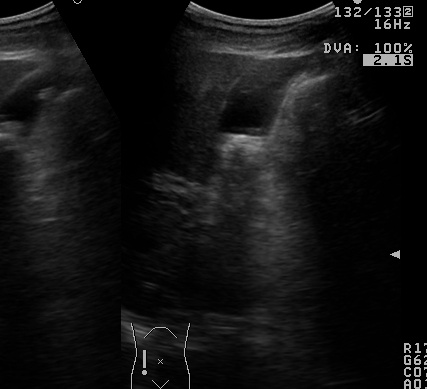

In [51]:
from IPython.display import Image
# os.chdir('/media/tohn/HDD/Dataset_USAI10K_Cropped')
resize = Image(path_news[1])
resize

In [21]:
# for i in path_low:
#     from IPython.display import Image
#     resize = Image(i)
#     print(resize)

In [25]:
path[12417]

'/media/tohn/HDD/Dataset_USAI10K/DBD/2014-03-14/012/00107-11110/images/USAI_d2014-03-14_u012_p00107-h11110_0.jpg'

In [15]:
from keras.preprocessing.image import load_img, img_to_array

for i in path_news:
    img = load_img(i, color_mode='grayscale')
    img = img_to_array(img)
    print(img.shape)

(431, 505, 1)
(429, 508, 1)
(428, 482, 1)
(422, 502, 1)
(430, 507, 1)
(433, 508, 1)
(438, 508, 1)
(429, 492, 1)
(426, 492, 1)
(434, 502, 1)
(431, 512, 1)
(425, 498, 1)
(431, 512, 1)
(428, 492, 1)
(422, 503, 1)
(421, 491, 1)
(431, 502, 1)
(430, 502, 1)
(429, 488, 1)
(428, 509, 1)
(437, 494, 1)
(423, 486, 1)
(427, 493, 1)
(428, 495, 1)
(428, 486, 1)
(423, 487, 1)
(426, 491, 1)
(436, 500, 1)
(431, 502, 1)
(428, 490, 1)
(420, 515, 1)
(420, 515, 1)
(429, 483, 1)
(426, 495, 1)
(424, 506, 1)
(421, 491, 1)
(436, 502, 1)
(427, 479, 1)
(424, 485, 1)
(423, 505, 1)
(427, 479, 1)
(429, 484, 1)
(428, 520, 1)
(425, 483, 1)
(422, 487, 1)
(426, 513, 1)
(424, 505, 1)
(426, 496, 1)
(430, 505, 1)
(426, 513, 1)
(425, 503, 1)
(433, 505, 1)
(426, 493, 1)
(435, 500, 1)
(430, 504, 1)
(431, 512, 1)
(424, 520, 1)
(425, 521, 1)
(428, 521, 1)
(425, 543, 1)
(433, 528, 1)
(428, 487, 1)
(426, 518, 1)
(429, 516, 1)
(426, 515, 1)
(416, 480, 1)
(427, 474, 1)
(425, 469, 1)
(428, 490, 1)
(422, 467, 1)
(433, 474, 1)
(435, 

FileNotFoundError: [Errno 2] No such file or directory: '/media/tohn/HDD/Dataset_USAI10K_Cropped/USAI_d2014-09-19_u012_p00803-h10671_6.jpg'

In [ ]:
(None, 576, 768)